# Filtering and splitting the locations dataset

In [1]:
import os
import gc

import duckdb
import pandas as pd
import numpy as np

import skmob
import h3
import geopandas as gpd

import folium
from folium import FeatureGroup, LayerControl
from folium.plugins import HeatMap

import seaborn as sns
import matplotlib.pyplot as plt

import plotly.express as px
import plotly.figure_factory as ff

import statsmodels.api as sm

os.environ["OMP_NUM_THREADS"] = "8" # Set up for avoiding warnings with GMM 

from IPython.display import display

In [2]:
# Importing a custom module in a different file
import sys
sys.path.append('C:\Camilo\Estudio\Padova\Master thesis\master-thesis-code')
import utils
import constants
import utils_models

In [3]:
import importlib
importlib.reload(utils_models)

<module 'utils_models' from 'C:\\Camilo\\Estudio\\Padova\\Master thesis\\master-thesis-code\\utils_models.py'>

Assigning the path to read the reduced files:   

In [4]:
path_read = r'..\..\Datasets'

Assigning the paths to write exploration plots:

In [5]:
path_interactive_plots = r'.\3-exploration-interactive-plots'

Assigning the path to write the filtered and split files:

In [6]:
path_locations_split_filtered = r'..\..\Datasets\Processed\wifi_traces_filtered_split'

Setting some configurations for plotting.

In [7]:
#random_seed=0

In [8]:
sns.set_theme('paper',style='dark', palette='tab10')

In [9]:
plt.rcParams.update({
    "axes.labelsize": 14,
    'legend.fontsize': 11,
    'axes.titlesize': 13,
    'xtick.labelsize': 12,
    'ytick.labelsize': 12
})

## Reading the locations data

Reading the multiple csv files into a duckDB relation. From prvious runs, I know that there are 25,000,000 records (250 files with 100,000 records each)

In [10]:
# Creating a duckDB connection for consistency in the configurations I need
duckdb_conn = duckdb.connect()

# Hiding the progress bar for queries
duckdb_conn.execute("PRAGMA disable_progress_bar;")

In [11]:
# Setting the connection timezone explicitly to avoid any confusions
duckdb_conn.execute("SET TimeZone='Europe/Madrid'")

In [12]:
locations = duckdb_conn.read_csv(os.path.join(path_read,r'Processed\wifi_traces_reduced\*.csv'))
locations

┌──────────────────────────────────────────────────────────────────┬────────────────────┬──────────────┬─────────────────┬────────────────────┬───────────────────┬──────────────────┬────────────────────────────┬─────────────────┬────────┬───────────────────┬─────────────────────────────┐
│                        anonymized_macaddr                        │ macaddr_randomized │ timestamp_ap │     h3_cell     │  client_latitude   │ client_longitude  │ timestamp_wizzie │       location_name        │      slug       │  rssi  │ confidence_factor │         vendor_name         │
│                             varchar                              │       int64        │    int64     │     varchar     │       double       │      double       │      int64       │          varchar           │     varchar     │ double │      double       │           varchar           │
├──────────────────────────────────────────────────────────────────┼────────────────────┼──────────────┼─────────────────┼───────────

In [13]:
print('Maximum and minimum timestamps (AP):')
duckdb_conn.sql("SELECT TO_TIMESTAMP(min(timestamp_ap)), TO_TIMESTAMP(max(timestamp_ap)) FROM locations")

Maximum and minimum timestamps (AP):


┌─────────────────────────────────┬─────────────────────────────────┐
│ to_timestamp(min(timestamp_ap)) │ to_timestamp(max(timestamp_ap)) │
│    timestamp with time zone     │    timestamp with time zone     │
├─────────────────────────────────┼─────────────────────────────────┤
│ 2024-06-12 13:32:15+02          │ 2024-06-17 10:24:47+02          │
└─────────────────────────────────┴─────────────────────────────────┘

In [14]:
duckdb_conn.sql("""SELECT COUNT(DISTINCT anonymized_macaddr) AS unique_macadress 
                  FROM locations""")

┌──────────────────┐
│ unique_macadress │
│      int64       │
├──────────────────┤
│            38652 │
└──────────────────┘

In [15]:
locations

┌──────────────────────────────────────────────────────────────────┬────────────────────┬──────────────┬─────────────────┬────────────────────┬───────────────────┬──────────────────┬────────────────────────────┬─────────────────┬────────┬───────────────────┬─────────────────────────────┐
│                        anonymized_macaddr                        │ macaddr_randomized │ timestamp_ap │     h3_cell     │  client_latitude   │ client_longitude  │ timestamp_wizzie │       location_name        │      slug       │  rssi  │ confidence_factor │         vendor_name         │
│                             varchar                              │       int64        │    int64     │     varchar     │       double       │      double       │      int64       │          varchar           │     varchar     │ double │      double       │           varchar           │
├──────────────────────────────────────────────────────────────────┼────────────────────┼──────────────┼─────────────────┼───────────

In [16]:
print('Unique macadresses:')
duckdb_conn.sql("""
                  SELECT macaddr_randomized, 
                        COUNT(DISTINCT anonymized_macaddr) AS unique_macadress_count,
                        COUNT(DISTINCT anonymized_macaddr) * 100.0 / (SUM(COUNT(DISTINCT anonymized_macaddr)) OVER ()) AS unique_macadress_percentage
                  FROM locations
                  GROUP BY macaddr_randomized""")

Unique macadresses:


┌────────────────────┬────────────────────────┬─────────────────────────────┐
│ macaddr_randomized │ unique_macadress_count │ unique_macadress_percentage │
│       int64        │         int64          │           double            │
├────────────────────┼────────────────────────┼─────────────────────────────┤
│                  0 │                  26425 │           68.36644934285418 │
│                  1 │                  12227 │          31.633550657145815 │
└────────────────────┴────────────────────────┴─────────────────────────────┘

## Temporary filter with the dates when the Sónar happened

For now, I will filter from one hour before the first event happens until one hour after the last show, just to make some computations faster.

- [Timetables (the updated ones are in the mobile app)](https://x.com/SonarFestival/status/1788915417815064885)
- [FAQ Sónar official page](https://sonar.es/es/informacion-practica/faqs)
- [Another link in case they change the official one](https://www.lavanguardia.com/cultura/20240612/9719556/sonar-barcelona-2024-cartel-horarios-conciertos-pmv.html#:~:text=En%20cuanto%20a%20los%20horarios,comenzando%20a%20las%2022%3A30h.)

In [17]:
# For efficienty and to avoid tweaking the original data too much, 
# I will work with epochs (as they are in the original files)
start_sonar_epoch = int(pd.Timestamp('2024-06-13 9:30:00', tz='Europe/Madrid').timestamp())
end_sonar_epoch = int(pd.Timestamp('2024-06-16 8:00:00', tz='Europe/Madrid').timestamp())

# Checking that the epoch is correctly converted back into its corresponding timestamp as a sanity check
start_sonar_timestamp = duckdb_conn.execute(f'SELECT TO_TIMESTAMP({start_sonar_epoch})').fetchone()[0]
end_sonar_timestamp = duckdb_conn.execute(f'SELECT TO_TIMESTAMP({end_sonar_epoch})').fetchone()[0]


print(f"Starting time of the Sónar: {start_sonar_timestamp}")
print(f"Ending time of the Sónar: {end_sonar_timestamp}")

Starting time of the Sónar: 2024-06-13 09:30:00+02:00
Ending time of the Sónar: 2024-06-16 08:00:00+02:00


In [18]:
# Query to filter the data based on the timestamp range (convert the Unix timestamp back into a proper datetime for comparison)
query = f"""
    SELECT * 
    FROM locations
    WHERE locations.timestamp_ap >= {start_sonar_epoch}
      AND locations.timestamp_ap <= {end_sonar_epoch}"""

# Execute the query and load the result into a DataFrame
locations = duckdb_conn.sql(query)

## Exploring the unsplit dataset

I compute some quick things to have a general idea of the dataset.

In [19]:
print('Maximum and minimum timestamps (AP) after first filter:')
duckdb_conn.sql("SELECT TO_TIMESTAMP(min(timestamp_ap)), TO_TIMESTAMP(max(timestamp_ap)) FROM locations")

Maximum and minimum timestamps (AP) after first filter:


┌─────────────────────────────────┬─────────────────────────────────┐
│ to_timestamp(min(timestamp_ap)) │ to_timestamp(max(timestamp_ap)) │
│    timestamp with time zone     │    timestamp with time zone     │
├─────────────────────────────────┼─────────────────────────────────┤
│ 2024-06-13 09:30:01+02          │ 2024-06-16 08:00:00+02          │
└─────────────────────────────────┴─────────────────────────────────┘

In [20]:
print('Number of records after first filter:')
duckdb_conn.sql('SELECT COUNT(*) AS total_records FROM locations')

Number of records after first filter:


┌───────────────┐
│ total_records │
│     int64     │
├───────────────┤
│      17741612 │
└───────────────┘

In [21]:
print('Unique macadresses after first filter:')
duckdb_conn.sql("""
                  SELECT macaddr_randomized, 
                        COUNT(DISTINCT anonymized_macaddr) AS unique_macadress_count,
                        COUNT(DISTINCT anonymized_macaddr) * 100.0 / (SUM(COUNT(DISTINCT anonymized_macaddr)) OVER ()) AS unique_macadress_percentage
                  FROM locations
                  GROUP BY macaddr_randomized""")

Unique macadresses after first filter:


┌────────────────────┬────────────────────────┬─────────────────────────────┐
│ macaddr_randomized │ unique_macadress_count │ unique_macadress_percentage │
│       int64        │         int64          │           double            │
├────────────────────┼────────────────────────┼─────────────────────────────┤
│                  0 │                  20449 │           65.41586692258477 │
│                  1 │                  10811 │          34.584133077415224 │
└────────────────────┴────────────────────────┴─────────────────────────────┘

Checking how many observations distribute across the RSSI range:

In [22]:
'''duckdb_conn.sql("""
                  SELECT
                    MIN(rssi) AS min__rssi,
                    PERCENTILE_CONT(0.05) WITHIN GROUP(ORDER BY rssi) AS p05_rssi,
                    PERCENTILE_CONT(0.10) WITHIN GROUP(ORDER BY rssi) AS p10_rssi,
                    PERCENTILE_CONT(0.25) WITHIN GROUP(ORDER BY rssi) AS p25_rssi,
                    PERCENTILE_CONT(0.50) WITHIN GROUP(ORDER BY rssi) AS median_rssi,
                    PERCENTILE_CONT(0.75) WITHIN GROUP(ORDER BY rssi) AS p75_rssi,
                    PERCENTILE_CONT(0.90) WITHIN GROUP(ORDER BY rssi) AS p90_rssi,
                    PERCENTILE_CONT(0.95) WITHIN GROUP(ORDER BY rssi) AS p95_rssi,
                  MAX(rssi) AS max__rssi
                  FROM locations""")'''

'duckdb_conn.sql("""\n                  SELECT\n                    MIN(rssi) AS min__rssi,\n                    PERCENTILE_CONT(0.05) WITHIN GROUP(ORDER BY rssi) AS p05_rssi,\n                    PERCENTILE_CONT(0.10) WITHIN GROUP(ORDER BY rssi) AS p10_rssi,\n                    PERCENTILE_CONT(0.25) WITHIN GROUP(ORDER BY rssi) AS p25_rssi,\n                    PERCENTILE_CONT(0.50) WITHIN GROUP(ORDER BY rssi) AS median_rssi,\n                    PERCENTILE_CONT(0.75) WITHIN GROUP(ORDER BY rssi) AS p75_rssi,\n                    PERCENTILE_CONT(0.90) WITHIN GROUP(ORDER BY rssi) AS p90_rssi,\n                    PERCENTILE_CONT(0.95) WITHIN GROUP(ORDER BY rssi) AS p95_rssi,\n                  MAX(rssi) AS max__rssi\n                  FROM locations""")'

I also check the `confidence_factor` column, but they told me that they don't know what it is.

In [23]:
'''duckdb_conn.sql("""
                  SELECT
                    MIN(confidence_factor) AS min_conf_f,
                    PERCENTILE_CONT(0.05) WITHIN GROUP(ORDER BY confidence_factor) AS p05_conf_f,
                    PERCENTILE_CONT(0.10) WITHIN GROUP(ORDER BY confidence_factor) AS p10_conf_f,
                    PERCENTILE_CONT(0.25) WITHIN GROUP(ORDER BY confidence_factor) AS p25_conf_f,
                    PERCENTILE_CONT(0.50) WITHIN GROUP(ORDER BY confidence_factor) AS median_conf_f,
                    PERCENTILE_CONT(0.75) WITHIN GROUP(ORDER BY confidence_factor) AS p75_conf_f,
                    PERCENTILE_CONT(0.90) WITHIN GROUP(ORDER BY confidence_factor) AS p90_conf_f,
                    PERCENTILE_CONT(0.95) WITHIN GROUP(ORDER BY confidence_factor) AS p95_conf_f,
                    MAX(confidence_factor) AS max_conf_f
                  FROM locations""")'''

'duckdb_conn.sql("""\n                  SELECT\n                    MIN(confidence_factor) AS min_conf_f,\n                    PERCENTILE_CONT(0.05) WITHIN GROUP(ORDER BY confidence_factor) AS p05_conf_f,\n                    PERCENTILE_CONT(0.10) WITHIN GROUP(ORDER BY confidence_factor) AS p10_conf_f,\n                    PERCENTILE_CONT(0.25) WITHIN GROUP(ORDER BY confidence_factor) AS p25_conf_f,\n                    PERCENTILE_CONT(0.50) WITHIN GROUP(ORDER BY confidence_factor) AS median_conf_f,\n                    PERCENTILE_CONT(0.75) WITHIN GROUP(ORDER BY confidence_factor) AS p75_conf_f,\n                    PERCENTILE_CONT(0.90) WITHIN GROUP(ORDER BY confidence_factor) AS p90_conf_f,\n                    PERCENTILE_CONT(0.95) WITHIN GROUP(ORDER BY confidence_factor) AS p95_conf_f,\n                    MAX(confidence_factor) AS max_conf_f\n                  FROM locations""")'

I assign a `rssi_category_adj` column, based on a [description](https://www.metageek.com/training/resources/understanding-rssi/) found online. Still, I think RSSI is the strength of the signal, so I do not know if it necessarily translates into precision confidence. I don't know if I should take it into account yet.

In [24]:
'''locations = duckdb_conn.query("""
                                    SELECT *,
                                      CASE 
                                        WHEN rssi < -90 THEN 'weakest'
                                        WHEN rssi >= -90 AND rssi < -80 THEN 'weak'
                                        WHEN rssi >= -80 AND rssi < -70 THEN 'normal'
                                        WHEN rssi >= -70 AND rssi < -67 THEN 'good'
                                        WHEN rssi >= -67 THEN 'excellent'  
                                      END AS rssi_category_adj
                                    FROM locations""")'''

'locations = duckdb_conn.query("""\n                                    SELECT *,\n                                      CASE \n                                        WHEN rssi < -90 THEN \'weakest\'\n                                        WHEN rssi >= -90 AND rssi < -80 THEN \'weak\'\n                                        WHEN rssi >= -80 AND rssi < -70 THEN \'normal\'\n                                        WHEN rssi >= -70 AND rssi < -67 THEN \'good\'\n                                        WHEN rssi >= -67 THEN \'excellent\'  \n                                      END AS rssi_category_adj\n                                    FROM locations""")'

In [25]:
'''print('Counts of observations by the (added) RSSI category :')
duckdb_conn.query("""
                  SELECT rssi_category_adj,
                         COUNT(*) AS rssi_category_count,
                         COUNT(*) * 100.0 / (SUM(COUNT(*)) OVER ()) AS rssi_category_percentage
                  FROM locations
                  GROUP BY rssi_category_adj
                  ORDER BY rssi_category_adj""")'''

'print(\'Counts of observations by the (added) RSSI category :\')\nduckdb_conn.query("""\n                  SELECT rssi_category_adj,\n                         COUNT(*) AS rssi_category_count,\n                         COUNT(*) * 100.0 / (SUM(COUNT(*)) OVER ()) AS rssi_category_percentage\n                  FROM locations\n                  GROUP BY rssi_category_adj\n                  ORDER BY rssi_category_adj""")'

## Splitting into Sónar by day and Sónar by night

#### Identifying cells by day and night

The idea is to identify which observations belong to Sónar by Day and Sónar by Night based on their geographical association. For this I read the files with the H3 cells corresponding to Sónar by Day and Sónar by Night.

These were obtained in the `1. preprocessing_fix_polygons_h3pandas.ipynb` script, based on the polygons' buffers.

In [26]:
h3_cells_day_lookup_shp = gpd.read_file(os.path.join(path_read, r'Processed\Zonas SONAR clipped\h3_cells_day_lookup.json'))
h3_cells_night_lookup_shp = gpd.read_file(os.path.join(path_read, r'Processed\Zonas SONAR clipped\h3_cells_night_lookup.json'))

h3_cells_day_lookup = h3_cells_day_lookup_shp[['h3_cell', 'sonar_type']]
h3_cells_night_lookup = h3_cells_night_lookup_shp[['h3_cell', 'sonar_type']]

In [27]:
# Also reading the files with the polygons and the buffers for visualization

day_polygons_clipped = gpd.read_file(os.path.join(path_read,r'Processed\Zonas SONAR clipped\sonar_day_polygons_clipped.json'))
night_polygons_clipped = gpd.read_file(os.path.join(path_read,r'Processed\Zonas SONAR clipped\sonar_night_polygons_clipped.json'))

buffer_day = gpd.read_file(os.path.join(path_read,r'Processed\Zonas SONAR clipped\buffer_day.json'))
buffer_night = gpd.read_file(os.path.join(path_read,r'Processed\Zonas SONAR clipped\buffer_night.json'))

In [28]:
# Concatenating the cells into a single dataframe for convenience
h3_cells_day_night_lookup = pd.concat([h3_cells_day_lookup, h3_cells_night_lookup])

del h3_cells_day_lookup, h3_cells_night_lookup

h3_cells_day_night_lookup

,h3_cell,sonar_type
0,8d394461ca5ecbf,sonar_day
1,8d394461cb5bc7f,sonar_day
2,8d394461ca0b77f,sonar_day
3,8d394461caec7bf,sonar_day
4,8d394461ca72bbf,sonar_day
...,...,...
3671,8d394461e82ea3f,sonar_night
3672,8d394461e94d13f,sonar_night
3673,8d394461e96b6ff,sonar_night
3674,8d394461e84e97f,sonar_night


With the buffer surrounding the Sónar polygons I can also filter observations that fall far away from the Firas. I check that to be sure.

Examining which cells (from the observations) would be excluded from the dataset.

In [29]:
not_joined_cells = duckdb_conn.sql("""
                                   SELECT DISTINCT lc.h3_cell
                                   FROM locations lc
                                     LEFT JOIN h3_cells_day_night_lookup cells
                                         ON lc.h3_cell = cells.h3_cell
                                   WHERE sonar_type IS NULL""").to_df()

In [30]:
# Function to convert the list of H3 cell codes into points (the cell centroids)
def h3cells_to_points(h3_cell_ids):
    lat_lng_array = np.array([h3.cell_to_latlng(cell) for cell in h3_cell_ids])
    lngs, lats = lat_lng_array[:, 1], lat_lng_array[:, 0]
    return gpd.points_from_xy(lngs, lats)

In [31]:
# Converting the H3 cell codes into points
not_joined_cells['geometry'] = h3cells_to_points(not_joined_cells['h3_cell'])
not_joined_cells = gpd.GeoDataFrame(not_joined_cells, geometry='geometry', crs="EPSG:4326")

Top right is Sónar by Day and bottom left is Sónar by Night.
Not joined points are shown in black.


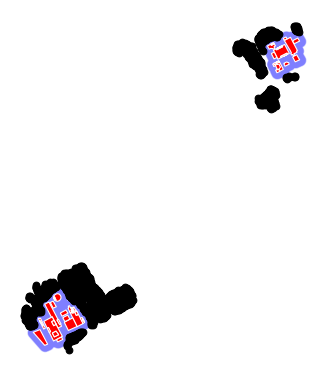

In [32]:
# Plotting the buffer below the polygons
print('Top right is Sónar by Day and bottom left is Sónar by Night.')
print('Not joined points are shown in black.')
fig, ax = plt.subplots(figsize=(4, 10))

buffer_day.plot(ax=ax, color='blue', alpha=0.5)
day_polygons_clipped.plot(ax=ax, color='red')

buffer_night.plot(ax=ax, color='blue', alpha=0.5)
night_polygons_clipped.plot(ax=ax, color='red')


not_joined_cells.plot(ax=ax, color='black')
ax.axis('off')

plt.show()

In [33]:
# Writing the not joined points for visualization in Qgis
#not_joined_cells.to_file(os.path.join(path_read,r'Processed\Zonas SONAR clipped\not_joined_cells.json'), driver='GeoJSON')  

In [34]:
del not_joined_cells, 
del buffer_day#, day_polygons_clipped
del buffer_night#, night_polygons_clipped

### Splitting geographically

In [35]:
locations = duckdb_conn.sql("""
                            SELECT lc.*, cells.sonar_type
                            FROM locations lc
                                INNER JOIN h3_cells_day_night_lookup cells
                                    ON lc.h3_cell = cells.h3_cell""")

In [36]:
print('Number of records after filtering for the observations away from the Firas:')
duckdb_conn.sql("""
                SELECT macaddr_randomized, COUNT(*) AS total_records
                FROM locations
                GROUP BY macaddr_randomized

                UNION ALL

                SELECT 'Total' AS macaddr_randomized, COUNT(*) AS total_records
                FROM locations
                """)

Number of records after filtering for the observations away from the Firas:


┌────────────────────┬───────────────┐
│ macaddr_randomized │ total_records │
│      varchar       │     int64     │
├────────────────────┼───────────────┤
│ 0                  │       3721165 │
│ 1                  │       8720835 │
│ Total              │      12442000 │
└────────────────────┴───────────────┘

In [37]:
print('Unique macadresses after filtering for the observations away from the Firas')
duckdb_conn.sql("""
                SELECT macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                FROM locations
                GROUP BY macaddr_randomized

                UNION ALL

                SELECT 'Total' AS macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                FROM locations
                """)

Unique macadresses after filtering for the observations away from the Firas


┌────────────────────┬───────────────────┐
│ macaddr_randomized │ unique_user_count │
│      varchar       │       int64       │
├────────────────────┼───────────────────┤
│ 0                  │              9820 │
│ 1                  │              6249 │
│ Total              │             16069 │
└────────────────────┴───────────────────┘

Performing the (geographical) split between Sónar by day and Sónar by night.

In [38]:
# Getting the day split
locations_day = duckdb_conn.sql("""
                                SELECT *
                                FROM locations
                                WHERE sonar_type = 'sonar_day'""")


# Getting the night split

locations_night = duckdb_conn.sql("""
                                    SELECT *
                                    FROM locations
                                    WHERE sonar_type = 'sonar_night'""")

## Filtering with the event timetables + quick exploration

TODO: Revisar horas

Splitting by day and night will leave Wi-Fi connections within the Sónar locations, but at times that do not correspond to when the Sónar was actually happening. For this reason, both Sónar by Day and Sónar by night are filtered with the times when the events happened (for each day).

Some information about the time of events is found here:

- [Timetables (the updated ones are in the mobile app)](https://x.com/SonarFestival/status/1788915417815064885)
- [FAQ Sónar official page](https://sonar.es/es/informacion-practica/faqs)
- [Another link in case they change the official one](https://www.lavanguardia.com/cultura/20240612/9719556/sonar-barcelona-2024-cartel-horarios-conciertos-pmv.html#:~:text=En%20cuanto%20a%20los%20horarios,comenzando%20a%20las%2022%3A30h.)


I will filter from 1 hour before the first event up to 1 hour after the last show (Sónar by day finished at 00hs the first day and at 23hs the next two days). The timestamps are importet from the `constants.py` file for organization reasons.

### Time filter for Sónar by day

In [39]:
# Filter for day 1 (in epoch)
# Sónar Ágora started at 10:30 and Sónar Village ended at 00:00
start_day_1_epoch = int(pd.Timestamp(constants.START_DAY_1_STRING, tz='Europe/Madrid').timestamp())
end_day_1_epoch = int(pd.Timestamp(constants.END_DAY_1_STRING, tz='Europe/Madrid').timestamp())

# Checking that the epoch is correctly converted back into its corresponding timestamp as a sanity check
start_day_1_timestamp = duckdb_conn.execute(f'SELECT TO_TIMESTAMP({start_day_1_epoch})').fetchone()[0]
end_day_1_timestamp = duckdb_conn.execute(f'SELECT TO_TIMESTAMP({end_day_1_epoch})').fetchone()[0]

print(f"Starting time of the Sónar by day 1: {start_day_1_timestamp}")
print(f"Ending time of the Sónar by day 1: {end_day_1_timestamp}\n")


# Filter for day 2 (in epoch)
# Sónar Ágora started at 10:30 and Sónar Village ended at 23:00
start_day_2_epoch = int(pd.Timestamp(constants.START_DAY_2_STRING, tz='Europe/Madrid').timestamp())
end_day_2_epoch = int(pd.Timestamp(constants.END_DAY_2_STRING, tz='Europe/Madrid').timestamp())

# Checking that the epoch is correctly converted back into its corresponding timestamp as a sanity check
start_day_2_timestamp = duckdb_conn.execute(f'SELECT TO_TIMESTAMP({start_day_2_epoch})').fetchone()[0]
end_day_2_timestamp = duckdb_conn.execute(f'SELECT TO_TIMESTAMP({end_day_2_epoch})').fetchone()[0]

print(f"Starting time of the Sónar by day 2: {start_day_2_timestamp}")
print(f"Ending time of the Sónar by day 2: {end_day_2_timestamp}\n")


# Filter for day 3 (in epoch)
# Sónar Ágora started at 11:00 and Sónar Village ended at 23:00
start_day_3_epoch = int(pd.Timestamp(constants.START_DAY_3_STRING, tz='Europe/Madrid').timestamp())
end_day_3_epoch = int(pd.Timestamp(constants.END_DAY_3_STRING, tz='Europe/Madrid').timestamp())

# Checking that the epoch is correctly converted back into its corresponding timestamp as a sanity check
start_day_3_timestamp = duckdb_conn.execute(f'SELECT TO_TIMESTAMP({start_day_3_epoch})').fetchone()[0]
end_day_3_timestamp = duckdb_conn.execute(f'SELECT TO_TIMESTAMP({end_day_3_epoch})').fetchone()[0]

print(f"Starting time of the Sónar by day 3: {start_day_3_timestamp}")
print(f"Ending time of the Sónar by day 3: {end_day_3_timestamp}")

Starting time of the Sónar by day 1: 2024-06-13 09:30:00+02:00
Ending time of the Sónar by day 1: 2024-06-14 01:00:00+02:00

Starting time of the Sónar by day 2: 2024-06-14 09:30:00+02:00
Ending time of the Sónar by day 2: 2024-06-15 00:00:00+02:00

Starting time of the Sónar by day 3: 2024-06-15 10:00:00+02:00
Ending time of the Sónar by day 3: 2024-06-16 00:00:00+02:00


In [40]:
locations_day = duckdb_conn.sql(f"""
                                    SELECT * 
                                    FROM locations_day
                                    WHERE (timestamp_ap >= {start_day_1_epoch}
                                            AND timestamp_ap  <= {end_day_1_epoch})
                                        OR (timestamp_ap >= {start_day_2_epoch}
                                            AND timestamp_ap  <= {end_day_2_epoch})
                                        OR (timestamp_ap >= {start_day_3_epoch}
                                            AND timestamp_ap  <= {end_day_3_epoch})""")

I also create a label that identifies day 1, 2 and 3 of the festival, based on their timestamps.

In [41]:
query_label_day = f"""
    SELECT *,
        CASE
            WHEN timestamp_ap >= {start_day_1_epoch} AND timestamp_ap <= {end_day_1_epoch} THEN 1
            WHEN timestamp_ap >= {start_day_2_epoch} AND timestamp_ap <= {end_day_2_epoch} THEN 2
            WHEN timestamp_ap >= {start_day_3_epoch} AND timestamp_ap <= {end_day_3_epoch} THEN 3
            ELSE NULL
        END AS label_day
    FROM locations_day
"""

locations_day = duckdb_conn.sql(query_label_day)

### Time filter for Sónar by night

In [42]:
# Filter for night 1 (in epoch)
start_night_1_epoch = int(pd.Timestamp(constants.START_NIGHT_1_STRING, tz='Europe/Madrid').timestamp())
end_night_1_epoch = int(pd.Timestamp(constants.END_NIGHT_1_STRING, tz='Europe/Madrid').timestamp())

# Checking that the epoch is correctly converted back into its corresponding timestamp as a sanity check
start_night_1_timestamp = duckdb_conn.execute(f'SELECT TO_TIMESTAMP({start_night_1_epoch})').fetchone()[0]
end_night_1_timestamp = duckdb_conn.execute(f'SELECT TO_TIMESTAMP({end_night_1_epoch})').fetchone()[0]

print(f"Starting time of the Sónar by night 1: {start_night_1_timestamp}")
print(f"Ending time of the Sónar by night 1: {end_night_1_timestamp}\n")


# Filter for night 2 (in epoch)
start_night_2_epoch = int(pd.Timestamp(constants.START_NIGHT_2_STRING, tz='Europe/Madrid').timestamp())
end_night_2_epoch = int(pd.Timestamp(constants.END_NIGHT_2_STRING, tz='Europe/Madrid').timestamp())

# Checking that the epoch is correctly converted back into its corresponding timestamp as a sanity check
start_night_2_timestamp = duckdb_conn.execute(f'SELECT TO_TIMESTAMP({start_night_2_epoch})').fetchone()[0]
end_night_2_timestamp = duckdb_conn.execute(f'SELECT TO_TIMESTAMP({end_night_2_epoch})').fetchone()[0]

print(f"Starting time of the Sónar by night 2: {start_night_2_timestamp}")
print(f"Ending time of the Sónar by night 2: {end_night_2_timestamp}\n")

Starting time of the Sónar by night 1: 2024-06-14 19:50:00+02:00
Ending time of the Sónar by night 1: 2024-06-15 08:00:00+02:00

Starting time of the Sónar by night 2: 2024-06-15 19:50:00+02:00
Ending time of the Sónar by night 2: 2024-06-16 08:00:00+02:00



In [43]:
locations_night = duckdb_conn.sql(f"""
                                    SELECT *
                                    FROM locations_night
                                    WHERE (timestamp_ap >= {start_night_1_epoch}
                                        AND timestamp_ap  <= {end_night_1_epoch})
                                    OR (timestamp_ap >= {start_night_2_epoch}
                                        AND timestamp_ap  <= {end_night_2_epoch})""")

Creating the label to identify night 1 and 2 based on the timestamps. Also, I order the tables for easier visualization.

In [44]:
query_label_night = f"""
    SELECT *,
        CASE
            WHEN timestamp_ap >= {start_night_1_epoch} AND timestamp_ap <= {end_night_1_epoch} THEN 1
            WHEN timestamp_ap >= {start_night_2_epoch} AND timestamp_ap <= {end_night_2_epoch} THEN 2
            ELSE NULL
        END AS label_night
    FROM locations_night
"""

locations_night = duckdb_conn.sql(query_label_night)

### Total count after linking to the Sónar

Checking the total count after filtering for the observations that do correspond with the times of the Sónar.

In [45]:
locations_union_day_night = duckdb_conn.sql('''SELECT * FROM locations_day
                                  UNION ALL FROM locations_night''')

In [46]:
print('Number of records corresponding to the times of the Sónar:')
duckdb_conn.sql("""
                SELECT macaddr_randomized, sonar_type, COUNT(*) AS total_records
                FROM locations_union_day_night
                GROUP BY macaddr_randomized, sonar_type

                UNION ALL

                SELECT 'Total' AS macaddr_randomized, 'Total' AS sonar_type, COUNT(*) AS total_records
                FROM locations_union_day_night

                ORDER BY sonar_type DESC, macaddr_randomized
                """)

Number of records corresponding to the times of the Sónar:


┌────────────────────┬─────────────┬───────────────┐
│ macaddr_randomized │ sonar_type  │ total_records │
│      varchar       │   varchar   │     int64     │
├────────────────────┼─────────────┼───────────────┤
│ 0                  │ sonar_night │        680833 │
│ 1                  │ sonar_night │       2678991 │
│ 0                  │ sonar_day   │       1713507 │
│ 1                  │ sonar_day   │       5565037 │
│ Total              │ Total       │      10638368 │
└────────────────────┴─────────────┴───────────────┘

In [47]:
print('Unique macadresses corresponding to the times of the Sónar:')
duckdb_conn.sql("""
                SELECT macaddr_randomized, sonar_type, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                FROM locations_union_day_night
                GROUP BY macaddr_randomized, sonar_type

                UNION ALL

                SELECT 'Total' AS macaddr_randomized, 'Total' AS sonar_type, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                FROM locations_union_day_night

                ORDER BY sonar_type DESC, macaddr_randomized
                """)

Unique macadresses corresponding to the times of the Sónar:


┌────────────────────┬─────────────┬───────────────────┐
│ macaddr_randomized │ sonar_type  │ unique_user_count │
│      varchar       │   varchar   │       int64       │
├────────────────────┼─────────────┼───────────────────┤
│ 0                  │ sonar_night │              2615 │
│ 1                  │ sonar_night │              3346 │
│ 0                  │ sonar_day   │              6211 │
│ 1                  │ sonar_day   │              3478 │
│ Total              │ Total       │             14051 │
└────────────────────┴─────────────┴───────────────────┘

In [48]:
'''duckdb_conn.sql("""
                  SELECT sonar_type,
                    MIN(confidence_factor) AS min_conf_f,
                    PERCENTILE_CONT(0.05) WITHIN GROUP(ORDER BY confidence_factor) AS p05_conf_f,
                    PERCENTILE_CONT(0.10) WITHIN GROUP(ORDER BY confidence_factor) AS p10_conf_f,
                    PERCENTILE_CONT(0.25) WITHIN GROUP(ORDER BY confidence_factor) AS p25_conf_f,
                    PERCENTILE_CONT(0.50) WITHIN GROUP(ORDER BY confidence_factor) AS median_conf_f,
                    PERCENTILE_CONT(0.75) WITHIN GROUP(ORDER BY confidence_factor) AS p75_conf_f,
                    PERCENTILE_CONT(0.90) WITHIN GROUP(ORDER BY confidence_factor) AS p90_conf_f,
                    PERCENTILE_CONT(0.95) WITHIN GROUP(ORDER BY confidence_factor) AS p95_conf_f,
                    MAX(confidence_factor) AS max_conf_f
                  FROM locations
                  GROUP BY sonar_type""")'''

'duckdb_conn.sql("""\n                  SELECT sonar_type,\n                    MIN(confidence_factor) AS min_conf_f,\n                    PERCENTILE_CONT(0.05) WITHIN GROUP(ORDER BY confidence_factor) AS p05_conf_f,\n                    PERCENTILE_CONT(0.10) WITHIN GROUP(ORDER BY confidence_factor) AS p10_conf_f,\n                    PERCENTILE_CONT(0.25) WITHIN GROUP(ORDER BY confidence_factor) AS p25_conf_f,\n                    PERCENTILE_CONT(0.50) WITHIN GROUP(ORDER BY confidence_factor) AS median_conf_f,\n                    PERCENTILE_CONT(0.75) WITHIN GROUP(ORDER BY confidence_factor) AS p75_conf_f,\n                    PERCENTILE_CONT(0.90) WITHIN GROUP(ORDER BY confidence_factor) AS p90_conf_f,\n                    PERCENTILE_CONT(0.95) WITHIN GROUP(ORDER BY confidence_factor) AS p95_conf_f,\n                    MAX(confidence_factor) AS max_conf_f\n                  FROM locations\n                  GROUP BY sonar_type""")'

In [49]:
'''duckdb_conn.sql("""
                  SELECT sonar_type,
                    AVG(confidence_factor) AS avg_conf_f
                  FROM locations
                  GROUP BY sonar_type""")'''

'duckdb_conn.sql("""\n                  SELECT sonar_type,\n                    AVG(confidence_factor) AS avg_conf_f\n                  FROM locations\n                  GROUP BY sonar_type""")'

## Comparing the Wi-Fi observations with the people counts

Reading the Excel files for people count.

In [50]:
people_count_day = pd.read_excel(os.path.join(path_read,r'Input\Aforos Cámaras Sónar 2024.xlsx'),
                             sheet_name='sonar_day')
people_count_night = pd.read_excel(os.path.join(path_read,r'Input\Aforos Cámaras Sónar 2024.xlsx'),
                             sheet_name='sonar_night')

Comparing unique MAC adresses and observations versus the actual people counts provided by the Sónar. First, I prepare the data for both Sónar by Day and Sónar by Night.

In [51]:
# Getting the observations and users count for each hour from the locations data,
# to compare it with the actual people counts from the Sónar

# Day

observations_hour_day = duckdb_conn.sql("""SELECT label_day, 
                                                EXTRACT(HOUR FROM TO_TIMESTAMP(timestamp_ap)) AS Hour,
                                                macaddr_randomized,
                                                COUNT(*) AS observations
                                            FROM locations_day
                                            GROUP BY label_day, Hour, macaddr_randomized
                                            ORDER BY label_day, Hour, macaddr_randomized""").to_df()

users_hour_day = duckdb_conn.sql("""
                                   SELECT label_day, 
                                        EXTRACT(HOUR FROM TO_TIMESTAMP(timestamp_ap)) AS Hour,
                                        macaddr_randomized,
                                        COUNT(DISTINCT anonymized_macaddr) AS unique_macaddresses
                                    FROM locations_day
                                    GROUP BY label_day, Hour, macaddr_randomized
                                    ORDER BY label_day, Hour, macaddr_randomized""").to_df()

In [52]:
# Night

observations_hour_night = duckdb_conn.sql("""SELECT label_night, 
                                                EXTRACT(HOUR FROM TO_TIMESTAMP(timestamp_ap)) AS Hour,
                                                macaddr_randomized,
                                                COUNT(*) AS observations
                                            FROM locations_night
                                            GROUP BY label_night, Hour, macaddr_randomized
                                            ORDER BY label_night, Hour, macaddr_randomized""").to_df()

users_hour_night = duckdb_conn.sql("""
                                   SELECT label_night, 
                                        EXTRACT(HOUR FROM TO_TIMESTAMP(timestamp_ap)) AS Hour,
                                        macaddr_randomized,
                                        COUNT(DISTINCT anonymized_macaddr) AS unique_macaddresses
                                    FROM locations_night
                                    GROUP BY label_night, Hour, macaddr_randomized
                                    ORDER BY label_night, Hour, macaddr_randomized""").to_df()

In [53]:
# Modifying the df resulting from the locations for plotting

# Day
observations_hour_day['Day'] = observations_hour_day['label_day'].replace({1:'Thursday',2:'Friday',3:'Saturday'})
users_hour_day['Day'] = users_hour_day['label_day'].replace({1:'Thursday',2:'Friday',3:'Saturday'})

# Night
observations_hour_night['Night'] = observations_hour_night['label_night'].replace({1:'Friday',2:'Saturday'})
users_hour_night['Night'] = users_hour_night['label_night'].replace({1:'Friday',2:'Saturday'})

In [54]:
people_count_night

,From,To,Viernes,Sábado
0,20:00:00,21:00:00,636,1056
1,21:00:00,22:00:00,5740,8371
2,22:00:00,23:00:00,13395,20779
3,23:00:00,00:00:00,20460,28381
4,0:00:00,01:00:00,24918,32576
5,01:00:00,2:00:00,26276,34056
6,02:00:00,03:00:00,25943,33766
7,03:00:00,04:00:00,23882,32093
8,04:00:00,05:00:00,20306,29049
9,05:00:00,06:00:00,14281,24216


In [55]:
# Modifying the people counts df for plotting

# Day
people_count_day.rename(columns={'Jueves':'Thursday','Viernes':'Friday','Sábado':'Saturday'}, inplace=True)
people_count_day = people_count_day.melt(id_vars=["From", "To"], var_name="Day", value_name="People count")
people_count_day['Hour'] = people_count_day['From'].astype(str).str[:2].astype(int)

# Night
people_count_night.rename(columns={'Viernes':'Friday','Sábado':'Saturday'}, inplace=True)
people_count_night = people_count_night.melt(id_vars=["From", "To"], var_name="Night", value_name="People count")
people_count_night['Hour'] = people_count_night['From'].astype(str).str[:2].astype(int)

In [56]:
# Definition of the function to plot
def plot_comparison_counts(day_night, variable_to_plot, raw_filtered='raw'):

    # Selecting the variables
    if day_night == 'Day':
        if variable_to_plot == 'unique_macaddresses':
            label = 'Unique MAC addresses'
            people_df = people_count_day
            if raw_filtered=='raw':
                df_wifi = users_hour_day
            elif raw_filtered=='filtered':
                df_wifi = users_hour_day_filtered
        elif variable_to_plot == 'observations':
            label = 'Wi-Fi observations'
            people_df = people_count_day
            if raw_filtered=='raw':
                df_wifi = observations_hour_day
            elif raw_filtered=='filtered':
                df_wifi = observations_hour_day_filtered
        
        # Organizing the day names for plotting
        day_order = ['Thursday','Friday','Saturday']
        people_df[day_night] = pd.Categorical(people_df[day_night], categories=day_order, ordered=True)
        df_wifi[day_night] = pd.Categorical(df_wifi[day_night], categories=day_order, ordered=True)

        # Converting Hour column to a categorical type (for plotting in the correct order)
        hour_order = ['9','10','11','12','13','14','15','16','17','18','19','20','21','22','23','0','1']
        people_df['Hour'] = pd.Categorical(people_df['Hour'].astype(str), categories=hour_order, ordered=True)
        df_wifi['Hour'] = pd.Categorical(df_wifi['Hour'].astype(str), categories=hour_order, ordered=True)

        # Setting a parameter for plotting
        location_legend = 'upper left'


    elif day_night == 'Night':
        # Selecting the variables
        if variable_to_plot == 'unique_macaddresses':
            label = 'Unique MAC addresses'
            people_df = people_count_night
            if raw_filtered=='raw':
                df_wifi = users_hour_night
            elif raw_filtered=='filtered':
                df_wifi = users_hour_night_filtered
        elif variable_to_plot == 'observations':
            label = 'Wi-Fi observations'
            people_df = people_count_night
            if raw_filtered=='raw':
                df_wifi = observations_hour_night
            elif raw_filtered=='filtered':
                df_wifi = observations_hour_night_filtered

        # Organizing the day names for plotting
        day_order = ['Friday','Saturday']
        people_df[day_night] = pd.Categorical(people_df[day_night], categories=day_order, ordered=True)
        df_wifi[day_night] = pd.Categorical(df_wifi[day_night], categories=day_order, ordered=True)

        # Converting Hour column to a categorical type (for plotting in the correct order)
        hour_order = ['20','21','22','23','0','1','2','3','4','5','6','7']
        people_df['Hour'] = pd.Categorical(people_df['Hour'].astype(str), categories=hour_order, ordered=True)
        df_wifi['Hour'] = pd.Categorical(df_wifi['Hour'].astype(str), categories=hour_order, ordered=True)

        # Setting a parameter for plotting
        location_legend = 'upper right'


    #--------------------------------------------------------------------
    # Pivot the data for stacked bar plotting
    stacked_data = df_wifi.pivot_table(
        index=[day_night, 'Hour'],
        columns='macaddr_randomized',
        values=variable_to_plot,
        aggfunc='sum',
        observed=False).reset_index().sort_values(by=[day_night,'Hour'])

    stacked_data.columns = [day_night, 'Hour'] + [f'macaddr_randomized: {col}' for col in stacked_data.columns[2:]]

    # Get the unique days for subplots
    days = stacked_data[day_night].unique()

    # Plotting
    fig, axes = plt.subplots(nrows=len(days), ncols=1, figsize=(10, 2.5 * len(days)))


    for i, day in enumerate(days):
        # Filter data for the specific day
        people_data = people_df[people_df[day_night] == day]
        wifi_data = stacked_data[stacked_data[day_night] == day].sort_values(by='Hour')


        # Drawing the variable of interest in the first axis
        ax = axes[i]

        wifi_data = wifi_data.drop(columns=[day_night])
        bottom = np.zeros(len(wifi_data))
        colors = ['Blue','Red']
        
        ax.grid(True, axis='y', linestyle='--', linewidth=0.5, zorder=0)
        for j, type_macadress in enumerate(wifi_data.columns[1:3]):
            ax.bar(
                wifi_data['Hour'], 
                wifi_data[type_macadress], 
                bottom=bottom, 
                width=0.6, 
                label=type_macadress, 
                alpha=0.8,
                color=colors[j],
                zorder=j+2)
            bottom += wifi_data[type_macadress]

        ax.set_ylabel(label)
        ax.set_xlabel("Hour")
        ax.set_title(f"{label} vs people counts - {day} (Sónar by {day_night}) - {raw_filtered}")
        
        
        # Creating the line plot
        ax_twin = ax.twinx()

        # Set up the axes 
        ax_twin.plot(people_data['Hour'], people_data['People count'], 
                    label="People counts", marker='.', color='darkgoldenrod', zorder=4)
        
        ax_twin.set_xlabel("Hour")
        ax_twin.set_xticks(wifi_data['Hour'])
        ax_twin.set_ylabel("People count", color='darkgoldenrod')
        ax_twin.tick_params(axis='y', labelcolor='darkgoldenrod')
        lines, labels = ax.get_legend_handles_labels()
        lines2, labels2 = ax_twin.get_legend_handles_labels()
        if i == 0:
            ax.legend(lines + lines2, ['MAC\nrandomized:0','MAC\nrandomized:1'], 
                    loc=location_legend)
    plt.tight_layout()
    plt.show()

#### Sónar by day - counts by hour

Plotting each variable against the actual people counts.

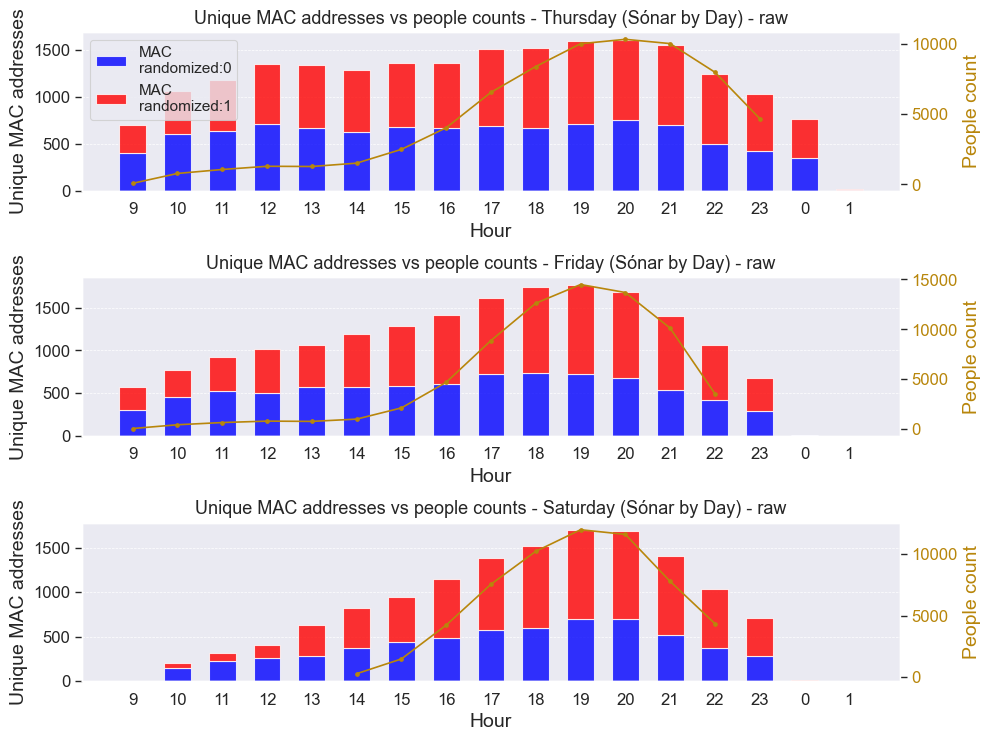

In [57]:
plot_comparison_counts(day_night='Day', variable_to_plot='unique_macaddresses')

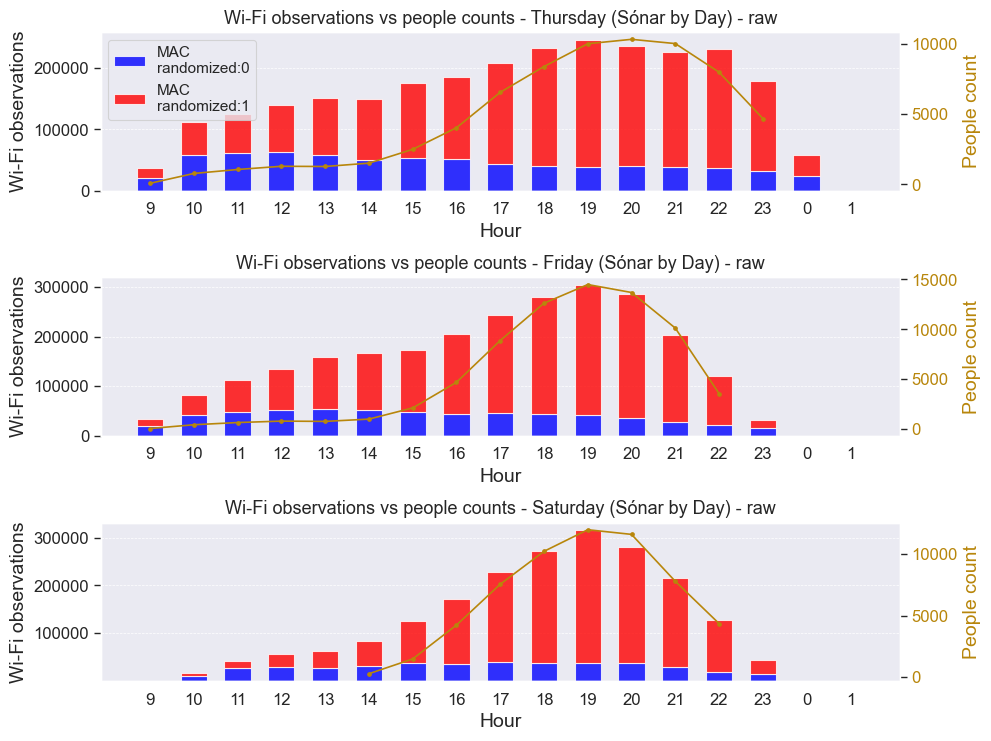

In [58]:
plot_comparison_counts(day_night='Day', variable_to_plot='observations')

In [59]:
del observations_hour_day, users_hour_day

#### Sónar by night - counts by hour

Comparing unique MAC adresses and observations versus the actual people counts provided by the Sónar.

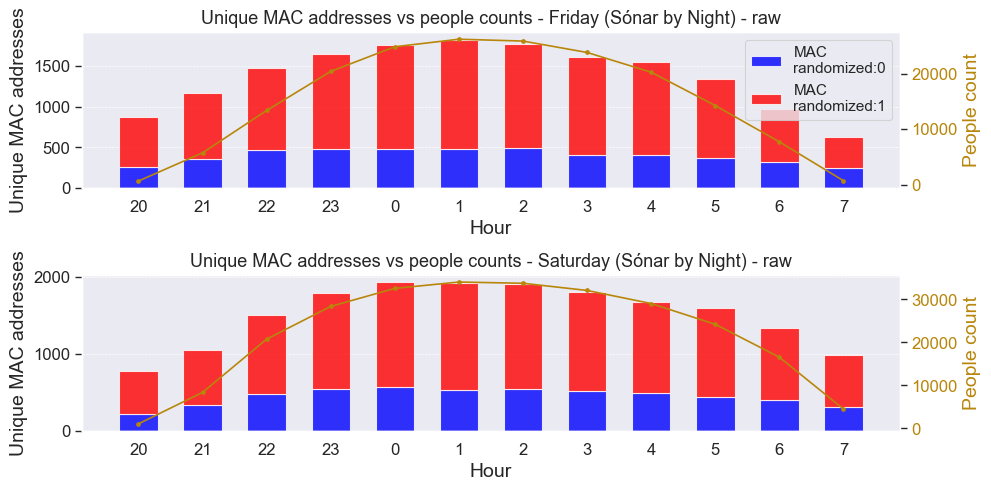

In [60]:
plot_comparison_counts(day_night='Night', variable_to_plot='unique_macaddresses')

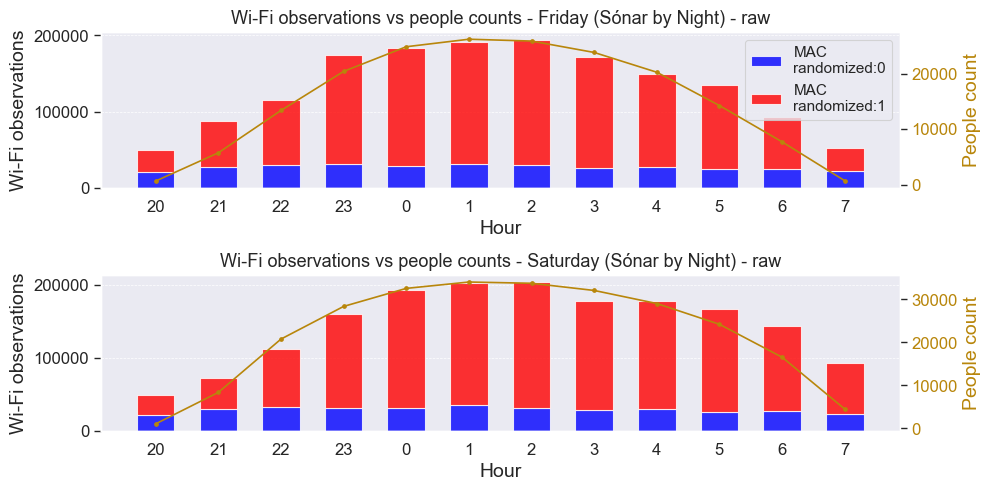

In [61]:
plot_comparison_counts(day_night='Night', variable_to_plot='observations')

In [62]:
del observations_hour_night, users_hour_night

## Exploring Sónar by night

In [63]:
print('Maximum and minimum timestamps (AP) for Sónar by night:')
duckdb_conn.sql("SELECT label_night, TO_TIMESTAMP(min(timestamp_ap)), TO_TIMESTAMP(max(timestamp_ap)) FROM locations_night GROUP BY label_night")

Maximum and minimum timestamps (AP) for Sónar by night:


┌─────────────┬─────────────────────────────────┬─────────────────────────────────┐
│ label_night │ to_timestamp(min(timestamp_ap)) │ to_timestamp(max(timestamp_ap)) │
│    int32    │    timestamp with time zone     │    timestamp with time zone     │
├─────────────┼─────────────────────────────────┼─────────────────────────────────┤
│           1 │ 2024-06-14 19:50:00+02          │ 2024-06-15 08:00:00+02          │
│           2 │ 2024-06-15 19:50:00+02          │ 2024-06-16 08:00:00+02          │
└─────────────┴─────────────────────────────────┴─────────────────────────────────┘

In [64]:
print('Number of records Sónar by night (just after splitting):')
duckdb_conn.sql("""
                SELECT macaddr_randomized, COUNT(*) AS total_records
                FROM locations_night
                GROUP BY macaddr_randomized

                UNION ALL

                SELECT 'Total' AS macaddr_randomized, COUNT(*) AS total_records
                FROM locations_night
                """)

Number of records Sónar by night (just after splitting):


┌────────────────────┬───────────────┐
│ macaddr_randomized │ total_records │
│      varchar       │     int64     │
├────────────────────┼───────────────┤
│ 0                  │        680833 │
│ 1                  │       2678991 │
│ Total              │       3359824 │
└────────────────────┴───────────────┘

In [65]:
print('Unique macadresses Sónar by day (just after splitting):')
duckdb_conn.sql("""
                SELECT macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                FROM locations_night
                GROUP BY macaddr_randomized

                UNION ALL

                SELECT 'Total' AS macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                FROM locations_night
                """)

Unique macadresses Sónar by day (just after splitting):


┌────────────────────┬───────────────────┐
│ macaddr_randomized │ unique_user_count │
│      varchar       │       int64       │
├────────────────────┼───────────────────┤
│ 1                  │              3346 │
│ 0                  │              2615 │
│ Total              │              5961 │
└────────────────────┴───────────────────┘

### Removing unrelated Fira locations

The `location_name` column contains no NULLs. By visually inspecting where the points fall geographically for each location, I can idendify the zones and filter points that are not related to the Sónar. I sample some points from each category and add them to the map corresponding festival (Sónar by Day and Sónar by Night).

In [66]:
print("There are no NULLs in locations_union_day_night:")
duckdb_conn.sql("""SELECT COUNT(*) FROM locations_union_day_night WHERE location_name IS NULL""")

There are no NULLs in locations_union_day_night:


┌──────────────┐
│ count_star() │
│    int64     │
├──────────────┤
│            0 │
└──────────────┘

In [67]:
duckdb_conn.sql(f"""SELECT DISTINCT location_name, slug FROM locations_day""").to_df()

,location_name,slug
0,Exhibition Level 0,001Q
1,Exhibition Level -1,ends_with_point
2,Pl Univers,001W
3,Pl Univers,001F
4,Oficinas primera planta_v2,001q
5,Nivel 1,ends_with_point
6,Ground Floor,001M
7,Exhibition Level 0,001P
8,Ground Floor,001N
9,Oficinas planta baja_v2,ends_with_point


In [68]:
# Definition of a function to make a folium map with the different zones of the corresponding festival 
# I sample 300 points per zone if possible
def plot_zones_map(sonar_type, save=False, return_map=True):

    if sonar_type == 'day':
        polygons = day_polygons_clipped
        zones_map = folium.Map(location=[41.373445, 2.152562], zoom_start=17) # Initializing the map
        percentage_samples = 2

    elif sonar_type == 'night':
        polygons = night_polygons_clipped
        zones_map = folium.Map(location=[41.354439, 2.131013], zoom_start=17) # Initializing the map
        percentage_samples = 100

    # Getting the distinct zones
    distinct_zones = duckdb_conn.sql(f"""SELECT DISTINCT location_name, slug FROM locations_{sonar_type}""").to_df()

    # List of the colors for the markers (I previously checked ant there are at most 31 zones, this list has 37)
    marker_colors = ["red", "blue", "green", "purple", "orange", "darkred", "lightred", "beige", "darkblue", "darkgreen", 
                    "cadetblue", "cyan", "magenta", "yellow", "brown", "pink", "violet", "indigo", "teal", "lime", 
                    "crimson", "gold", "silver", "turquoise", "coral", "salmon", "orchid", "khaki", "plum", "lavender", 
                    "peach", "mint", "navy", "aquamarine", "fuchsia", "chartreuse", "emerald", "amber", "periwinkle", 
                    "sienna", "ivory", "olive", "chocolate", "wheat"]

    
    # Adding the Sónar polygons
    for _, row in polygons.iterrows():
        folium.GeoJson(
            row['geometry'],
            name=row['polygon_name'],
            tooltip=f"{row['polygon_name']}"
        ).add_to(zones_map)
    
    
    print(f'Extracting samples from {len(distinct_zones)} zones:')
    # Iterating through all zones (location_name) and creating layers
    for i, zone in distinct_zones.iterrows():

        # Extracting the location_name and the slug, and creating an unique label combining the two
        zone_location_name = distinct_zones["location_name"].iloc[i]
        zone_slug = distinct_zones["slug"].iloc[i]
        
        zone_label = '_'.join([zone_location_name, zone_slug])

        query = (f"""
                 SELECT *
                 FROM locations_{sonar_type} 
                 WHERE location_name = '{zone_location_name}'
                    AND slug = '{zone_slug}'
                 USING SAMPLE {percentage_samples}%
                 LIMIT 300""")
        
        sampled_result = duckdb_conn.sql(query).to_df()
        print(f'Samples in zone {zone_label}: {len(sampled_result)}')
    
        # Creating a FeatureGroup for each zone and assigning the color for each zone
        feature_group = FeatureGroup(name=f"Zone: {zone_label}")
        marker_color = marker_colors[i]

        # Adding points for this zone to the FeatureGroup
        for _, row in sampled_result.iterrows():
            folium.CircleMarker(
                location=[row['client_latitude'], row['client_longitude']],
                radius=5,
                color=marker_color,  
                fill=True,
                fill_color=marker_color,  
                fill_opacity=0.8,
                tooltip=(
                    f"location_name: {row['location_name']}<br>"
                    f"slug: {row['slug']}<br>"
                    f"h3_cell: {row['h3_cell']}<br>"
                    f"timestamp_ap: {row['timestamp_ap']}")
            ).add_to(feature_group)

        # Adding the FeatureGroup to the map
        feature_group.add_to(zones_map)

    # Using LayerControl to toggle layers
    LayerControl(collapsed=False).add_to(zones_map)

    # Saving the map
    if save:
        path_map = os.path.join(path_interactive_plots, fr"folium_maps\all_zones_{sonar_type}.html")
        zones_map.save(path_map)
        print(f'Map saved in: "{path_map}"')

    if return_map:
        return zones_map

In [69]:
# Executing the function (I prefer to save them in the folder to avoid overload in the notebook)
#plot_zones_map(sonar_type='night', save=False, return_map=False)

In [70]:
# Creating the list of the Fira locations that are not related with the Sónar
# it is created as a string to embed it in the SQL query

not_sonar_locations_night = """('Espina 57- 46', 'CC2 Segunda planta',
                           'EMR','CC3 tercera planta', 'Medusa',
                           'CC3 entrada', 'Medusa planta baja')"""

Removing the observations in places not corresponding to the Sónar. I don't remove the users as they might have non valid observations, but they're a valid user.

I manually checked, and all the zones that are not within Sónar by night end with ".", which I labeled as "ends_with_point" when creating the `slug` column.

In [71]:
locations_night_filtered = duckdb_conn.sql(f"""
                                           SELECT *
                                           FROM locations_night
                                           WHERE location_name NOT IN {not_sonar_locations_night}
                                                AND slug <> 'ends_with_point'
                                            """)

In [72]:
print('Distinct filtered locations in Sónar by night')
duckdb_conn.sql(f"""SELECT DISTINCT location_name, slug FROM locations_night_filtered""")

Distinct filtered locations in Sónar by night


┌────────────────┬─────────┐
│ location_name  │  slug   │
│    varchar     │ varchar │
├────────────────┼─────────┤
│ Ground Floor   │ 002a    │
│ Ground Floor   │ 002e    │
│ Ground Floor   │ 001x    │
│ avenia 3 4 DNA │ 002h    │
│ avenia 3 4 DNA │ 002g    │
│ Ground Floor   │ 0027    │
│ Ground Floor   │ 002d    │
│ Avenida 2 3    │ 002b    │
│ Ground Floor   │ 002i    │
│ Ground Floor   │ 001y    │
│ Avenida 2 3    │ 001w    │
│ avenia 3 4 DNA │ 001C    │
│ Ground Floor   │ 0025    │
│ Ground Floor   │ 0029    │
│ Ground Floor   │ 001v    │
│ Ground Floor   │ 001z    │
│ avenia 3 4 DNA │ 001D    │
│ Ground Floor   │ 002f    │
│ Ground Floor   │ 002c    │
│ Ground Floor   │ 0028    │
├────────────────┴─────────┤
│ 20 rows        2 columns │
└──────────────────────────┘

In [73]:
print('Total records after filtering unrelated zones (Sónar by Night).')

duckdb_conn.sql("""
                SELECT macaddr_randomized, COUNT(*) AS total_records
                FROM locations_night_filtered
                GROUP BY macaddr_randomized

                UNION ALL

                SELECT 'Total' AS macaddr_randomized, COUNT(*) AS total_records
                FROM locations_night_filtered
                """)

Total records after filtering unrelated zones (Sónar by Night).


┌────────────────────┬───────────────┐
│ macaddr_randomized │ total_records │
│      varchar       │     int64     │
├────────────────────┼───────────────┤
│ 0                  │        362990 │
│ 1                  │       1521114 │
│ Total              │       1884104 │
└────────────────────┴───────────────┘

In [74]:
print('Total unique MAC addresses after filtering unrelated zones (Sónar by Night).')

duckdb_conn.sql("""
                SELECT macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                FROM locations_night_filtered
                GROUP BY macaddr_randomized

                UNION ALL

                SELECT 'Total' AS macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                FROM locations_night_filtered
                """)

Total unique MAC addresses after filtering unrelated zones (Sónar by Night).


┌────────────────────┬───────────────────┐
│ macaddr_randomized │ unique_user_count │
│      varchar       │       int64       │
├────────────────────┼───────────────────┤
│ 0                  │              1446 │
│ 1                  │              3014 │
│ Total              │              4460 │
└────────────────────┴───────────────────┘

### Checking the time series of observations for each cell

In [75]:
def plot_cells_time_series(sonar_type, num_cells, show_legend=True):
    """
    Plot the time series of observations for a specific sonar type (day/night) and number of cells.
    
    Parameters:
        sonar_type (str): 'day' or 'night', to filter the label in the data.
        num_cells (int): Number of H3 cells to consider for the plot.
        show_legend (boolean): Whether to display the legend or not.
    """
    # Query the data based on sonar type and number of cells
    cells_time_series = duckdb_conn.sql(f"""
                                        WITH cells_interest AS (
                                            SELECT
                                                h3_cell,
                                                COUNT(*) as num_observations_cell
                                            FROM locations_{sonar_type}_filtered
                                            GROUP BY h3_cell
                                            ORDER BY num_observations_cell DESC
                                            LIMIT {num_cells}
                                        )
                                        SELECT
                                            h3_cell,
                                            label_{sonar_type},
                                            FLOOR(EXTRACT(EPOCH FROM TO_TIMESTAMP(timestamp_ap)) / 300) * 300 AS time_window,
                                            COUNT(*) AS observations
                                        FROM locations_{sonar_type}_filtered
                                        WHERE h3_cell IN (SELECT h3_cell FROM cells_interest)
                                        GROUP BY h3_cell, label_{sonar_type}, time_window
                                        ORDER BY label_{sonar_type}, time_window, h3_cell
                                    """).to_df()
    
    # Compute total observations per H3 cell (for the legend afterwards)
    cells_totals = cells_time_series.groupby('h3_cell')['observations'].sum().to_dict()

    # Convert time_window to a datetime object
    cells_time_series['time_window'] = pd.to_datetime(cells_time_series['time_window'], unit='s')

    # Extract unique days/nights
    unique_day_night = cells_time_series[f'label_{sonar_type}'].unique()
    n_day_night = len(unique_day_night)

    # Create the plots
    fig, axes = plt.subplots(n_day_night, 1, figsize=(15, 5 * n_day_night), sharex=False)

    for i, day_night in enumerate(unique_day_night):
        ax = axes[i] if n_day_night > 1 else axes
        day_night_data = cells_time_series[cells_time_series[f'label_{sonar_type}'] == day_night]

        # Plot lines for each H3 cell
        sns.lineplot(
            data=day_night_data,
            x='time_window',
            y='observations',
            hue='h3_cell',
            ax=ax,
            palette='tab10',
            legend=show_legend)
        
        # Modify legend labels to include total observations
        if show_legend:
            handles, labels = ax.get_legend_handles_labels()
            updated_labels  = [f"{label} (Total count: {cells_totals.get(label, 0)})" for label in labels if label in cells_totals]
            ax.legend(handles, updated_labels , title="H3 Cells")


        ax.set_title(f"Time series for {sonar_type} {day_night}")
        ax.set_xlabel("Time")
        ax.set_ylabel("Observations")

        # Set x-ticks and labels (every 10 minutes)
        start_time = day_night_data['time_window'].min()
        end_time = day_night_data['time_window'].max()
        x_ticks = pd.date_range(start=start_time, end=end_time, freq="10min")
        ax.set_xticks(x_ticks)
        ax.set_xticklabels(x_ticks.strftime('%H:%M'), rotation=90, ha='center')

        ax.grid(visible=True, axis='x', linestyle='--', linewidth=0.5, alpha=0.7)

    # Adjust layout
    plt.tight_layout()
    plt.show()

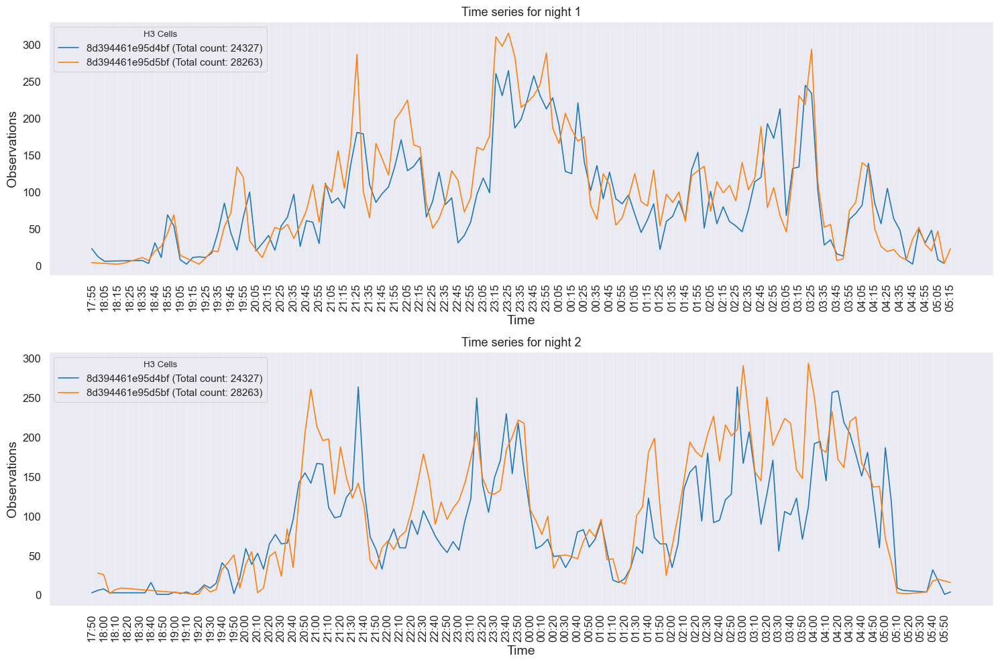

In [76]:
plot_cells_time_series(sonar_type='night', num_cells=2)

### Approaches to filter noise (Sónar by night)

I need to examine some information per user to see how data is distributed. 
I want to know the number of observations, the stay duration (timespan), and the distinct number of visited cells for each user and each day/night of the fesival.

In [77]:
info_per_user_night = duckdb_conn.sql("""
                                          SELECT vendor_name,
                                                macaddr_randomized,
                                                anonymized_macaddr,
                                                label_night,
                                                COUNT(*) AS observations_user_night,
                                                (MAX(timestamp_ap) - MIN(timestamp_ap))/60 AS timespan_minutes_night,
                                                COUNT(DISTINCT h3_cell) AS num_distinct_h3_cells_night
                                          FROM locations_night_filtered
                                          GROUP BY vendor_name, macaddr_randomized, anonymized_macaddr, label_night,
                                          ORDER BY label_night, anonymized_macaddr, timespan_minutes_night, observations_user_night""")

In [78]:
'''fig = px.scatter_3d(info_per_user_night.to_df(), x='observations_user_night', y='timespan_minutes_night', z='num_distinct_h3_cells_night', color='macaddr_randomized')

# Update the layout to make the plot taller
fig.update_layout(
    height=800  
)

# Show the plot
fig.show()'''

"fig = px.scatter_3d(info_per_user_night.to_df(), x='observations_user_night', y='timespan_minutes_night', z='num_distinct_h3_cells_night', color='macaddr_randomized')\n\n# Update the layout to make the plot taller\nfig.update_layout(\n    height=800  \n)\n\n# Show the plot\nfig.show()"

In [79]:
def plot_pairplot(df, sonar_type='night', columns=None, filename_to_save=None, custom_labels=None):
    """
    Function to create and customize a pairplot for the given dataframe.
    
    Parameters:
    - df: DataFrame containing the data to be visualized.
    - filename_to_save: The path where to save the plot (if save=None, saving is omitted).
    - columns: Columns to plot. If None (which is the default), the plotted columns are observations_user, timespan_minutes, and num_distinct_h3_cells
    """

    if columns:
        column_list = columns
    else:
        column_list=[f'observations_user_{sonar_type}', f'timespan_minutes_{sonar_type}', 
                     f'num_distinct_h3_cells_{sonar_type}', 'macaddr_randomized']
        

    # Create the pairplot
    pairplot_fig = sns.pairplot(
        df[column_list],
        hue='macaddr_randomized'
    )
    pairplot_fig.figure.set_size_inches(12, 8)
    
    # Adjust tick frequency for 'timespan_minutes' axis and rotate x labels vertically
    for ax in pairplot_fig.axes.flatten():
        # Adjusting x and y axes ticks for 'timespan_minutes' to be spaced every 120 minutes
        if ax.get_xlabel() == f'timespan_minutes_{sonar_type}':  
            ax.set_xticks(range(0, int(df[f'timespan_minutes_{sonar_type}'].max()) + 1, 120))
        if ax.get_ylabel() == f'timespan_minutes_{sonar_type}':
            ax.set_yticks(range(0, int(df[f'timespan_minutes_{sonar_type}'].max()) + 1, 120))
        
        # Rotate the x-axis labels vertically
        for label in ax.get_xticklabels():
            label.set_rotation(45)

        # Apply custom axis labels if provided
        if custom_labels:
            if ax.get_xlabel() in custom_labels:
                ax.set_xlabel(custom_labels[ax.get_xlabel()])
            if ax.get_ylabel() in custom_labels:
                ax.set_ylabel(custom_labels[ax.get_ylabel()])
    
    # Save the plot if requested
    if filename_to_save:
        pairplot_fig.savefig(os.path.join(path_interactive_plots,filename_to_save))
    
    # Display the plot
    plt.show()

    # Cleaning up the variables explicitly
    plt.close(pairplot_fig.figure)
    del pairplot_fig

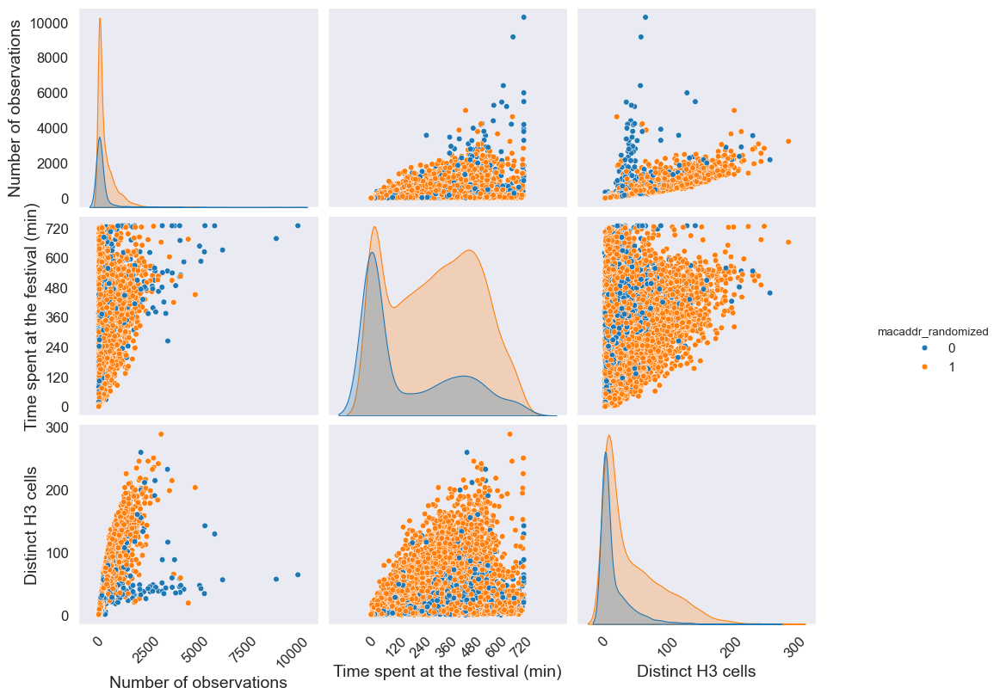

In [80]:
custom_labels = {
    'observations_user_night': 'Number of observations',
    'timespan_minutes_night': 'Time spent at the festival (min)',
    'num_distinct_h3_cells_night': 'Distinct H3 cells',
}
plot_pairplot(df=info_per_user_night.to_df(), filename_to_save=None, custom_labels=custom_labels)
#filename_to_save='night_pairplot_raw.png'

In [81]:
devices_vendor_raw_night = duckdb_conn.sql("""
                                           SELECT vendor_name, COUNT(*) as num_devices
                                           FROM info_per_user_night
                                           GROUP BY vendor_name
                                           ORDER BY num_devices DESC""").to_df()
devices_vendor_raw_night

,vendor_name,num_devices
0,None,4338
1,MediaTek Inc.,663
2,Xiaomi Communications Co Ltd,416
3,"HUAWEI TECHNOLOGIES CO.,LTD",121
4,"Apple, Inc.",102
5,"Shenzhen Xingguodu Technology Co., Ltd.",84
6,"Samsung Electronics Co.,Ltd",52
7,Intel Corporate,50
8,SAMSUNG ELECTRO-MECHANICS(THAILAND),27
9,Earda Technologies co Ltd,22


#### Removing single-cell MAC addresses

I try to check if there are MAC addresses that only have one cell during the whole event (devices fixed by the organization, apart form the single observations).

In [82]:
info_per_users_cells = duckdb_conn.sql("""
                                        SELECT * 
                                        FROM 
                                            info_per_user_night
                                        ORDER BY macaddr_randomized ASC, num_distinct_h3_cells_night DESC, observations_user_night DESC""").to_df()
info_per_users_cells

,vendor_name,macaddr_randomized,anonymized_macaddr,label_night,observations_user_night,timespan_minutes_night,num_distinct_h3_cells_night
0,Xiaomi Communications Co Ltd,0,5925633308bcf19365864579b18237659c646bff940d93...,2,2181,458.300000,260
1,"HUAWEI TECHNOLOGIES CO.,LTD",0,e9fc717d0987658ef8d98e00b93450e9c1cd305fb6d487...,1,3556,546.983333,233
2,"HUAWEI TECHNOLOGIES CO.,LTD",0,9138fa2c73fc08670a2b6c69b5c7536da3c5e714f3faa3...,1,2911,546.950000,215
3,"HUAWEI TECHNOLOGIES CO.,LTD",0,ca311efb752e48bff35a928cf8de4df6569e79b1ae4b01...,2,2373,482.400000,212
4,"HUAWEI TECHNOLOGIES CO.,LTD",0,8c9652499aca38f5e2f2a12be0934b32b85973de271495...,1,2186,425.000000,200
...,...,...,...,...,...,...,...
6006,None,1,36fd2539c92851cf668e77c381fc1b296fdfed0d188f88...,2,1,0.000000,1
6007,None,1,3a3d11c99714df58b6fb077eceb32f5d03875c3a7af70b...,2,1,0.000000,1
6008,None,1,3ad03b97b1425be39723dc0781cefaaa1500cfc891cb41...,2,1,0.000000,1
6009,None,1,3db9f265bb4481d54e5235bab5b0d760260defc9707bcc...,2,1,0.000000,1


In [83]:
# Creating a histogram
fig = px.histogram(
    info_per_users_cells,
    x="num_distinct_h3_cells_night",
    color="macaddr_randomized",
    facet_row="label_night",
    nbins=300,
    title="Distribution of distinct cells per user (Sónar by night)",
    category_orders={"macaddr_randomized": [0, 1]})

# Updating the layout
fig.update_layout(
    xaxis_title="Distinct h3_cells",
    yaxis_title="Users",
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14)


# Showing the plot
fig.show()
#fig.write_html(os.path.join(path_interactive_plots,'distinct_cells_night.html'))

I can safely remove observations from users with just 1 distinct cell, as they don't really provide any information (they might indeed be MAC addresses from the organization devices).

In [84]:
duckdb_conn.sql("""SELECT vendor_name, macaddr_randomized, anonymized_macaddr, observations_user_night, timespan_minutes_night, num_distinct_h3_cells_night
                FROM info_per_users_cells
                WHERE num_distinct_h3_cells_night = 1
                ORDER BY observations_user_night DESC""")

┌─────────────────────────────────────┬────────────────────┬──────────────────────────────────────────────────────────────────┬─────────────────────────┬────────────────────────┬─────────────────────────────┐
│             vendor_name             │ macaddr_randomized │                        anonymized_macaddr                        │ observations_user_night │ timespan_minutes_night │ num_distinct_h3_cells_night │
│               varchar               │       int64        │                             varchar                              │          int64          │         double         │            int64            │
├─────────────────────────────────────┼────────────────────┼──────────────────────────────────────────────────────────────────┼─────────────────────────┼────────────────────────┼─────────────────────────────┤
│ SAMSUNG ELECTRO-MECHANICS(THAILAND) │                  0 │ 9c68410a7bb3f9f763190b88e8eda7ec75ef5b1bbc3a1f4dde148a66da443ab3 │                      93 │           

In [85]:
del info_per_users_cells

Applying the filter for single-cell MAC address and checking the counts after filtering.

In [86]:
info_per_user_night_filter_single_cell = duckdb_conn.sql('SELECT * FROM info_per_user_night WHERE num_distinct_h3_cells_night > 1')

In [87]:
locations_night_filtered = duckdb_conn.sql("""
                                            SELECT ln.*
                                            FROM locations_night_filtered ln
                                            JOIN info_per_user_night_filter_single_cell iun
                                                ON ln.macaddr_randomized = iun.macaddr_randomized
                                                    AND ln.anonymized_macaddr = iun.anonymized_macaddr
                                                    AND ln.label_night = iun.label_night
                                             """)

In [88]:
print('Total records after filtering single cell users (Sónar by Night).')

duckdb_conn.sql("""
                SELECT macaddr_randomized, COUNT(*) AS total_records
                FROM locations_night_filtered
                GROUP BY macaddr_randomized

                UNION ALL

                SELECT 'Total' AS macaddr_randomized, COUNT(*) AS total_records
                FROM locations_night_filtered
                """)

Total records after filtering single cell users (Sónar by Night).


┌────────────────────┬───────────────┐
│ macaddr_randomized │ total_records │
│      varchar       │     int64     │
├────────────────────┼───────────────┤
│ 0                  │        361622 │
│ 1                  │       1520141 │
│ Total              │       1881763 │
└────────────────────┴───────────────┘

In [89]:
print('Total unique MAC addresses after filtering single cell users (Sónar by Night).')

duckdb_conn.sql("""
                SELECT macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                FROM locations_night_filtered
                GROUP BY macaddr_randomized

                UNION ALL

                SELECT 'Total' AS macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                FROM locations_night_filtered
                """)

Total unique MAC addresses after filtering single cell users (Sónar by Night).


┌────────────────────┬───────────────────┐
│ macaddr_randomized │ unique_user_count │
│      varchar       │       int64       │
├────────────────────┼───────────────────┤
│ 0                  │               664 │
│ 1                  │              2736 │
│ Total              │              3400 │
└────────────────────┴───────────────────┘

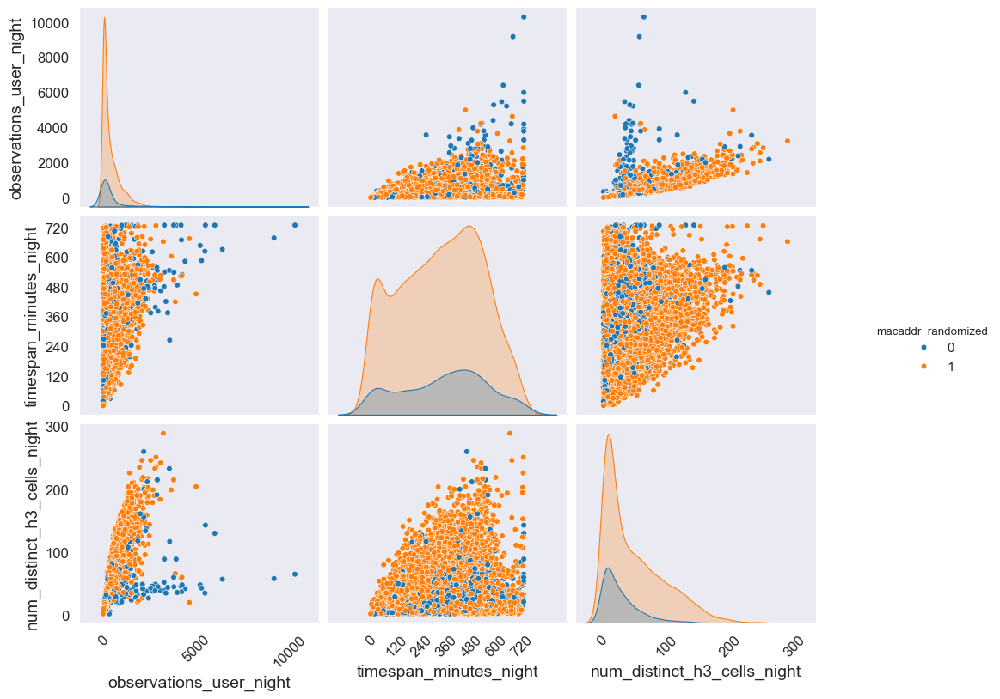

In [90]:
plot_pairplot(info_per_user_night_filter_single_cell.to_df(), filename_to_save=None)
#filename_to_save='night_pairplot_filter_single_cell.png'

#### Distribution of the time spent

I will try to filter based on the time the users spent at the festival each day.

First I check the distribution of that time span.

In [91]:
info_per_user_night_filter_single_cell_df = info_per_user_night_filter_single_cell.to_df()

In [92]:
# Creating a violin plot
fig = px.violin(
    info_per_user_night_filter_single_cell_df,
    x='label_night',
    y='timespan_minutes_night',
    color='macaddr_randomized',
    box=True,
    points='outliers',
    title='Distribution of the time spent per user (Sónar by night)',
    category_orders={"macaddr_randomized": [0, 1]})

# Updating the layout
fig.update_layout(
    xaxis_title='Night of the festival',
    yaxis_title='Time spent at the festival (minutes)',
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14)

fig.show()
#fig.write_html(os.path.join(path_interactive_plots,'night_time_violin_filter_single_cell.html'))

In [93]:
# Creating a histogram
fig = px.histogram(
    info_per_user_night_filter_single_cell_df,
    x="timespan_minutes_night",
    color="macaddr_randomized",
    facet_row="label_night",
    nbins=500,
    title="Distribution of the time spent by each MAC address (Sónar by night)",
    category_orders={"macaddr_randomized": [0, 1]}
)

# Updating the layout
fig.update_layout(
    xaxis_title="Time spent at the festival (minutes)",
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14
)

# Updating the y-axis title for all facets
fig.for_each_yaxis(lambda yaxis: yaxis.update(title_text='Devices'))

# Showing the plot
fig.show()
#fig.write_html(os.path.join(path_interactive_plots,'night_time_hist_filter_single_cell.html'))

In [94]:
# Prepare the data
data_0 = info_per_user_night_filter_single_cell_df[info_per_user_night_filter_single_cell_df['macaddr_randomized'] == 0]['timespan_minutes_night']
data_1 = info_per_user_night_filter_single_cell_df[info_per_user_night_filter_single_cell_df['macaddr_randomized'] == 1]['timespan_minutes_night']

# Create the distplot
fig = ff.create_distplot(
    [data_0, data_1], 
    group_labels=["Non-randomized", "Randomized"],
    show_hist=False, 
    show_rug=False,)

# Update layout
fig.update_layout(
    title="Density plot of time spent per user (Sónar by night)",
    xaxis_title="Time spent at the festival (minutes)",
    yaxis_title="Density",
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14,
    legend_title="macaddr_randomized"
)

# Show the plot
fig.show()
#fig.write_html(os.path.join(path_interactive_plots,'night_time_density_single_cell.html'))

There is a clear peak at the beginning of the time spent range that distorts the rest of the distribution, but there is no clear cut. This might represent MAC addresses of users that were just passing by the Fira, but did not take part of the festival.

On the other hand, there is also another clear but smaller peak at the end of the distribution. This peak is more easily identified above 720 minutes (12 hours). Given that I had already filtered the data with the time when events took place, this peak is likely caused by devices staying more than 12 hours within the Fira (maybe fixed or organizational devices). 

These extreme scenarios might distort the analysis results, so I decided to bound the time scope of the study,similar to the approach taken in the previous Sónar paper..  

I address the peak in the right part of the distribution first.    

##### Upper time bound

In any case, the last bin, which corresponds to 12 hours or more is also a peak. It mostly contains non-randomized MAC addresses, unlike the rest of the dataset, which might also indicate non-mobile devices from the organization.
However, it seems that there are many MAC addresses that spent a long time, across all the range of observations distribution and the amount of distinct cells that were visited. I take a closer look at these examples

In [95]:
print('Time spent per user Sónar by night (filtered for single cell MACs):')
night_timespan_distribution_filter_single_cell = duckdb_conn.query("""
                                                                  SELECT
                                                                    MIN(timespan_minutes_night) AS min_timespan,
                                                                    PERCENTILE_CONT(0.05) WITHIN GROUP(ORDER BY timespan_minutes_night) AS p05_timespan,
                                                                    PERCENTILE_CONT(0.10) WITHIN GROUP(ORDER BY timespan_minutes_night) AS p10_timespan,
                                                                    PERCENTILE_CONT(0.25) WITHIN GROUP(ORDER BY timespan_minutes_night) AS p25_timespan,
                                                                    PERCENTILE_CONT(0.50) WITHIN GROUP(ORDER BY timespan_minutes_night) AS median_timespan,
                                                                    PERCENTILE_CONT(0.75) WITHIN GROUP(ORDER BY timespan_minutes_night) AS p75_timespan,
                                                                    PERCENTILE_CONT(0.90) WITHIN GROUP(ORDER BY timespan_minutes_night) AS p90_timespan,
                                                                    PERCENTILE_CONT(0.95) WITHIN GROUP(ORDER BY timespan_minutes_night) AS p95_timespan,
                                                                    PERCENTILE_CONT(0.975) WITHIN GROUP(ORDER BY timespan_minutes_night) AS p975_timespan,
                                                                    MAX(timespan_minutes_night) AS max_timespan
                                                                  FROM info_per_user_night_filter_single_cell_df
                                                                  """)
night_timespan_distribution_filter_single_cell

Time spent per user Sónar by night (filtered for single cell MACs):


┌──────────────┬──────────────┬──────────────┬────────────────────┬────────────────────┬────────────────────┬───────────────────┬───────────────────┬───────────────────┬───────────────────┐
│ min_timespan │ p05_timespan │ p10_timespan │    p25_timespan    │  median_timespan   │    p75_timespan    │   p90_timespan    │   p95_timespan    │   p975_timespan   │   max_timespan    │
│    double    │    double    │    double    │       double       │       double       │       double       │      double       │      double       │      double       │      double       │
├──────────────┼──────────────┼──────────────┼────────────────────┼────────────────────┼────────────────────┼───────────────────┼───────────────────┼───────────────────┼───────────────────┤
│          0.1 │          9.9 │        41.26 │ 177.13333333333333 │ 351.06666666666666 │ 488.60833333333335 │ 583.8933333333333 │ 648.6416666666664 │ 681.5983333333334 │ 729.9166666666666 │
└──────────────┴──────────────┴──────────────┴────

In any case, the last bin, which corresponds to 12 hours or more is also a peak. It mostly contains non-randomized MAC addresses, unlike the rest of the dataset, which might also indicate devices from the organization.
However, it seems that there are many MAC addresses that spent a long time, across all the range of observations distribution and the amount of distinct cells that were visited. I take a closer look at these examples

In [96]:
upper_time_bound_percentile = 'p975'
upper_time_bound_night = round(duckdb_conn.sql(f"""(SELECT {upper_time_bound_percentile}_timespan FROM night_timespan_distribution_filter_single_cell)""").fetchone()[0])


users_long_timespan_night = duckdb_conn.sql(f"""SELECT * FROM info_per_user_night_filter_single_cell WHERE timespan_minutes_night >= {upper_time_bound_night}""")

print(f'The upper time bound for night is {upper_time_bound_night} min')

The upper time bound for night is 682 min


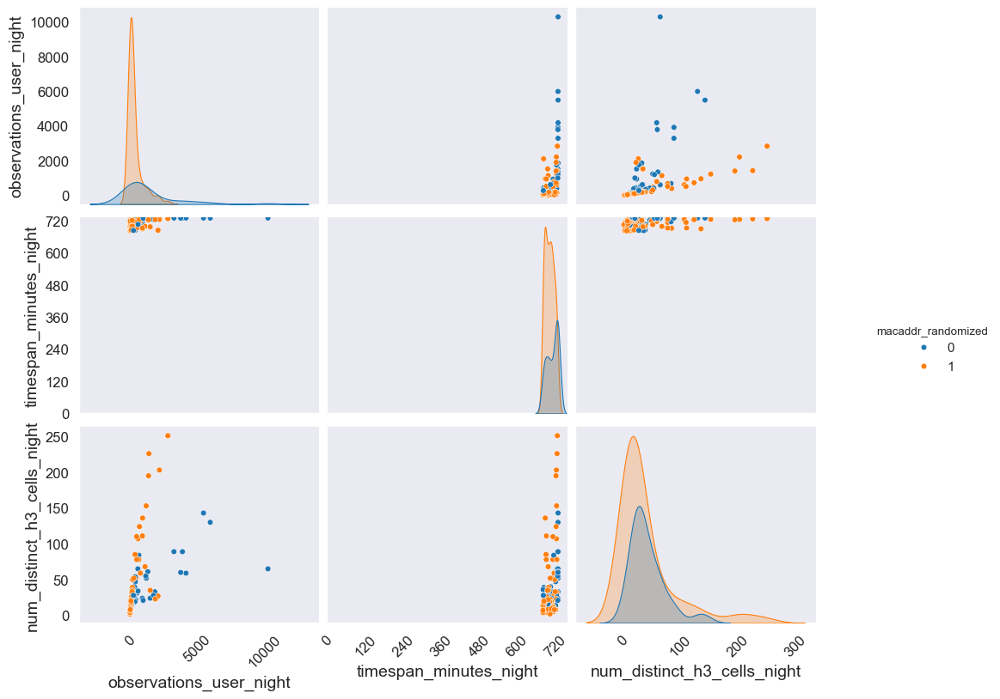

In [97]:
plot_pairplot(df=users_long_timespan_night.to_df(), filename_to_save=None)
#filename_to_save=f'night_pairplot_long_stays_{upper_time_bound_night}min.png'

In [98]:
duckdb_conn.sql("""SELECT macaddr_randomized, vendor_name, COUNT(*) AS num_devices_long_timespan 
                FROM users_long_timespan_night 
                GROUP BY macaddr_randomized, vendor_name
                ORDER BY num_devices_long_timespan DESC""")

┌────────────────────┬─────────────────────────────────────────┬───────────────────────────┐
│ macaddr_randomized │               vendor_name               │ num_devices_long_timespan │
│       int64        │                 varchar                 │           int64           │
├────────────────────┼─────────────────────────────────────────┼───────────────────────────┤
│                  1 │ NULL                                    │                        80 │
│                  0 │ Hewlett Packard Enterprise              │                         8 │
│                  0 │ Intel Corporate                         │                         6 │
│                  0 │ Earda Technologies co Ltd               │                         6 │
│                  0 │ AzureWave Technology Inc.               │                         5 │
│                  0 │ AMPAK Technology,Inc.                   │                         4 │
│                  0 │ Shenzhen Xingguodu Technology Co., Ltd. │      

As many of the devices do not come from mobile-related vendors and it covers more than the entire span of the events for each night, p975 is a safe and reasonable upper bound. 

In [99]:
# Filter for users who spent less than x minutes
users_filter_timespan_upper_night = duckdb_conn.query(f"""
                                            SELECT *
                                            FROM info_per_user_night_filter_single_cell
                                            WHERE timespan_minutes_night < {upper_time_bound_night}""").to_df()

##### Lower time bound

Now, I try to find a lower bound for the distribution. The distributions of randomized and non-randomized MAC addresses have a similar shapes, so it makes sense to find an overall lower bound (without splitting the data)

In [100]:
# Creating a violin plot
fig = px.violin(
    users_filter_timespan_upper_night,
    x='label_night',
    y='timespan_minutes_night',
    #color='macaddr_randomized',
    box=True,
    points='outliers',
    title=f'Distribution of the time spent per user (Sónar by night). Stays longer than {upper_time_bound_night} min removed',
    category_orders={"macaddr_randomized": [0, 1]})

# Updating the layout
fig.update_layout(
    xaxis_title='Night of the festival',
    yaxis_title='Time spent at the festival (minutes)',
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14)

fig.show()
#fig.write_html(os.path.join(path_interactive_plots,f'night_time_violin_filter{upper_time_bound_night}min.html'))

In [101]:
# Creating a histogram
fig = px.histogram(
    users_filter_timespan_upper_night,
    x="timespan_minutes_night",
    #color="macaddr_randomized",
    facet_row="label_night",
    nbins=500,
    title=f"Distribution of the time spent per user (Sónar by night). Stays longer than {upper_time_bound_night} min removed",
    category_orders={"macaddr_randomized": [0, 1]})

# Updating the layout
fig.update_layout(
    xaxis_title="Time spent at the festival (minutes)",
    yaxis_title="Users",
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14)

# Showing the plot
fig.show()
#fig.write_html(os.path.join(path_interactive_plots,f'night_time_hist_filter{upper_time_bound_night}min.html'))

In [102]:
# Prepare the data

# Create the distplot
fig = ff.create_distplot(
    [users_filter_timespan_upper_night['timespan_minutes_night']], 
    group_labels=["All data"],
    show_hist=False, 
    show_rug=False,)

# Update layout
fig.update_layout(
    title=f"Density plot of time spent per user (Sónar by night). Stays longer than {upper_time_bound_night} min removed",
    xaxis_title="Time spent at the festival (minutes)",
    yaxis_title="Density",
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14,
    #legend_title="macaddr_randomized"
)

# Show the plot
fig.show()
#fig.write_html(os.path.join(path_interactive_plots,f'night_time_density_filter{upper_time_bound_night}min.html'))

Based on intuition and the previous Sónar paper, I could set the minimum time for staying at the festival at 65 minutes, which would be equivalent to stay for the duration of at least one show, plus a little extra time (most of the shows lasted 60 minutes). 

Also, by watching the histogram, it seems there might be a "cut" even below 65 minutes (around 10 minutes). Interpretation-wise, 10 minutes might be a too-short-visit, as it would be difficult to describe its meaning. Taking account that tickets were around 85 euros per night (although there were different packages and ways of paying)

Finally, there seems to be a cut around 100-120 minutes. There is concentration of unique MAC addresses below this time threshold, and then, the time spent at the festival distributes more evenly across the possible ranges. After the mentioned cut, the distribution seems to "restart". This phenomenon happens both in general and by day.

Because of the multiple exisitng possibilities for a lower bound, I try a more statistical-based criterion to define this value. One possible way of doing this is by assuming that this distribution is a combination of Gaussian distributions. In this case, I could use GMM to model the time-spent distribution data.

I tried fitting the GMM on the original data, but it was not able to capture the distorting peak at the begining of the distribution. Instead, the logarithm of the time spent shows a more obvious tail at the beginning, which was possible to model more easily:

In [103]:
# Prepare the data

# Create the distplot
fig = ff.create_distplot(
    [np.log(users_filter_timespan_upper_night['timespan_minutes_night'])], 
    group_labels=["All data"],
    show_hist=False, 
    show_rug=False,)

# Update layout
fig.update_layout(
    title="Density plot of time spent per user (Sónar by night). Stays longer than 720 min removed",
    xaxis_title="log(Time spent at the festival (minutes))",
    yaxis_title="Density",
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14,
    #legend_title="macaddr_randomized"
)

# Show the plot
fig.show()
#fig.write_html(os.path.join(path_interactive_plots,f'night_time_density_filter{upper_time_bound_night}min_log.html'))

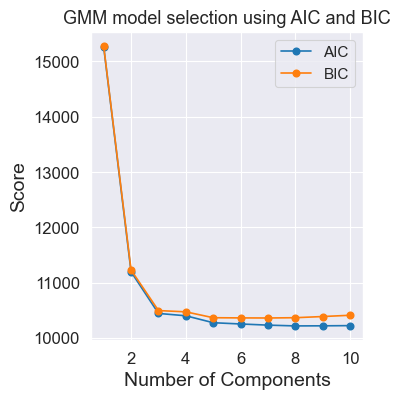

Optimal number of components based on AIC: 8
Optimal number of components based on BIC: 7
Elbow point based on AIC: 3
Elbow point based on BIC: 3


In [104]:
# Find the elbow point
utils_models.gmm_elbow_method(np.log(users_filter_timespan_upper_night['timespan_minutes_night'].to_numpy().reshape(-1, 1)),
                              filename_to_save=None)
#filename_to_save=os.path.join(path_interactive_plots,'night_time_gmm_selection.png')

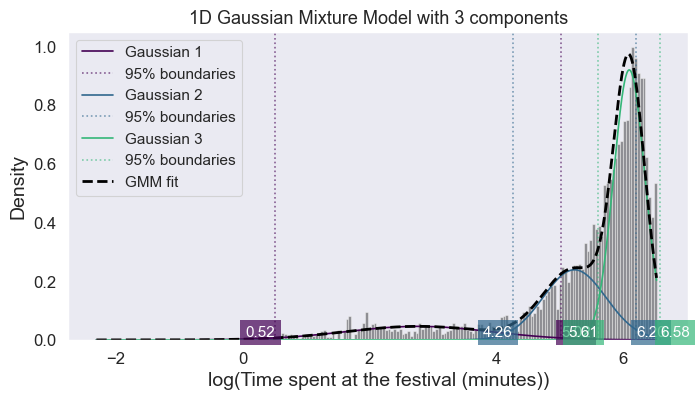

{'boundaries': [(0.517632024440259, 5.022771970421255),
  (4.259315905758421, 6.202962039007779),
  (5.609573979303348, 6.579763239237777)],
 'bic': 10497.10595196018}

In [105]:
boundaries_chosen_gmm = utils_models.gmm_1d_boundaries(data=np.log(users_filter_timespan_upper_night['timespan_minutes_night'].to_numpy().reshape(-1, 1)),
                                          n_centers=3, bins_hist=200, x_label='log(Time spent at the festival (minutes))',
                                          filename_to_save=None)
boundaries_chosen_gmm
#filename_to_save=os.path.join(path_interactive_plots,'night_time_gmm_fit.png')

In [106]:
del users_filter_timespan_upper_night

There is a high concentration of data in the two right-most components of the GMM, and the lower bound of these two distributions provides a reasonable threshold, so I choose this value as the lower bound to filter the data. 

In [107]:
print('Chosen lower bound in minutes:')
lower_time_threshold = round(np.exp(boundaries_chosen_gmm['boundaries'][1][0]))
lower_time_threshold

Chosen lower bound in minutes:


71

TODO: 

I will keep the filter for users that spent more than 71 minutes and less than 682 minutes for each night of the festival.

In [108]:
info_per_user_night_timefiltered = duckdb_conn.sql(F"""SELECT * FROM info_per_user_night_filter_single_cell WHERE timespan_minutes_night BETWEEN {lower_time_threshold} AND {upper_time_bound_night}""")

In [109]:
locations_night_filtered = duckdb_conn.sql(F"""
                                           SELECT ld.*, iuf.observations_user_night, iuf.timespan_minutes_night, iuf.num_distinct_h3_cells_night
                                           FROM locations_night_filtered ld
                                            INNER JOIN info_per_user_night_timefiltered iuf 
                                            ON ld.anonymized_macaddr = iuf.anonymized_macaddr
                                                AND ld.macaddr_randomized = iuf.macaddr_randomized
                                                AND ld.label_night = iuf.label_night""")


print(f'Number of records Sónar by night (after time-based filtering with {lower_time_threshold} and {upper_time_bound_night} minutes):')
display(duckdb_conn.sql("""
                        SELECT macaddr_randomized, COUNT(*) AS total_records
                        FROM locations_night_filtered
                        GROUP BY macaddr_randomized

                        UNION ALL

                        SELECT 'Total' AS macaddr_randomized, COUNT(*) AS total_records
                        FROM locations_night_filtered
                        """))


print(f'Unique macadresses Sónar by day (after time-based filtering with {lower_time_threshold} and {upper_time_bound_night} minutes):')
display(duckdb_conn.sql("""
                        SELECT macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                        FROM locations_night_filtered
                        GROUP BY macaddr_randomized

                        UNION ALL

                        SELECT 'Total' AS macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                        FROM locations_night_filtered
                        """))

Number of records Sónar by night (after time-based filtering with 71 and 682 minutes):


┌────────────────────┬───────────────┐
│ macaddr_randomized │ total_records │
│      varchar       │     int64     │
├────────────────────┼───────────────┤
│ 0                  │        302852 │
│ 1                  │       1463885 │
│ Total              │       1766737 │
└────────────────────┴───────────────┘

Unique macadresses Sónar by day (after time-based filtering with 71 and 682 minutes):


┌────────────────────┬───────────────────┐
│ macaddr_randomized │ unique_user_count │
│      varchar       │       int64       │
├────────────────────┼───────────────────┤
│ 1                  │              2382 │
│ 0                  │               554 │
│ Total              │              2936 │
└────────────────────┴───────────────────┘

#### Examining observations and distinct cells

I update the users table to reflect the changes that have been made so far (especially the location-based filter, that was not made by querying the users table).

In [110]:
info_per_user_night_filtered = duckdb_conn.sql("""
                                          SELECT vendor_name,
                                                macaddr_randomized,
                                                anonymized_macaddr,
                                                label_night,
                                                COUNT(*) AS observations_user_night,
                                                (MAX(timestamp_ap) - MIN(timestamp_ap))/60 AS timespan_minutes_night,
                                                COUNT(DISTINCT h3_cell) AS num_distinct_h3_cells_night
                                          FROM locations_night_filtered
                                          GROUP BY vendor_name, anonymized_macaddr, macaddr_randomized, label_night,
                                          ORDER BY label_night, anonymized_macaddr, timespan_minutes_night, observations_user_night""")

info_per_user_night_filtered_df = info_per_user_night_filtered.df()

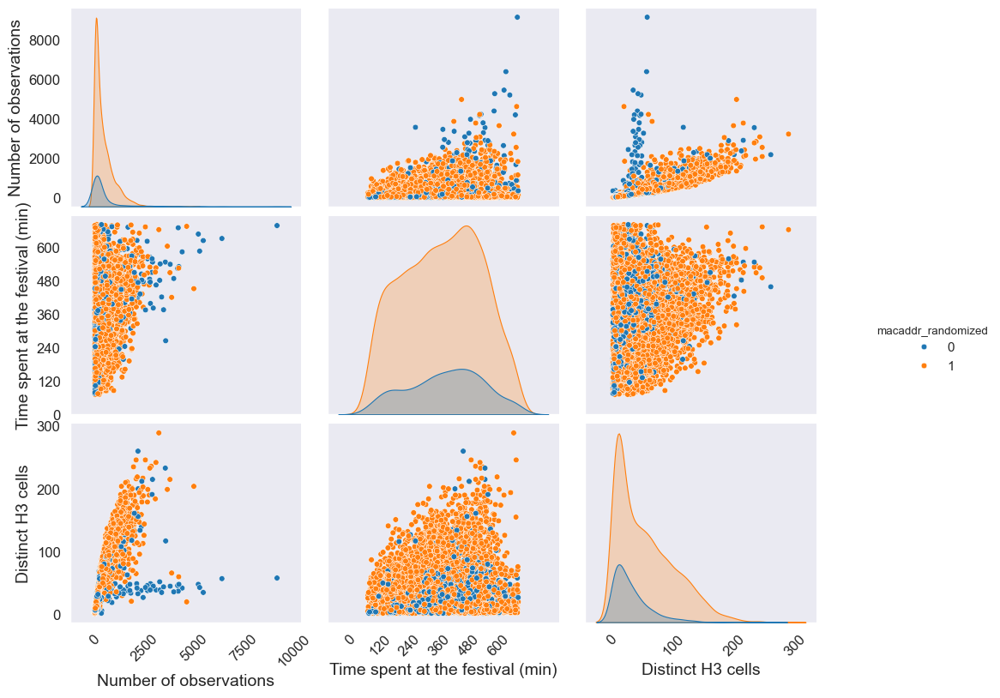

In [111]:
custom_labels = {
    'observations_user_night': 'Number of observations',
    'timespan_minutes_night': 'Time spent at the festival (min)',
    'num_distinct_h3_cells_night': 'Distinct H3 cells',
}

plot_pairplot(df=info_per_user_night_filtered_df, filename_to_save=None, custom_labels=custom_labels)
#filename_to_save=f'night_pairplot_filter_time{lower_time_threshold}-{upper_time_bound_night}min.png'

Now, the time spent by day has a more regular distribution. However, the observations and the distinct cells distributions are highly right-skewed. I will check the distribution of observations a little closer.

##### Distribution of observations

In [112]:
# Creating a violin plot
fig = px.violin(
    info_per_user_night_filtered_df,
    x='label_night',
    y='observations_user_night',
    color='macaddr_randomized',  
    box=True,  
    points='outliers',  
    title=f'Distribution of observations per user (Sónar by night). Filtered with time ({lower_time_threshold}-{upper_time_bound_night} mins)',
    category_orders={"macaddr_randomized": [0, 1]})

# Updating the layout
fig.update_layout(
    xaxis_title='Night of the festival',
    yaxis_title='Observations per user',
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14)

fig.show()

In [113]:
# Creating a histogram
fig = px.histogram(
    info_per_user_night_filtered_df,
    x="observations_user_night",
    color="macaddr_randomized",
    facet_row="label_night",
    nbins=5000,
    title=f"Distribution of observations per user (Sónar by night). Filtered with time ({lower_time_threshold}-{upper_time_bound_night} mins)",
    category_orders={"macaddr_randomized": [0, 1]})

# Updating the layout
fig.update_layout(
    xaxis_title="Observations per user",
    yaxis_title="Users",
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14)

# Showing the plot
fig.show()

##### Distribution of distinct cells

Checking the  distribution of number of distinct cells per user (in a day).

In [114]:
# Creating a violin plot
fig = px.violin(
    info_per_user_night_filtered_df,
    x='label_night',
    y='num_distinct_h3_cells_night',
    color='macaddr_randomized',  
    box=True,  
    points='outliers',  
    title=f'Distribution of distinct H3 cells per user (Sónar by night). Filtered with time ({lower_time_threshold}-{upper_time_bound_night} mins)',
    category_orders={"macaddr_randomized": [0, 1]})

# Updating the layout
fig.update_layout(
    xaxis_title='Night of the festival',
    yaxis_title='Observations per user',
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14)

fig.show()

In [115]:
# Creating a histogram
fig = px.histogram(
    info_per_user_night_filtered_df,
    x="num_distinct_h3_cells_night",
    color="macaddr_randomized",
    facet_row="label_night",
    nbins=500,
    title=f"Distribution of distinct H3 cells per user (Sónar by night). Filtered with time ({lower_time_threshold}-{upper_time_bound_night} mins)",
    category_orders={"macaddr_randomized": [0, 1]})

# Updating the layout
fig.update_layout(
    xaxis_title="Observations per user",
    yaxis_title="Users",
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14)

# Showing the plot
fig.show()

Perhaps the distinct cells distribution seems to have a more bell-like shape than the observations. Also, randomized MAC addresses move more than non-randomized ones.

#### Combined metrics based on observations and distinct cells

It is hard to draw conclusions from the observations and distinct cells distributions by themselves, but, looking at the pairplots, it seems there are some strange cases when looking at the joint distributions of the observations and the distinct cells, as some of the examples do not follow the "diagonal" pattern  

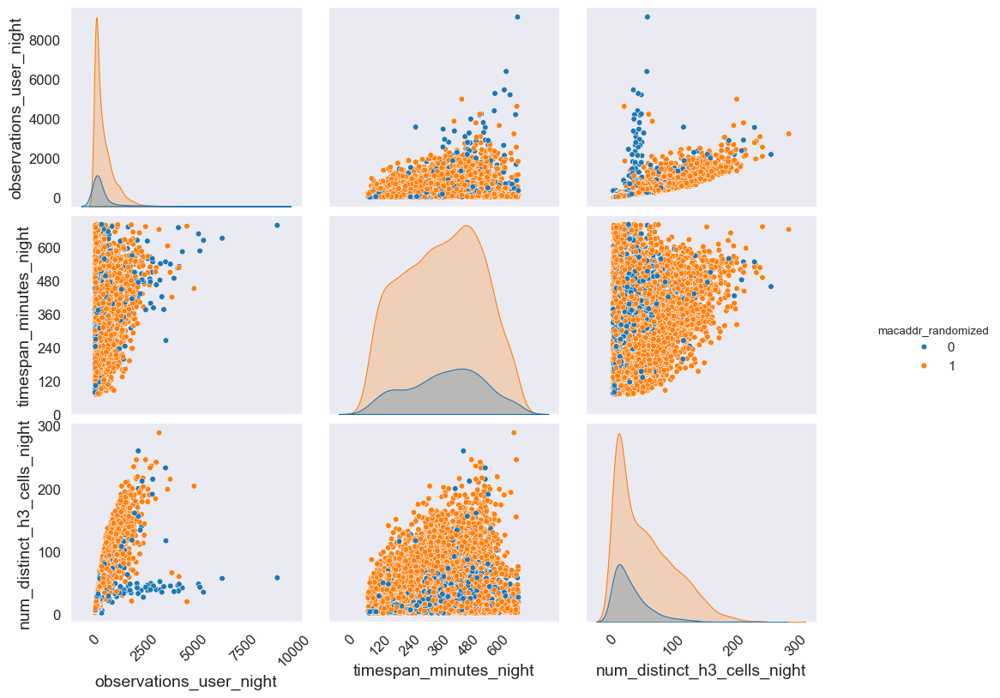

In [116]:
plot_pairplot(info_per_user_night_filtered_df)

I am going to compute some derived metrics to gain a little interpretation insights out of the points I am checking.

In [117]:
info_per_user_night_filtered_df['observations_per_cell'] = info_per_user_night_filtered_df['observations_user_night'] / info_per_user_night_filtered_df['num_distinct_h3_cells_night']
info_per_user_night_filtered_df['observations_per_minute'] = info_per_user_night_filtered_df['observations_user_night'] / info_per_user_night_filtered_df['timespan_minutes_night']
info_per_user_night_filtered_df['minutes_per_cell'] = info_per_user_night_filtered_df['timespan_minutes_night'] / info_per_user_night_filtered_df['num_distinct_h3_cells_night']

info_per_user_night_filtered_df['log_num_distinct_h3_cells_night'] = np.log(info_per_user_night_filtered_df['num_distinct_h3_cells_night'])
info_per_user_night_filtered_df['log_observations_user_night'] = np.log(info_per_user_night_filtered_df['observations_user_night'])
info_per_user_night_filtered_df['log_timespan_minutes_night'] = np.log(info_per_user_night_filtered_df['timespan_minutes_night'])

In [118]:
'''sns.pairplot(
        info_per_user_night_filtered_df[['observations_per_cell', 'observations_per_minute', 'cells_per_minute', 'macaddr_randomized']],
        hue='macaddr_randomized')'''

"sns.pairplot(\n        info_per_user_night_filtered_df[['observations_per_cell', 'observations_per_minute', 'cells_per_minute', 'macaddr_randomized']],\n        hue='macaddr_randomized')"

There seems to be a positive correlation between the observations and the distinct cells. Fitting a linear regression might help to identify a trend and the users that do not follow this trend. For that reason, I implement a function (`flag_outliers_linear_models`, available in `utils_models.py`) that flags outliers based on the prediction intervals with a given level of confidence. 

In [145]:
def outliers_linear_models(df_users_info, x_variable, y_variable, reg_type, alpha=0.05, show_eval_metrics=False, x_label=None, y_label=None, y_lims=None):

    # The dataframes are modified and there are some indices issues, so it is better to make copies and 
    # return them. This list is to keep the modified dataframes and then concat them (I will split them at some point)
    list_dfs = []

    # Organizing the variables to reuse the regression and plotting functionalities as a dictionary with:
    # {label: (df, color_plot)}
    if reg_type == 'all points':
        df_split_dict = {'General': (df_users_info.copy(),
                                     'green')} # The color of the data points depend of the MAC type
    elif reg_type == 'by MAC address type':
        df_split_dict = {'Randomized': (df_users_info.loc[df_users_info['macaddr_randomized']==1].copy(),
                                        'red'),
                         'Non-randomized': (df_users_info.loc[df_users_info['macaddr_randomized']==0].copy(),
                                            'blue')}
        
    # Initialize the plot
    reg_fig = plt.figure(figsize=(7.5, 4.5))
    reg_ax = reg_fig.add_subplot(111)

    for label, (df_split, color) in df_split_dict.items():

        # Execute the function to find the outliers    
        df_split, linear_model = utils_models.flag_outliers_linear_models(df_split, x_variable, y_variable, alpha=alpha, show_eval_metrics=show_eval_metrics)

        # Plotting the outliers
        outliers = df_split.loc[df_split['outlier_lin_reg']=='yes']  # Data points where residuals are flagged as outliers
        reg_ax.scatter(outliers[x_variable], outliers[y_variable], color=f'dark{color}', label=f'Outliers - {label}', marker='x')

        #----------------------------------------------------------------------------------------------------
        # Plotting the rest of the things
        # Original data points
        non_outliers = df_split.loc[df_split['outlier_lin_reg']=='no']
        if reg_type == 'all points':
            # Plotting the points for each type of MAC address separately
            non_outliers_random = non_outliers.loc[non_outliers['macaddr_randomized']==1]
            non_outliers_non_random = non_outliers.loc[non_outliers['macaddr_randomized']==0]

            reg_ax.scatter(non_outliers_random[x_variable], non_outliers_random[y_variable], c='yellow', alpha=0.7, label=f'Data - Randomized')
            reg_ax.scatter(non_outliers_non_random[x_variable], non_outliers_non_random[y_variable], c='purple', alpha=0.7, label=f'Data - Non-Randomized')
        elif reg_type == 'by MAC address type':
            reg_ax.scatter(non_outliers[x_variable], non_outliers[y_variable], c=f'dark{color}', alpha=0.3, label=f'Data - {label}')

        # Creating the x range for plotting model lines
        x_range = np.linspace(df_split[x_variable].min(), df_split[x_variable].max(), 200).reshape(-1, 1)
        x_range_with_const = sm.add_constant(x_range)

        # Predicting the mean values and plotting the regression line
        y_predicted = linear_model.predict(x_range_with_const)
        reg_ax.plot(x_range, y_predicted,
                    linewidth=2.5, label=f'Reg. line - {label}', c=color)
        
        # I need to compute the bounds again, but for all the x range just for plotting
        # (if not, it plots the bound for each observation and it does not look good)
        # Prediction interval bounds -(1-alpha)% confidence-
        pred_interval_bounds_plot = linear_model.get_prediction(x_range_with_const).summary_frame(alpha=alpha)
        y_lower_plot = pred_interval_bounds_plot['obs_ci_lower']
        y_upper_plot = pred_interval_bounds_plot['obs_ci_upper']

        reg_ax.plot(x_range, y_lower_plot, linestyle='--', c=color, label=f"Pred. intervals - {label}")
        reg_ax.plot(x_range, y_upper_plot, linestyle='--', c=color)

        # Appending the dataframe to the list for the final concatenation (in the end of the function)
        list_dfs.append(df_split)

        # Printing the number of resulting outliers
        print(f'Outliers - {label}: {len(outliers)}')

    # Add labels and title
    reg_ax.set_title(f'Linear regression ({reg_type}). Alpha={alpha}')
    reg_ax.set_xlabel(x_label if x_label else x_variable)
    reg_ax.set_ylabel(y_label if y_label else y_variable)
    reg_ax.legend()

    if y_lims:
        reg_ax.set_ylim(y_lims)


    plt.sca(reg_ax)
    plt.show()

    # Concatenating the modified dfs and returning the concatenated result
    df_split_modified = pd.concat(list_dfs, ignore_index=True)
    return df_split_modified

I try four different regressions with the assumption that the number of distinct cells of a user is a function of their number of distinct cells. The strategy is to fit a linear regression and flag the points that fall outside of the $(1-\alpha)$% level of confidence **prediction** intervals (which are wider than the confidence intervals).

I choose a small $\alpha$ because I don't have that many distinct MAC addresses and I do not want to overly reduce the amount of useful data I might have.

##### Separate regression (original space)

First, I try a regression for the randomized and the non-randomzied MAC address separately. In this case, it seems that non-randomized devices have a different behavior from randomized ones, regarding these two variables. However, it seems that some outliers detected from one distribution seem to be part of the other's the distribution. In the end, I want to work with overall users.

Outliers - Randomized: 44
Outliers - Non-randomized: 16


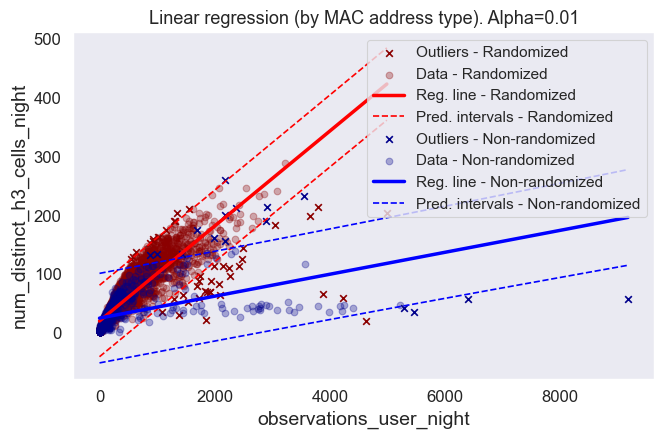

,vendor_name,macaddr_randomized,anonymized_macaddr,label_night,observations_user_night,timespan_minutes_night,num_distinct_h3_cells_night,observations_per_cell,observations_per_minute,minutes_per_cell,log_num_distinct_h3_cells_night,log_observations_user_night,log_timespan_minutes_night,outlier_lin_reg
2600,None,1,8a44c97d8f5a530470252a2523cfd4f95b6c76e0f682f6...,2,4630,675.383333,20,231.500000,6.855366,33.769167,2.995732,8.440312,6.515280,yes
1093,None,1,a2a89c6db5140d0bce55e50f1049efc4cc3c8f0c1bd5c1...,1,1846,236.783333,21,87.904762,7.796157,11.275397,3.044522,7.520776,5.467146,yes
899,None,1,8a44c97d8f5a530470252a2523cfd4f95b6c76e0f682f6...,1,1378,133.716667,30,45.933333,10.305372,4.457222,3.401197,7.228388,4.895723,yes
4045,"Shenzhen Xingguodu Technology Co., Ltd.",0,e7e675643869df0f7ea8122a350cb07a56b2ca78715668...,2,5465,624.333333,35,156.142857,8.753337,17.838095,3.555348,8.606119,6.436684,yes
3019,None,1,c6390d254963d7b7716331d5d491b627125499ce14bde2...,2,1090,202.350000,36,30.277778,5.386706,5.620833,3.583519,6.993933,5.309999,yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
801,None,1,7cc1bbb3f4c08dde451459ef492be5c0b4bbd90c0e6cf1...,1,2849,508.533333,236,12.072034,5.602386,2.154802,5.463832,7.954723,6.231531,no
1843,None,1,1b18a57e83edac30d0fb7fb8edccefb6e04a8bf0544e46...,2,3084,526.616667,242,12.743802,5.856252,2.176102,5.488938,8.033983,6.266473,no
278,None,1,2ac32517ff1b6a113afcfa484adca7dd0958082d6e7c6f...,1,2551,673.433333,246,10.369919,3.788051,2.737534,5.505332,7.844241,6.512389,no
2011,None,1,3254158a73d007ba0400ddf4dc4b2fe914e1e7003bd2ed...,2,2085,490.650000,246,8.475610,4.249465,1.994512,5.505332,7.642524,6.195731,no


In [146]:
outliers_cells_vs_obs_split = outliers_linear_models(df_users_info=info_per_user_night_filtered_df,
                                                     x_variable='observations_user_night', y_variable='num_distinct_h3_cells_night',
                                                     reg_type = 'by MAC address type', alpha=0.01,
                                                     show_eval_metrics=False).sort_values(by=['outlier_lin_reg','num_distinct_h3_cells_night'], ascending=[False,True])
outliers_cells_vs_obs_split

##### Combined regression (original space)

In this case, I try to perform the regression with all points and discard outliers from the combined dataset (which seem to be, again, sort of static MAC addresses: devices that have a lot of observations, but did not move much).

--------------------------------------------------------------------
Regression assessment metrics for  regression:
                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.533
Model:                            OLS   Adj. R-squared:                  0.533
Method:                 Least Squares   F-statistic:                     4661.
Date:               mi., 02 abr. 2025   Prob (F-statistic):               0.00
Time:                        17:36:04   Log-Likelihood:                -19901.
No. Observations:                4087   AIC:                         3.981e+04
Df Residuals:                    4085   BIC:                         3.982e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
---------------

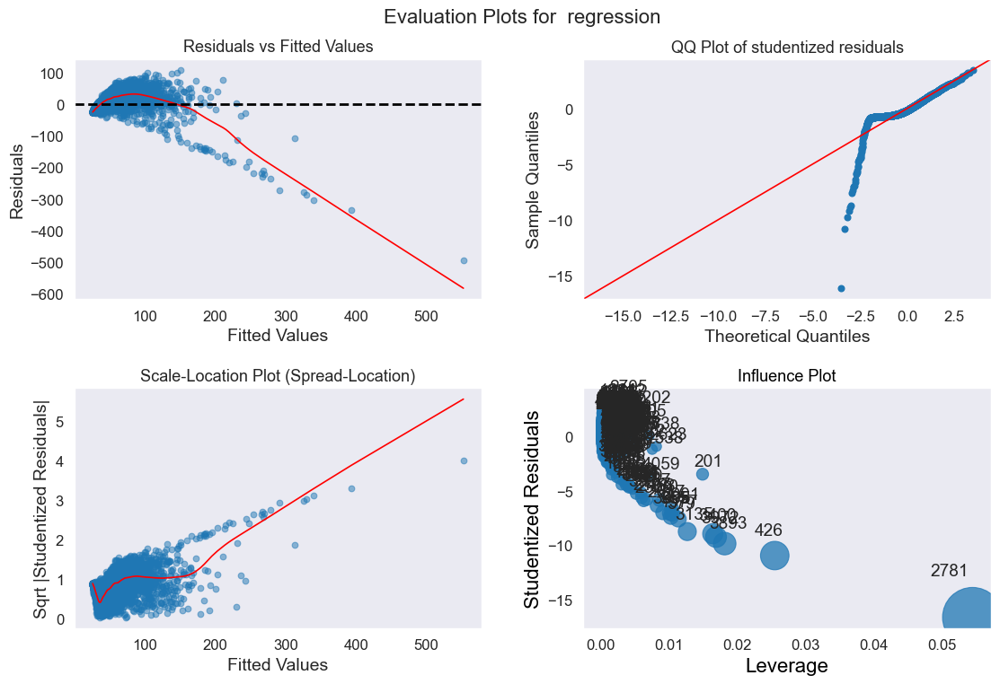

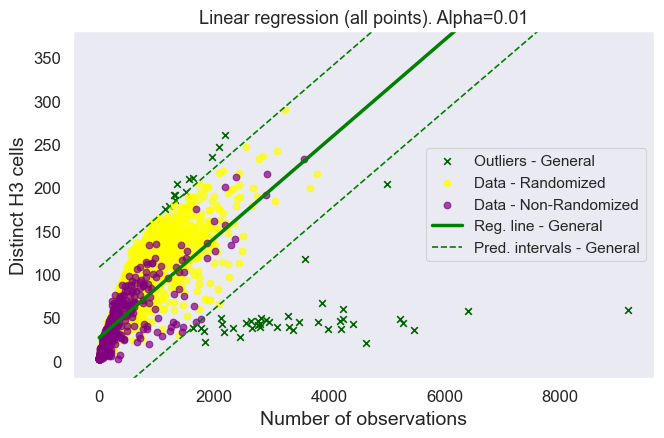

,vendor_name,macaddr_randomized,anonymized_macaddr,label_night,observations_user_night,timespan_minutes_night,num_distinct_h3_cells_night,observations_per_cell,observations_per_minute,minutes_per_cell,log_num_distinct_h3_cells_night,log_observations_user_night,log_timespan_minutes_night,outlier_lin_reg
3135,None,1,8a44c97d8f5a530470252a2523cfd4f95b6c76e0f682f6...,2,4630,675.383333,20,231.500000,6.855366,33.769167,2.995732,8.440312,6.515280,yes
1297,None,1,a2a89c6db5140d0bce55e50f1049efc4cc3c8f0c1bd5c1...,1,1846,236.783333,21,87.904762,7.796157,11.275397,3.044522,7.520776,5.467146,yes
1175,"Shenzhen Xingguodu Technology Co., Ltd.",0,94975b4d37798f19460d4a8cd9cf03cb5d697bef7d362f...,1,2440,476.616667,27,90.370370,5.119418,17.652469,3.295837,7.799753,6.166713,yes
1362,"Shenzhen Xingguodu Technology Co., Ltd.",0,ac9fa49e683fb891c620329831e8db182e39447e10269e...,1,2176,408.000000,33,65.939394,5.333333,12.363636,3.496508,7.685244,6.011267,yes
1421,"Shenzhen Xingguodu Technology Co., Ltd.",0,b46485942f69278e0b3a86f065487e8af1bdd23d49e811...,1,1818,308.650000,34,53.470588,5.890167,9.077941,3.526361,7.505492,5.732208,yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1838,"HUAWEI TECHNOLOGIES CO.,LTD",0,e9fc717d0987658ef8d98e00b93450e9c1cd305fb6d487...,1,3556,546.983333,233,15.261803,6.501112,2.347568,5.451038,8.176392,6.304418,no
959,None,1,7cc1bbb3f4c08dde451459ef492be5c0b4bbd90c0e6cf1...,1,2849,508.533333,236,12.072034,5.602386,2.154802,5.463832,7.954723,6.231531,no
2205,None,1,1b18a57e83edac30d0fb7fb8edccefb6e04a8bf0544e46...,2,3084,526.616667,242,12.743802,5.856252,2.176102,5.488938,8.033983,6.266473,no
332,None,1,2ac32517ff1b6a113afcfa484adca7dd0958082d6e7c6f...,1,2551,673.433333,246,10.369919,3.788051,2.737534,5.505332,7.844241,6.512389,no


In [160]:
outliers_cells_vs_obs_all = outliers_linear_models(df_users_info=info_per_user_night_filtered_df,
                                                   x_variable='observations_user_night', y_variable='num_distinct_h3_cells_night',
                                                   reg_type = 'all points', alpha=0.01,
                                                   show_eval_metrics=True,
                                                   x_label='Number of observations', y_label='Distinct H3 cells',
                                                   y_lims=[-20,380]).sort_values(by=['outlier_lin_reg','num_distinct_h3_cells_night'], ascending=[False,True])
outliers_cells_vs_obs_all

##### Combined regression (log-log)

The previous approach seems to flag outliers reasonably, interpretation-wise. However, there is some heteroscedasticity in the residuals and the quality of the regression might be improved. For this reason, I try a log-log regression, which has a better fit, stabilizes the variance and preserves the outlier detection principles (flagging rather static MAC addresses).

--------------------------------------------------------------------
Regression assessment metrics for  regression:
                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.900
Model:                            OLS   Adj. R-squared:                  0.900
Method:                 Least Squares   F-statistic:                 3.693e+04
Date:               mi., 02 abr. 2025   Prob (F-statistic):               0.00
Time:                        17:24:20   Log-Likelihood:                -1638.4
No. Observations:                4087   AIC:                             3281.
Df Residuals:                    4085   BIC:                             3293.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
---------------

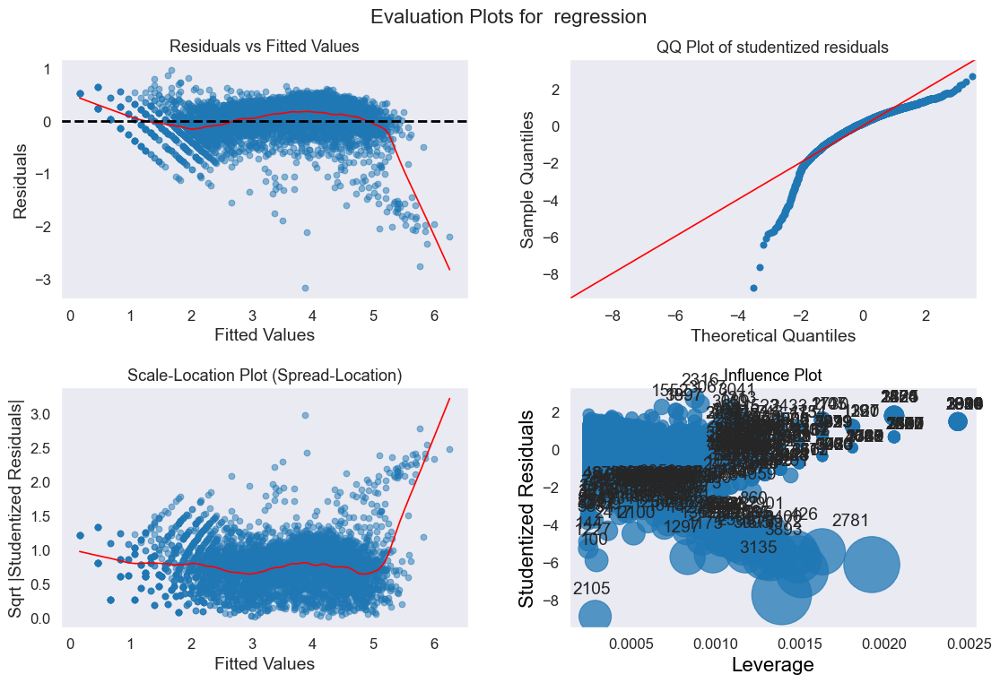

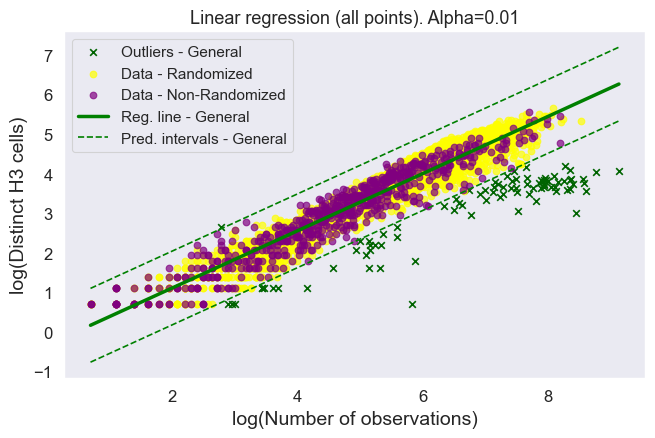

,vendor_name,macaddr_randomized,anonymized_macaddr,label_night,observations_user_night,timespan_minutes_night,num_distinct_h3_cells_night,observations_per_cell,observations_per_minute,minutes_per_cell,log_num_distinct_h3_cells_night,log_observations_user_night,log_timespan_minutes_night,outlier_lin_reg
860,None,1,706e9788b8778e0e0e1721341801f30a0702f687b6dea8...,1,3874,420.300000,66,58.696970,9.217226,6.368182,4.189655,8.262043,6.040969,yes
1773,None,1,e167ca417eee2f218221af3da4bbbbaf8c5b68b4d75f31...,1,2086,572.966667,65,32.092308,3.640700,8.814872,4.174387,7.643004,6.350828,yes
2901,None,1,706e9788b8778e0e0e1721341801f30a0702f687b6dea8...,2,4229,525.366667,60,70.483333,8.049616,8.756111,4.094345,8.349721,6.264096,yes
541,None,1,48722b33c64dbaa32ebd81861878355eba4ccb24ae6ed9...,1,1726,338.266667,59,29.254237,5.102483,5.733333,4.077537,7.453562,5.823835,yes
2781,Intel Corporate,0,6188c61f71be2dff3145c032db8ec338f32ee5b6118440...,2,9176,678.200000,58,158.206897,13.529932,11.693103,4.060443,9.124347,6.519442,yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3798,None,1,dbcfa4d3502e2fb5f98386ffc7546737d4b4e6868a17ec...,2,8,132.600000,2,4.000000,0.060332,66.300000,0.693147,2.079442,4.887337,no
3840,"Apple, Inc.",0,e1cd0e2b0c4e9320cdd6fc4978f173a8320ffcd478a30f...,2,3,245.516667,2,1.500000,0.012219,122.758333,0.693147,1.098612,5.503365,no
3880,None,1,e6a8a867ea51c9fcc4ea0e24ad784a03366b5f6b2b2645...,2,9,400.000000,2,4.500000,0.022500,200.000000,0.693147,2.197225,5.991465,no
3914,None,1,e983cb7a50cb1690ef1d2f5aaeae8c18a56a3d89b6afe9...,2,2,506.433333,2,1.000000,0.003949,253.216667,0.693147,0.693147,6.227393,no


In [148]:
outliers_logcells_vs_logobs_all = outliers_linear_models(df_users_info=info_per_user_night_filtered_df,
                                                         x_variable='log_observations_user_night', y_variable='log_num_distinct_h3_cells_night',
                                                         reg_type = 'all points', alpha=0.01,
                                                         show_eval_metrics=True,
                                                         x_label='log(Number of observations)', 
                                                         y_label='log(Distinct H3 cells)').sort_values(by=['outlier_lin_reg','num_distinct_h3_cells_night'], ascending=[False,False])
outliers_logcells_vs_logobs_all

##### Separate regression (log-log)

Just for completeness, I also fit the log-log version of the regression for the two types of MAC address separately. However, this method is more strict with randomized users than with non-randomized elements, but from the visual inspection of these experiments, it seems that many of the non-randomized MAC addresses correspond to non-mobile devices from the organization (access points, laptops, POS terminals, etc.), while randomized MAC addressess observations seem reasonable for human mobile devices (smartphones and smartwatches).

--------------------------------------------------------------------
Regression assessment metrics for  regression:
                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.935
Model:                            OLS   Adj. R-squared:                  0.935
Method:                 Least Squares   F-statistic:                 4.861e+04
Date:               vi., 28 mar. 2025   Prob (F-statistic):               0.00
Time:                        19:17:28   Log-Likelihood:                -615.60
No. Observations:                3365   AIC:                             1235.
Df Residuals:                    3363   BIC:                             1247.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
---------------

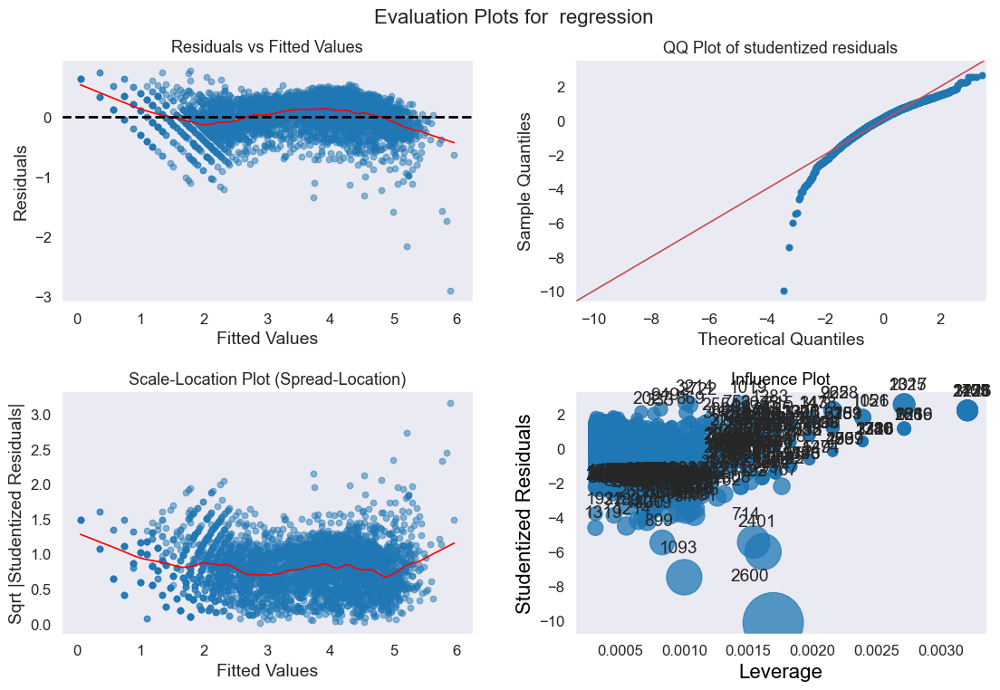

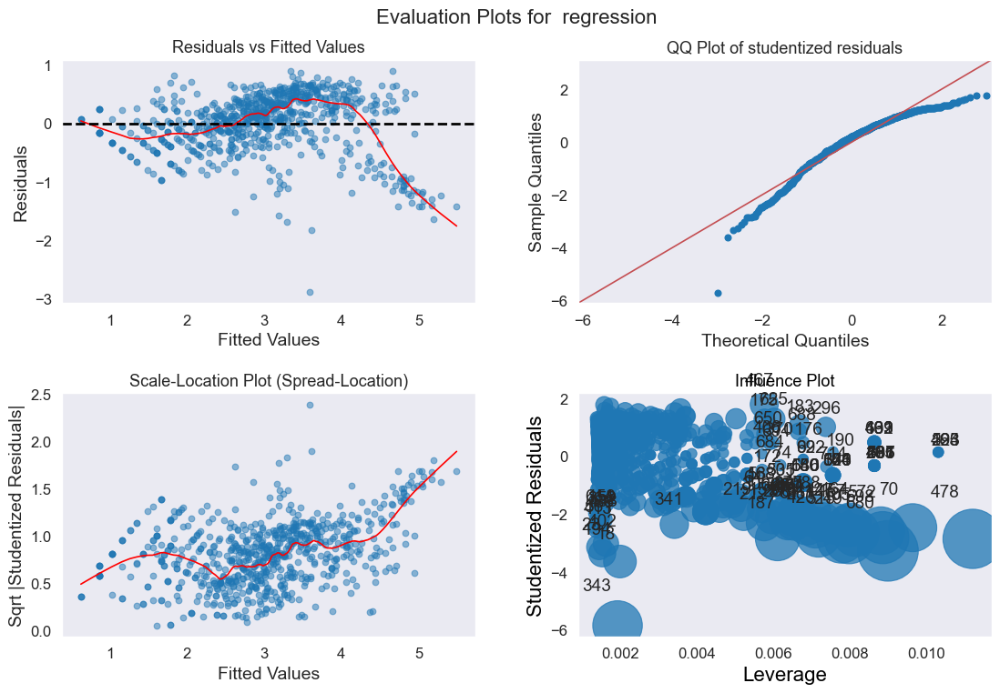

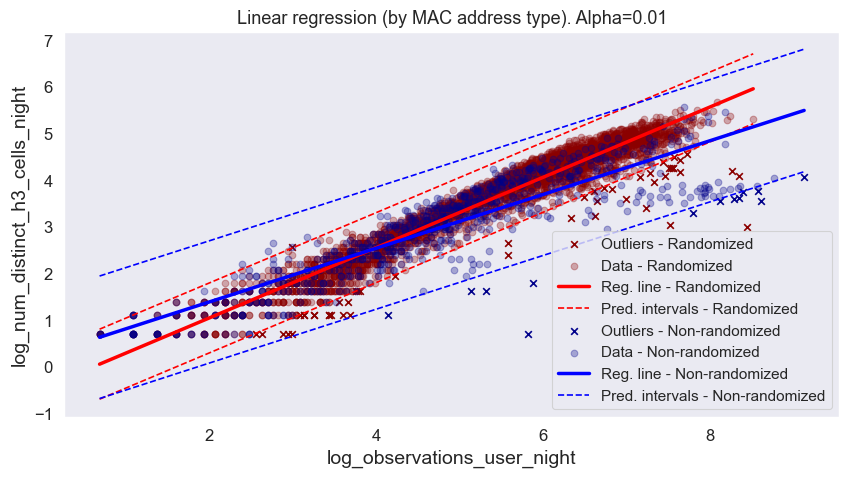

,vendor_name,macaddr_randomized,anonymized_macaddr,label_night,observations_user_night,timespan_minutes_night,num_distinct_h3_cells_night,observations_per_cell,observations_per_minute,minutes_per_cell,log_num_distinct_h3_cells_night,log_observations_user_night,log_timespan_minutes_night,outlier_lin_reg
2631,None,1,8e53058d12d790baa174f13af5e26f86c7cad4532e534c...,2,2260,401.533333,96,23.541667,5.628424,4.182639,4.564348,7.723120,5.995291,yes
2564,None,1,864bf617a1fee1045be8494a9ee6dee4cff003a0ee4007...,2,1930,465.783333,89,21.685393,4.143557,5.233521,4.488636,7.565275,6.143721,yes
2190,None,1,50cce2a3a3379e56781491fc5eeadc05439c901093538b...,2,2070,479.766667,83,24.939759,4.314597,5.780321,4.418841,7.635304,6.173300,yes
2084,None,1,3f114b35544bbadcc766a530c6b890016263202cbb02e0...,2,1695,616.700000,80,21.187500,2.748500,7.708750,4.382027,7.435438,6.424383,yes
2500,None,1,7dc9b487263f130df317ca94d2275fc9d36fa38acfe471...,2,1831,680.266667,71,25.788732,2.691592,9.581221,4.262680,7.512618,6.522485,yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3951,Xiaomi Communications Co Ltd,0,b241f95765da6793edacf060aa33ecb274120855f64cbe...,2,5,152.633333,2,2.500000,0.032758,76.316667,0.693147,1.609438,5.028039,no
3956,"Huawei Device Co., Ltd.",0,b62920d69b7eb8502386c16011edd5cfd0302b20a1c0ad...,2,3,75.350000,2,1.500000,0.039814,37.675000,0.693147,1.098612,4.322144,no
4005,GUANGDONG OPPO MOBILE TELECOMMUNICATIONS CORP....,0,d221132d627ca58cc7cae627df93c141bb8fd702f6096a...,2,5,357.766667,2,2.500000,0.013976,178.883333,0.693147,1.609438,5.879881,no
4008,"Samsung Electronics Co.,Ltd",0,d3d1b2aa266b833b4dbed74c7cc0fe51f67695eae2e3bd...,2,4,376.650000,2,2.000000,0.010620,188.325000,0.693147,1.386294,5.931316,no


In [173]:
outliers_logcells_vs_logobs_split = outliers_linear_models(df_users_info=info_per_user_night_filtered_df,
                                                         x_variable='log_observations_user_night', y_variable='log_num_distinct_h3_cells_night',
                                                         reg_type = 'by MAC address type', alpha=0.01,
                                                         show_eval_metrics=True).sort_values(by=['outlier_lin_reg','num_distinct_h3_cells_night'], ascending=[False,False])
outliers_logcells_vs_logobs_split

##### Choosing the method

After the regressions, I manually searched about all the available vendors (on the internet) and identified some of them that are surely not related with smartphones nor smartwatches (more on that below).

In [174]:
print('Number of outliers found with the outliers_logcells_vs_logobs_all method:')
duckdb_conn.sql("""SELECT macaddr_randomized, vendor_name, COUNT(*) as outlier_count 
                FROM outliers_logcells_vs_logobs_all 
                WHERE outlier_lin_reg = 'yes'
                GROUP BY macaddr_randomized, vendor_name
                ORDER BY outlier_count DESC""")

Number of outliers found with the outliers_logcells_vs_logobs_all method:


┌────────────────────┬──────────────────────────────────────────────┬───────────────┐
│ macaddr_randomized │                 vendor_name                  │ outlier_count │
│       int64        │                   varchar                    │     int64     │
├────────────────────┼──────────────────────────────────────────────┼───────────────┤
│                  0 │ Shenzhen Xingguodu Technology Co., Ltd.      │            42 │
│                  1 │ NULL                                         │            21 │
│                  0 │ Intel Corporate                              │             7 │
│                  0 │ Earda Technologies co Ltd                    │             7 │
│                  0 │ Xiaomi Communications Co Ltd                 │             3 │
│                  0 │ CLOUD NETWORK TECHNOLOGY SINGAPORE PTE. LTD. │             2 │
│                  0 │ SAMSUNG ELECTRO-MECHANICS(THAILAND)          │             1 │
│                  0 │ Hewlett Packard                

In [175]:
print('Number of outliers found with the outliers_logcells_vs_logobs_split method:')
duckdb_conn.sql("""SELECT macaddr_randomized, vendor_name, COUNT(*) as outlier_count 
                FROM outliers_logcells_vs_logobs_split 
                WHERE outlier_lin_reg = 'yes'
                GROUP BY macaddr_randomized, vendor_name
                ORDER BY outlier_count DESC""")

Number of outliers found with the outliers_logcells_vs_logobs_split method:


┌────────────────────┬─────────────────────────────────────────┬───────────────┐
│ macaddr_randomized │               vendor_name               │ outlier_count │
│       int64        │                 varchar                 │     int64     │
├────────────────────┼─────────────────────────────────────────┼───────────────┤
│                  1 │ NULL                                    │            50 │
│                  0 │ Shenzhen Xingguodu Technology Co., Ltd. │             8 │
│                  0 │ Intel Corporate                         │             4 │
│                  0 │ Earda Technologies co Ltd               │             1 │
└────────────────────┴─────────────────────────────────────────┴───────────────┘

In [176]:
list_non_mobile_vendors = """('Shenzhen Xingguodu Technology Co., Ltd.', -- POS terminals
                            'Earda Technologies co Ltd', -- smart light switches
                            'Intel Corporate', -- apparantely do not work with smartphones
                            'Hewlett Packard', -- apparantely do not work with smartphones
                            'Ruckus Wireless', -- enterprise wireless infrastructure (e.g., Wi-Fi access points, routers)
                            'D-Link International', -- Smart home security cameras, smart plugs, Wi-Fi routers and range extenders to Enterprise grade networking, wireless LAN and surveillance solutions.
                            'Ubiquiti Inc', -- network infrastructure (e.g., routers, Wi-Fi access points)
                            )"""

I choose the **log-log regression with all the data** because, as mentioned before, it is better for identifying those kind of MAC addresses, that probably correspond to rather static devices from the Fira or some of the workers of the festival. 

Also, based on the previous explanation, I specifically remove any of the MAC addresses that correspond to the companies that are highly unlikely to be related to smartphones or smartwatches but could have been left in the dataset after the outlier detection.

Applying the outlier removal and the filter by the non--mobile related vendors.

In [177]:
print('MAC address count pre-outlier removal')
duckdb_conn.sql("""
                SELECT macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                FROM info_per_user_night_filtered_df
                GROUP BY macaddr_randomized

                UNION ALL

                SELECT 'Total' AS macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                FROM info_per_user_night_filtered_df
                """)

MAC address count pre-outlier removal


┌────────────────────┬───────────────────┐
│ macaddr_randomized │ unique_user_count │
│      varchar       │       int64       │
├────────────────────┼───────────────────┤
│ 1                  │              2382 │
│ 0                  │               554 │
│ Total              │              2936 │
└────────────────────┴───────────────────┘

In [178]:
info_per_user_night_filter_outliers = duckdb_conn.sql(F"""
                                                SELECT *
                                                FROM outliers_logcells_vs_logobs_all
                                                WHERE outlier_lin_reg = 'no'
                                                    AND (vendor_name NOT IN {list_non_mobile_vendors} OR vendor_name IS NULL)
                                                """) 

Checking the counts after the outliers and non-mobile vendors removal.

In [179]:
locations_night_filtered = duckdb_conn.sql("""
                                            SELECT ln.*
                                            FROM locations_night_filtered ln
                                            JOIN info_per_user_night_filter_outliers iun
                                                ON ln.macaddr_randomized = iun.macaddr_randomized
                                                    AND ln.anonymized_macaddr = iun.anonymized_macaddr
                                                    AND ln.label_night = iun.label_night
                                             """)

print(f'Number of records Sónar by night (after outlier and non-mobile vendor removal):')
display(duckdb_conn.sql("""
                        SELECT macaddr_randomized, COUNT(*) AS total_records
                        FROM locations_night_filtered
                        GROUP BY macaddr_randomized

                        UNION ALL

                        SELECT 'Total' AS macaddr_randomized, COUNT(*) AS total_records
                        FROM locations_night_filtered
                        """))


print(f'Unique macadresses Sónar by night (after outlier and non-mobile vendor removal):')
display(duckdb_conn.sql("""
                        SELECT macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                        FROM locations_night_filtered
                        GROUP BY macaddr_randomized

                        UNION ALL

                        SELECT 'Total' AS macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                        FROM locations_night_filtered
                        """))

Number of records Sónar by night (after outlier and non-mobile vendor removal):


┌────────────────────┬───────────────┐
│ macaddr_randomized │ total_records │
│      varchar       │     int64     │
├────────────────────┼───────────────┤
│ 0                  │        155588 │
│ 1                  │       1439424 │
│ Total              │       1595012 │
└────────────────────┴───────────────┘

Unique macadresses Sónar by night (after outlier and non-mobile vendor removal):


┌────────────────────┬───────────────────┐
│ macaddr_randomized │ unique_user_count │
│      varchar       │       int64       │
├────────────────────┼───────────────────┤
│ 0                  │               477 │
│ 1                  │              2373 │
│ Total              │              2850 │
└────────────────────┴───────────────────┘

In [180]:
del info_per_user_night_filtered_df

#### Filtering extreme observations values

In [181]:
info_per_user_night_filter_outliers_df = info_per_user_night_filter_outliers.to_df()

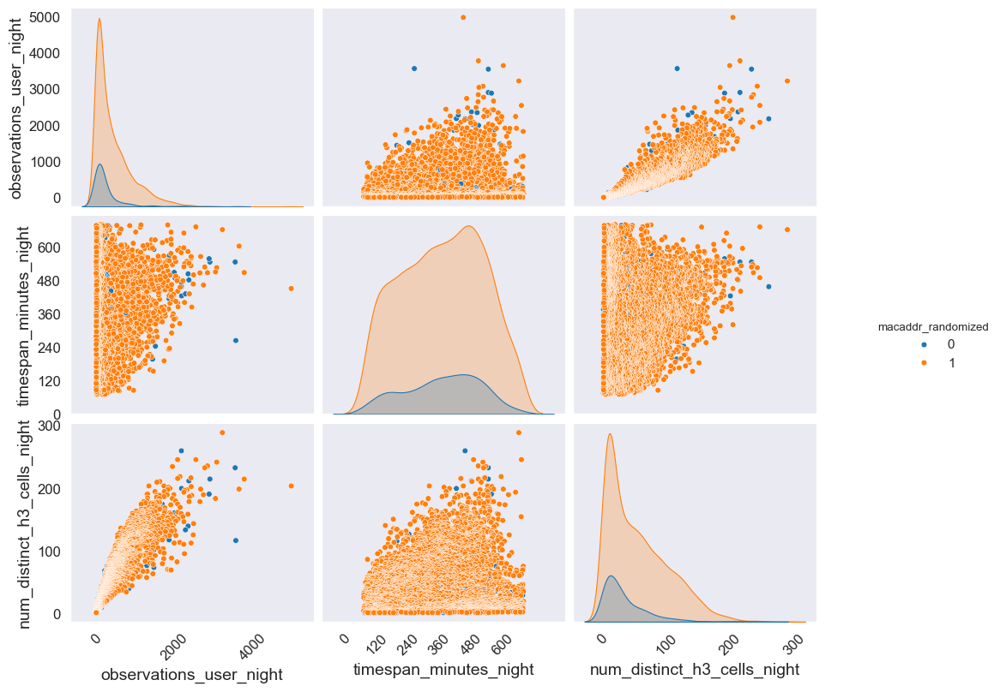

In [182]:
plot_pairplot(info_per_user_night_filter_outliers_df, filename_to_save=None)
#filename_to_save='night_pairplot_filter_outliers_and_vendors.png'

The observations and the distinct cells distributions still have a high density in the first part of the distribution but have a wide range of values. Based on this observation and the regression results, it may be useful to visualize these variables with a logarithmic scale.

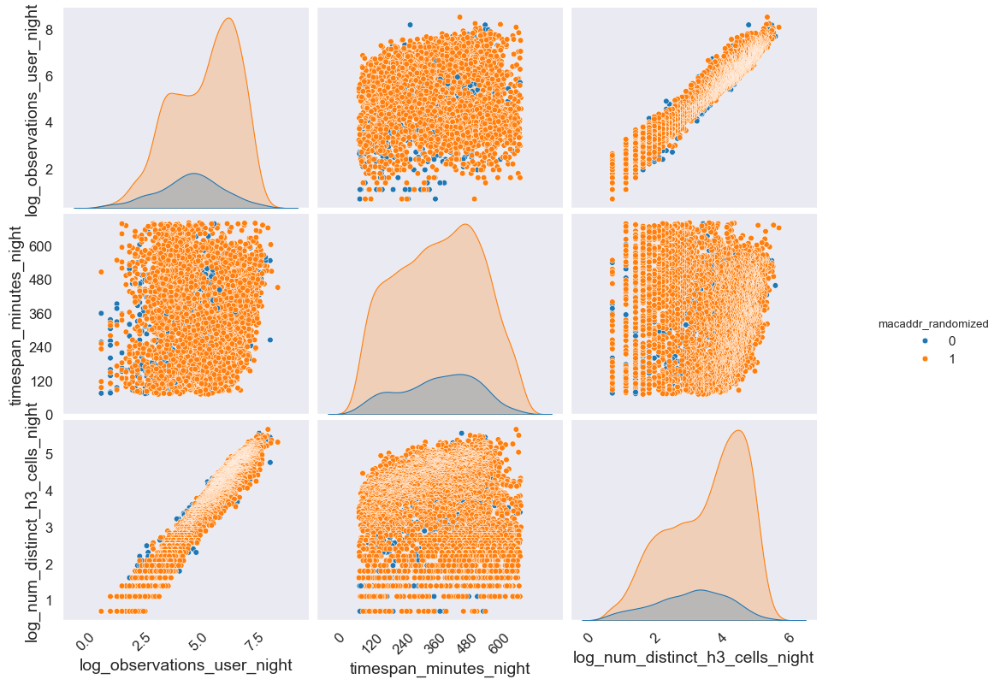

In [183]:
plot_pairplot(info_per_user_night_filter_outliers_df, columns=['log_observations_user_night', 'timespan_minutes_night', 'log_num_distinct_h3_cells_night','macaddr_randomized'],
              filename_to_save=None)
#filename_to_save='night_pairplot_filter_outliers_and_vendors_log.png'

This way, it is easier to visualize the range of values of those two variables. In the two, there is a bimodality in the randomized users, while non-randomized MAC addresses have a bell-like shape. Continuing the logic used for the regressions, I want to treat both groups (randomized and non-randomized) as a single one, even though their densities look different. The reason for this is to try to identify extreme values overall and treat the resulting MAC addresses as "users". In any case, the clustering algorithms should be able to identify relevant patterns and noise in the subsequent steps.

In [184]:
# Creating a violin plot
fig = px.violin(
    info_per_user_night_filter_outliers_df,
    x='label_night',
    y='log_observations_user_night',
    #color='macaddr_randomized',  
    box=True,  
    points='outliers',  
    title=f'Distribution of observations per user (Sónar by night). Filtered with outliers and non-mobile vendors',
    category_orders={"macaddr_randomized": [0, 1]})

# Updating the layout
fig.update_layout(
    xaxis_title='Night of the festival',
    yaxis_title='log(Observations by TID)',
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14)

fig.show()
#fig.write_html(os.path.join(path_interactive_plots,'night_observations_violin_filter_outliers.html'))

In [185]:
# Creating a histogram
fig = px.histogram(
    info_per_user_night_filter_outliers_df,
    x="log_observations_user_night",
    #color="macaddr_randomized",
    facet_row="label_night",
    nbins=100,
    title=f"Distribution of observations per user (Sónar by night). Filtered with outliers",
    category_orders={"macaddr_randomized": [0, 1]})

# Updating the layout
fig.update_layout(
    xaxis_title="log(Observations by TID)",
    yaxis_title="Users",
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14)

# Showing the plot
fig.show()
#fig.write_html(os.path.join(path_interactive_plots,'day_observations_hist_filter_outliers.html'))

Checking where the percentiles fall with respect to the logarithmic scale. I also check the equivalent value in the original scale.

Note: as the percentiles are based on the rank (ordering) of the data, changing the scale does not change the relative values of the percentiles.

In [186]:
print('Log-observations per user Sónar by night (filtered with the outliers and non-mobile vendors):')
log_observations_percentiles_no_outliers_night = duckdb_conn.query("""
                                                                  SELECT 
                                                                    MIN(log_observations_user_night) AS min_conf_f,
                                                                    PERCENTILE_CONT(0.025) WITHIN GROUP(ORDER BY log_observations_user_night) AS p025_observations_user,
                                                                    PERCENTILE_CONT(0.05) WITHIN GROUP(ORDER BY log_observations_user_night) AS p05_observations_user,
                                                                    PERCENTILE_CONT(0.10) WITHIN GROUP(ORDER BY log_observations_user_night) AS p10_observations_user,
                                                                    PERCENTILE_CONT(0.25) WITHIN GROUP(ORDER BY log_observations_user_night) AS p25_observations_user,
                                                                    PERCENTILE_CONT(0.50) WITHIN GROUP(ORDER BY log_observations_user_night) AS median_observations_user,
                                                                    PERCENTILE_CONT(0.75) WITHIN GROUP(ORDER BY log_observations_user_night) AS p75_observations_user,
                                                                    PERCENTILE_CONT(0.90) WITHIN GROUP(ORDER BY log_observations_user_night) AS p90_observations_user,
                                                                    PERCENTILE_CONT(0.95) WITHIN GROUP(ORDER BY log_observations_user_night) AS p95_observations_user,
                                                                    MAX(log_observations_user_night) AS max_observations_user
                                                                  FROM info_per_user_night_filter_outliers_df""")
log_observations_percentiles_no_outliers_night

Log-observations per user Sónar by night (filtered with the outliers and non-mobile vendors):


┌────────────────────┬────────────────────────┬───────────────────────┬───────────────────────┬───────────────────────┬──────────────────────────┬───────────────────────┬───────────────────────┬───────────────────────┬───────────────────────┐
│     min_conf_f     │ p025_observations_user │ p05_observations_user │ p10_observations_user │ p25_observations_user │ median_observations_user │ p75_observations_user │ p90_observations_user │ p95_observations_user │ max_observations_user │
│       double       │         double         │        double         │        double         │        double         │          double          │        double         │        double         │        double         │        double         │
├────────────────────┼────────────────────────┼───────────────────────┼───────────────────────┼───────────────────────┼──────────────────────────┼───────────────────────┼───────────────────────┼───────────────────────┼───────────────────────┤
│ 0.6931471805599453 │     2

In [187]:
print('Observations per user Sónar by night (filtered with the outliers and non-mobile vendors):')
duckdb_conn.query("""
                  SELECT
                    MIN(observations_user_night) AS min_observations_user,
                    PERCENTILE_CONT(0.025) WITHIN GROUP(ORDER BY observations_user_night) AS p025_observations_user,
                    PERCENTILE_CONT(0.05) WITHIN GROUP(ORDER BY observations_user_night) AS p05_observations_user,
                    PERCENTILE_CONT(0.10) WITHIN GROUP(ORDER BY observations_user_night) AS p10_observations_user,
                    PERCENTILE_CONT(0.25) WITHIN GROUP(ORDER BY observations_user_night) AS p25_observations_user,
                    PERCENTILE_CONT(0.50) WITHIN GROUP(ORDER BY observations_user_night) AS median_observations_user,
                    PERCENTILE_CONT(0.75) WITHIN GROUP(ORDER BY observations_user_night) AS p75_observations_user,
                    PERCENTILE_CONT(0.90) WITHIN GROUP(ORDER BY observations_user_night) AS p90_observations_user,
                    PERCENTILE_CONT(0.95) WITHIN GROUP(ORDER BY observations_user_night) AS p95_observations_user,
                    MAX(observations_user_night) AS max_observations_user
                  FROM info_per_user_night_filter_outliers_df""")

Observations per user Sónar by night (filtered with the outliers and non-mobile vendors):


┌───────────────────────┬────────────────────────┬───────────────────────┬───────────────────────┬───────────────────────┬──────────────────────────┬───────────────────────┬───────────────────────┬───────────────────────┬───────────────────────┐
│ min_observations_user │ p025_observations_user │ p05_observations_user │ p10_observations_user │ p25_observations_user │ median_observations_user │ p75_observations_user │ p90_observations_user │ p95_observations_user │ max_observations_user │
│         int64         │         double         │        double         │        double         │        double         │          double          │        double         │        double         │        double         │         int64         │
├───────────────────────┼────────────────────────┼───────────────────────┼───────────────────────┼───────────────────────┼──────────────────────────┼───────────────────────┼───────────────────────┼───────────────────────┼───────────────────────┤
│               

I check how the MAC addresses below the p025 of observations look (for both randomized and non-randomized addresses).

In [188]:
users_few_observations = duckdb_conn.sql(f"""
                                            SELECT *
                                            FROM info_per_user_night_filter_outliers_df
                                            WHERE log_observations_user_night < (SELECT p025_observations_user FROM log_observations_percentiles_no_outliers_night)
                                        """)

In [189]:
users_few_observations.to_df().describe()

,macaddr_randomized,label_night,observations_user_night,timespan_minutes_night,num_distinct_h3_cells_night,observations_per_cell,observations_per_minute,minutes_per_cell,log_num_distinct_h3_cells_night,log_observations_user_night,log_timespan_minutes_night
count,97.000000,97.000000,97.000000,97.000000,97.000000,97.000000,97.000000,97.000000,97.000000,97.000000,97.000000
mean,0.670103,1.494845,5.340206,278.243986,2.721649,2.031787,0.026606,103.896306,0.960135,1.594634,5.446352
std,0.472618,0.502571,1.962601,166.201738,0.813202,0.804707,0.018352,57.913516,0.283448,0.425725,0.618054
min,0.000000,1.000000,2.000000,74.600000,2.000000,1.000000,0.003949,28.783333,0.693147,0.693147,4.312141
25%,0.000000,1.000000,4.000000,138.866667,2.000000,1.500000,0.012219,55.891667,0.693147,1.386294,4.933514
50%,1.000000,1.000000,5.000000,236.733333,3.000000,2.000000,0.021797,91.516667,1.098612,1.609438,5.466934
75%,1.000000,2.000000,7.000000,363.116667,3.000000,2.500000,0.037175,135.208333,1.098612,1.945910,5.894724
max,1.000000,2.000000,8.000000,678.366667,5.000000,4.000000,0.092646,274.225000,1.609438,2.079442,6.519688


Removing the values below the from the p025 as a way to avoid losing too much data, but excluding meaningless too-short trajectories (with too few observations). I tried removing outliers with the Tukey's method on both the logarithmic scale and the original scale, but the former just removes trajectories with less that 3 observations, while the latter only removes points with many observations, which might still provide valuable information (again, the clustering algorithms should be able to detect noise if necessary).

In [190]:
info_per_user_night_filter_extreme_obs = duckdb_conn.sql("""
                                                    SELECT *
                                                    FROM info_per_user_night_filter_outliers_df
                                                    WHERE log_observations_user_night >= (SELECT p025_observations_user FROM log_observations_percentiles_no_outliers_night)
                                                    """).to_df()


Checking the new filtered distribution.

In [191]:
# Creating a violin plot
fig = px.violin(
    info_per_user_night_filter_extreme_obs,
    x='label_night',
    y='log_observations_user_night',
    #color='macaddr_randomized',  
    box=True,  
    points='outliers',  
    title=f'Distribution of observations per user (Sónar by night). Filtered with outliers and non-mobile vendors',
    category_orders={"macaddr_randomized": [0, 1]})

# Updating the layout
fig.update_layout(
    xaxis_title='Night of the festival',
    yaxis_title='log(Observations by TID)',
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14)

fig.show()
#fig.write_html(os.path.join(path_interactive_plots,'night_observations_violin_filter_outliers.html'))

This would be the final, filtered dataset for Sónar by Night, so I apply the changes.

In [192]:
locations_night_filtered = duckdb_conn.sql("""
                                            SELECT ln.*
                                            FROM locations_night_filtered ln
                                            JOIN info_per_user_night_filter_extreme_obs iun
                                                ON ln.macaddr_randomized = iun.macaddr_randomized
                                                    AND ln.anonymized_macaddr = iun.anonymized_macaddr
                                                    AND ln.label_night = iun.label_night
                                             """)

print(f'Number of records Sónar by night (after extremely sparse trajectories removal):')
display(duckdb_conn.sql("""
                        SELECT macaddr_randomized, COUNT(*) AS total_records
                        FROM locations_night_filtered
                        GROUP BY macaddr_randomized

                        UNION ALL

                        SELECT 'Total' AS macaddr_randomized, COUNT(*) AS total_records
                        FROM locations_night_filtered
                        """))


print(f'Unique macadresses Sónar by night (after extremely sparse trajectories removal):')
display(duckdb_conn.sql("""
                        SELECT macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                        FROM locations_night_filtered
                        GROUP BY macaddr_randomized

                        UNION ALL

                        SELECT 'Total' AS macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                        FROM locations_night_filtered
                        """))

Number of records Sónar by night (after extremely sparse trajectories removal):


┌────────────────────┬───────────────┐
│ macaddr_randomized │ total_records │
│      varchar       │     int64     │
├────────────────────┼───────────────┤
│ 0                  │        155437 │
│ 1                  │       1439057 │
│ Total              │       1594494 │
└────────────────────┴───────────────┘

Unique macadresses Sónar by night (after extremely sparse trajectories removal):


┌────────────────────┬───────────────────┐
│ macaddr_randomized │ unique_user_count │
│      varchar       │       int64       │
├────────────────────┼───────────────────┤
│ 0                  │               453 │
│ 1                  │              2342 │
│ Total              │              2795 │
└────────────────────┴───────────────────┘

In [193]:
info_per_user_night_filter_extreme_obs.describe()

,macaddr_randomized,label_night,observations_user_night,timespan_minutes_night,num_distinct_h3_cells_night,observations_per_cell,observations_per_minute,minutes_per_cell,log_num_distinct_h3_cells_night,log_observations_user_night,log_timespan_minutes_night
count,3846.000000,3846.000000,3846.000000,3846.000000,3846.000000,3846.000000,3846.000000,3846.000000,3846.000000,3846.000000,3846.000000
mean,0.852574,1.514041,414.585023,373.033125,53.464639,6.366742,1.262254,21.097490,3.500647,5.257833,5.811181
std,0.354576,0.499868,493.037790,153.971091,46.454812,3.030468,1.401463,30.412367,1.087135,1.378958,0.509676
min,0.000000,1.000000,9.000000,71.166667,2.000000,1.222222,0.013799,0.983716,0.693147,2.197225,4.265025
25%,1.000000,1.000000,63.250000,248.995833,14.000000,4.414277,0.173859,3.748632,2.639057,4.147072,5.517436
50%,1.000000,2.000000,226.000000,381.441667,40.000000,5.586538,0.740750,7.793672,3.688879,5.420535,5.943958
75%,1.000000,2.000000,596.000000,494.845833,82.000000,7.650510,1.942738,25.970486,4.406719,6.390241,6.204246
max,1.000000,2.000000,4990.000000,681.883333,289.000000,30.538462,13.510209,269.866667,5.666427,8.515191,6.524859


- Raw final disributions:

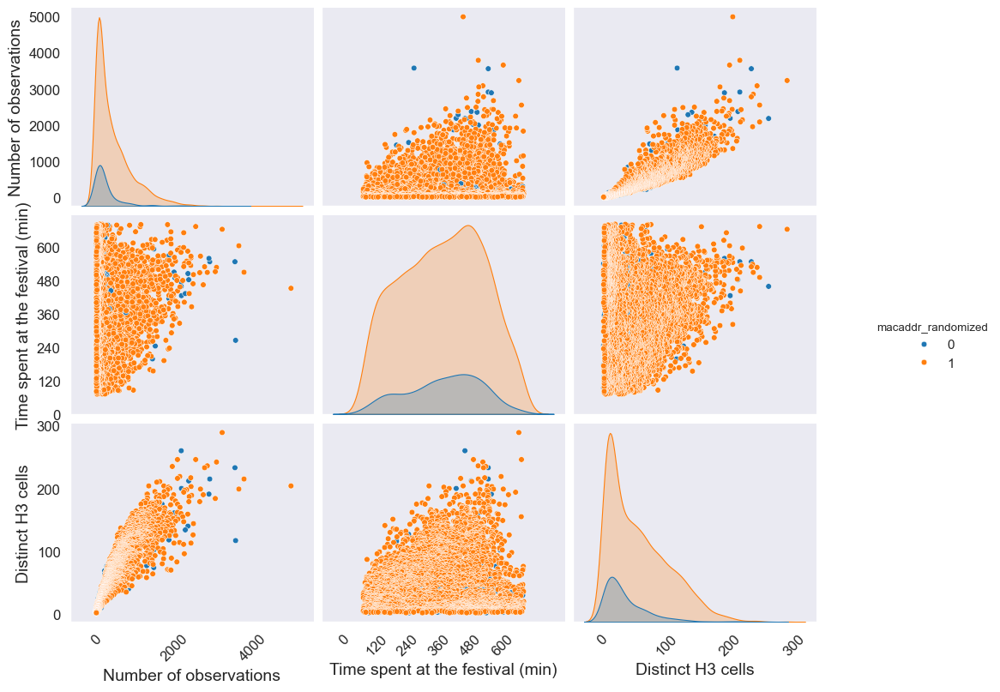

In [194]:
custom_labels = {
    'observations_user_night': 'Number of observations',
    'timespan_minutes_night': 'Time spent at the festival (min)',
    'num_distinct_h3_cells_night': 'Distinct H3 cells',
}

plot_pairplot(info_per_user_night_filter_extreme_obs, custom_labels=custom_labels)

- log-transformed final distributions:

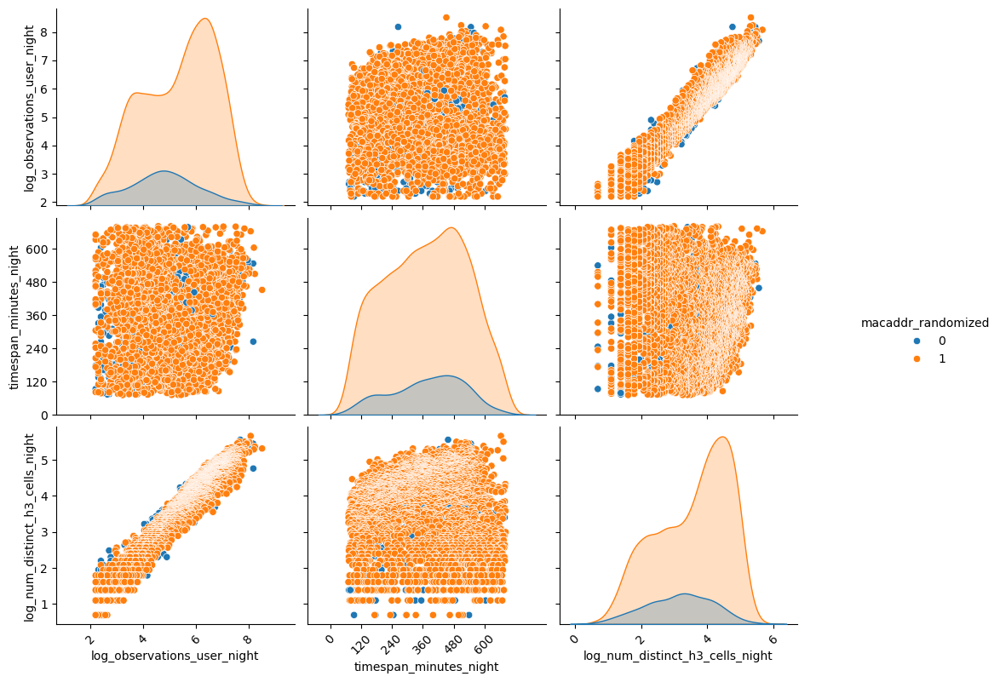

In [141]:
plot_pairplot(info_per_user_night_filter_extreme_obs, columns=['log_observations_user_night', 'timespan_minutes_night', 'log_num_distinct_h3_cells_night','macaddr_randomized'])

#### Removing duplicates (first time)

In [142]:
# Checking the count without filtering
pre_duplicate_filter_count_night = duckdb_conn.sql("""
                                                    SELECT COUNT(*)
                                                    FROM locations_night_filtered
                                                    """).fetchone()[0]
print(f'Before removing duplicates, there are {pre_duplicate_filter_count_night} observations')

Before removing duplicates, there are 1594494 observations


In [143]:
locations_night_filtered.columns

['anonymized_macaddr',
 'macaddr_randomized',
 'timestamp_ap',
 'h3_cell',
 'client_latitude',
 'client_longitude',
 'timestamp_wizzie',
 'location_name',
 'slug',
 'rssi',
 'confidence_factor',
 'vendor_name',
 'sonar_type',
 'label_night',
 'observations_user_night',
 'timespan_minutes_night',
 'num_distinct_h3_cells_night']

In [144]:
# Checking the duplicates taking every column of interest into account
distinct_all_columns_night = duckdb_conn.sql("""
                                            SELECT DISTINCT 
                                                            anonymized_macaddr, macaddr_randomized,
                                                            timestamp_ap, 
                                                            h3_cell, client_latitude, client_longitude,
                                                            timestamp_wizzie,
                                                            location_name, slug,
                                                            rssi,
                                                            confidence_factor,
                                                            vendor_name
                                                        FROM locations_night_filtered""")

distinct_all_columns_night_count = duckdb_conn.sql("SELECT COUNT(*) FROM distinct_all_columns_night").fetchone()[0]

print(f'There are {pre_duplicate_filter_count_night - distinct_all_columns_night_count} duplicates, considering all columns of interest (both timestamp_ap and timestamp_wizzie)')

There are 182 duplicates, considering all columns of interest (both timestamp_ap and timestamp_wizzie)


In [145]:
del distinct_all_columns_night_count, distinct_all_columns_night

As mentioned in `2. preprocessing_dataset_reduction.ipynb`, according to what I was told, there is a difference between timestamp_wizzie (the time when the observation was received by the Wizzie system) and timestamp_ap (the time when the observation was received by the access point (AP)). There is a difference between the two, which is usually small, but not always (check the plot in the interactive plots folder).

I checked, and considering timestamp_wizzie instead of timestamp_ap would result in more duplicates, that would probably be associated with lags in the system, not actual duplicates. For this reason, it is safer to use timestamp_ap.

In [146]:
# Checking the duplicates if I consider timestamp_ap
duckdb_conn.sql("""
    SELECT *,
            COUNT(*) OVER (PARTITION BY 
                                anonymized_macaddr, macaddr_randomized,
                                                        timestamp_ap, 
                                                        h3_cell, client_latitude, client_longitude,
                                                        location_name, slug,
                                                        rssi,
                                                        confidence_factor,
                                                        vendor_name
                            ) AS duplicate_count
    FROM locations_night_filtered
    ORDER BY duplicate_count desc""")

┌──────────────────────────────────────────────────────────────────┬────────────────────┬──────────────┬─────────────────┬────────────────────┬───────────────────┬──────────────────┬────────────────┬─────────┬────────┬───────────────────┬─────────────┬─────────────┬─────────────┬─────────────────────────┬────────────────────────┬─────────────────────────────┬─────────────────┐
│                        anonymized_macaddr                        │ macaddr_randomized │ timestamp_ap │     h3_cell     │  client_latitude   │ client_longitude  │ timestamp_wizzie │ location_name  │  slug   │  rssi  │ confidence_factor │ vendor_name │ sonar_type  │ label_night │ observations_user_night │ timespan_minutes_night │ num_distinct_h3_cells_night │ duplicate_count │
│                             varchar                              │       int64        │    int64     │     varchar     │       double       │      double       │      int64       │    varchar     │ varchar │ double │      double       │  

Also, it is worth mentioning that in reality, a person should only be at a given moment in a single place, so I can check how duplicates based on that criterion look:

In [147]:
duckdb_conn.sql("""
    SELECT *,
            COUNT(*) OVER (PARTITION BY 
                                anonymized_macaddr, macaddr_randomized,
                                timestamp_ap
                            ) AS duplicate_count
    FROM locations_night_filtered
    ORDER BY duplicate_count desc""")

┌──────────────────────────────────────────────────────────────────┬────────────────────┬──────────────┬─────────────────┬────────────────────┬───────────────────┬──────────────────┬────────────────┬─────────┬────────┬───────────────────┬──────────────────────────────┬─────────────┬─────────────┬─────────────────────────┬────────────────────────┬─────────────────────────────┬─────────────────┐
│                        anonymized_macaddr                        │ macaddr_randomized │ timestamp_ap │     h3_cell     │  client_latitude   │ client_longitude  │ timestamp_wizzie │ location_name  │  slug   │  rssi  │ confidence_factor │         vendor_name          │ sonar_type  │ label_night │ observations_user_night │ timespan_minutes_night │ num_distinct_h3_cells_night │ duplicate_count │
│                             varchar                              │       int64        │    int64     │     varchar     │       double       │      double       │      int64       │    varchar     │ varcha

As I do not have a clear criterion to decide which observation to keep (I do not have the description of confidence_factor -and it tends to be the same-, and I don't know for sure how the rssi strength translates into the precision of the observation), I will just drop duplicates based on the other columns and order by rssi in descending order.

This way, the duplicate removal will be done with the filtering steps of the trajectory preprocessing afterwards, as the noise filtering takes into account the spatial plausibility of subsequent points (it does not allow "impossible" speeds) and the trajectory compression reduces exact copies to one point.

In [148]:
locations_night_filtered = duckdb_conn.sql("""
                                        SELECT DISTINCT ON (anonymized_macaddr, macaddr_randomized,
                                                            timestamp_ap, 
                                                            h3_cell, client_latitude, client_longitude,
                                                            location_name, slug,
                                                            rssi,
                                                            confidence_factor,
                                                            vendor_name
                                                            ) *
                                        FROM locations_night_filtered""")


locations_night_duplicate_filter_count = duckdb_conn.sql("""SELECT COUNT(*) FROM locations_night_filtered""").fetchone()[0]
print(f'There are {pre_duplicate_filter_count_night - locations_night_duplicate_filter_count} duplicates, considering all columns of interest except timestamp_wizzie')

There are 251 duplicates, considering all columns of interest except timestamp_wizzie


Applying the update on the locations table

In [149]:
print(f'Number of records Sónar by night (after removing duplicates):')
display(duckdb_conn.sql("""
                        SELECT macaddr_randomized, COUNT(*) AS total_records
                        FROM locations_night_filtered
                        GROUP BY macaddr_randomized

                        UNION ALL

                        SELECT 'Total' AS macaddr_randomized, COUNT(*) AS total_records
                        FROM locations_night_filtered
                        """))


print(f'Unique macadresses Sónar by night (after removing duplicates):')
display(duckdb_conn.sql("""
                        SELECT macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                        FROM locations_night_filtered
                        GROUP BY macaddr_randomized

                        UNION ALL

                        SELECT 'Total' AS macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                        FROM locations_night_filtered
                        """))

Number of records Sónar by night (after removing duplicates):


┌────────────────────┬───────────────┐
│ macaddr_randomized │ total_records │
│      varchar       │     int64     │
├────────────────────┼───────────────┤
│ 1                  │       1438812 │
│ 0                  │        155431 │
│ Total              │       1594243 │
└────────────────────┴───────────────┘

Unique macadresses Sónar by night (after removing duplicates):


┌────────────────────┬───────────────────┐
│ macaddr_randomized │ unique_user_count │
│      varchar       │       int64       │
├────────────────────┼───────────────────┤
│ 0                  │               453 │
│ 1                  │              2342 │
│ Total              │              2795 │
└────────────────────┴───────────────────┘

#### Final heatmap

In [306]:
records_per_cell_final_table_night = duckdb_conn.sql("""SELECT h3_cell, COUNT(*) AS counts_per_cell
                                                            FROM locations_night_filtered
                                                            GROUP BY h3_cell""").to_df()

records_per_cell_final_table_night = h3_cells_night_lookup_shp.merge(records_per_cell_final_table_night,
                                                                    how='inner',
                                                                    on='h3_cell')

In [308]:
utils.plot_counts_per_cell(sonar_type='night', h3_cells_counts=records_per_cell_final_table_night,
                           caption=f"Observation count per H3 Cell (users with a few osbervations)",
                           filename_to_save=None)
#filename_to_save=os.path.join(path_interactive_plots,r'folium_maps\night_heatmap_obs_fully_filtered.html')

In [152]:
del records_per_cell_final_table_night

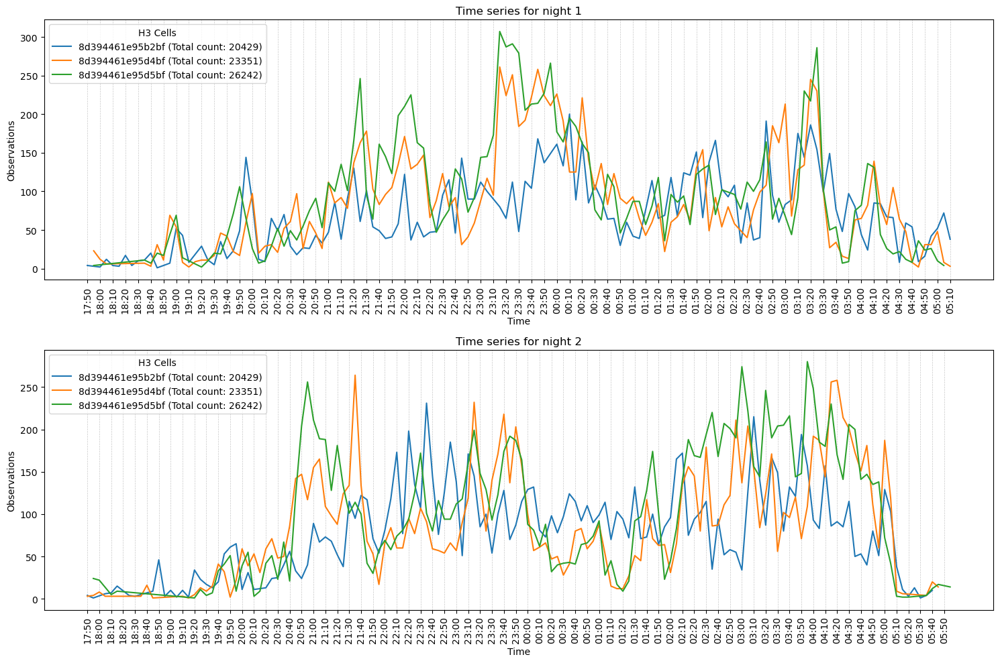

In [153]:
# I execute the code for plotting the time series of the cells after the data cleaning
plot_cells_time_series(sonar_type='night', num_cells=3)

### Exploring by night of the festival

#### Exploring night 1

In [154]:
print('Maximum and minimum timestamps (AP) for night 1:')
duckdb_conn.query("""SELECT TO_TIMESTAMP(min(timestamp_ap)), TO_TIMESTAMP(max(timestamp_ap)) 
                  FROM locations_night_filtered
                  WHERE label_night=1""")

Maximum and minimum timestamps (AP) for night 1:


┌─────────────────────────────────┬─────────────────────────────────┐
│ to_timestamp(min(timestamp_ap)) │ to_timestamp(max(timestamp_ap)) │
│    timestamp with time zone     │    timestamp with time zone     │
├─────────────────────────────────┼─────────────────────────────────┤
│ 2024-06-14 19:50:00+02          │ 2024-06-15 07:59:44+02          │
└─────────────────────────────────┴─────────────────────────────────┘

In [155]:
print('Number of records for night 1:')
duckdb_conn.query("""SELECT COUNT(*) AS total_records
                  FROM locations_night_filtered
                  WHERE label_night=1""")

Number of records for night 1:


┌───────────────┐
│ total_records │
│     int64     │
├───────────────┤
│        744481 │
└───────────────┘

In [156]:
print('Unique macadresses night 1:')
duckdb_conn.query("""
                  SELECT macaddr_randomized, 
                        COUNT(DISTINCT anonymized_macaddr) AS unique_macadress_count,
                        COUNT(DISTINCT anonymized_macaddr) * 100.0 / (SUM(COUNT(DISTINCT anonymized_macaddr)) OVER ()) AS unique_macadress_percentage
                  FROM locations_night_filtered
                  WHERE label_night=1
                  GROUP BY macaddr_randomized""")

Unique macadresses night 1:


┌────────────────────┬────────────────────────┬─────────────────────────────┐
│ macaddr_randomized │ unique_macadress_count │ unique_macadress_percentage │
│       int64        │         int64          │           double            │
├────────────────────┼────────────────────────┼─────────────────────────────┤
│                  0 │                    250 │           13.37613697164259 │
│                  1 │                   1619 │            86.6238630283574 │
└────────────────────┴────────────────────────┴─────────────────────────────┘

#### Exploring night 2

In [157]:
print('Maximum and minimum timestamps (AP) for night 2:')
duckdb_conn.query("""
                  SELECT TO_TIMESTAMP(min(timestamp_ap)), TO_TIMESTAMP(max(timestamp_ap)) 
                  FROM locations_night_filtered
                  WHERE label_night=2""")

Maximum and minimum timestamps (AP) for night 2:


┌─────────────────────────────────┬─────────────────────────────────┐
│ to_timestamp(min(timestamp_ap)) │ to_timestamp(max(timestamp_ap)) │
│    timestamp with time zone     │    timestamp with time zone     │
├─────────────────────────────────┼─────────────────────────────────┤
│ 2024-06-15 19:50:03+02          │ 2024-06-16 08:00:00+02          │
└─────────────────────────────────┴─────────────────────────────────┘

In [158]:
print('Number of records for night 2:')
duckdb_conn.query("""
                  SELECT COUNT(*) AS total_records
                  FROM locations_night_filtered
                  WHERE label_night=2""")

Number of records for night 2:


┌───────────────┐
│ total_records │
│     int64     │
├───────────────┤
│        849762 │
└───────────────┘

In [159]:
print('Unique macadresses night 2:')
duckdb_conn.query("""
                  SELECT macaddr_randomized, 
                        COUNT(DISTINCT anonymized_macaddr) AS unique_macadress_count,
                        COUNT(DISTINCT anonymized_macaddr) * 100.0 / (SUM(COUNT(DISTINCT anonymized_macaddr)) OVER ()) AS unique_macadress_percentage
                  FROM locations_night_filtered
                  WHERE label_night=2
                  GROUP BY macaddr_randomized""")

Unique macadresses night 2:


┌────────────────────┬────────────────────────┬─────────────────────────────┐
│ macaddr_randomized │ unique_macadress_count │ unique_macadress_percentage │
│       int64        │         int64          │           double            │
├────────────────────┼────────────────────────┼─────────────────────────────┤
│                  0 │                    317 │           16.03439554881133 │
│                  1 │                   1660 │           83.96560445118867 │
└────────────────────┴────────────────────────┴─────────────────────────────┘

## Exploring Sónar by day

In [160]:
print('Maximum and minimum timestamps (AP) for Sónar by day:')
duckdb_conn.sql("SELECT label_day, TO_TIMESTAMP(min(timestamp_ap)), TO_TIMESTAMP(max(timestamp_ap)) FROM locations_day GROUP BY label_day")

Maximum and minimum timestamps (AP) for Sónar by day:


┌───────────┬─────────────────────────────────┬─────────────────────────────────┐
│ label_day │ to_timestamp(min(timestamp_ap)) │ to_timestamp(max(timestamp_ap)) │
│   int32   │    timestamp with time zone     │    timestamp with time zone     │
├───────────┼─────────────────────────────────┼─────────────────────────────────┤
│         3 │ 2024-06-15 10:00:00+02          │ 2024-06-16 00:00:00+02          │
│         2 │ 2024-06-14 09:30:00+02          │ 2024-06-15 00:00:00+02          │
│         1 │ 2024-06-13 09:30:01+02          │ 2024-06-14 01:00:00+02          │
└───────────┴─────────────────────────────────┴─────────────────────────────────┘

In [161]:
print('Number of records Sónar by day (just after splitting):')
duckdb_conn.sql("""
                SELECT macaddr_randomized, COUNT(*) AS total_records
                FROM locations_day
                GROUP BY macaddr_randomized

                UNION ALL

                SELECT 'Total' AS macaddr_randomized, COUNT(*) AS total_records
                FROM locations_day
                """)

Number of records Sónar by day (just after splitting):


┌────────────────────┬───────────────┐
│ macaddr_randomized │ total_records │
│      varchar       │     int64     │
├────────────────────┼───────────────┤
│ 0                  │       1713507 │
│ 1                  │       5565037 │
│ Total              │       7278544 │
└────────────────────┴───────────────┘

In [162]:
print('Unique macadresses Sónar by day (just after splitting):')
duckdb_conn.sql("""
                SELECT macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                FROM locations_day
                GROUP BY macaddr_randomized

                UNION ALL

                SELECT 'Total' AS macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                FROM locations_day
                """)

Unique macadresses Sónar by day (just after splitting):


┌────────────────────┬───────────────────┐
│ macaddr_randomized │ unique_user_count │
│      varchar       │       int64       │
├────────────────────┼───────────────────┤
│ 0                  │              6211 │
│ 1                  │              3478 │
│ Total              │              9689 │
└────────────────────┴───────────────────┘

### Removing unrelated Fira locations

The `location_name` column contains no NULLs. By visually inspecting where the points fall geographically for each location, I can idendify the zones and filter points that are not related to the Sónar. I sample some points from each category and add them to the map corresponding festival (Sónar by Day and Sónar by Night).

In [163]:
# Executing the function (I prefer to save them in the folder to avoid overload in the notebook)
#plot_zones_map(sonar_type='day', save=False, return_map=False)

In [164]:
# Creating the list of the Fira locations that are not related with the Sónar
# it is created as a string to embed it in the SQL query
not_sonar_locations_day = """('567','AGORA',
                           'Oficinas planta baja_v2','Oficinas primera planta_v2','Oficinas segunda planta_v2')"""

Removing the observations in places not corresponding to the Sónar. I don't remove the users as they might have non valid observations, but they're a valid user.

I manually checked, and all the zones that are not within Sónar by night end with ".", which I labeled as "ends_with_point" when creating the `slug` column.

In [165]:
'''# If I wanted to include the zone close to Village VIP that is currently excluded with the polygon shape
locations_day_filtered2 = duckdb_conn.sql(f"""
                                     SELECT *
                                     FROM locations_day
                                     WHERE
                                          (location_name NOT IN {not_sonar_locations_day}
                                                AND slug <> 'ends_with_point')
                                        OR
                                          (location_name='Pl Univers')
                                     """)'''


locations_day_filtered = duckdb_conn.sql(f"""
                                     SELECT *
                                     FROM locations_day
                                     WHERE location_name NOT IN {not_sonar_locations_day}
                                        AND slug <> 'ends_with_point'
                                     """)



In [166]:
print('Distinct filtered locations in Sónar by day')
duckdb_conn.sql(f"""SELECT DISTINCT location_name, slug FROM locations_day_filtered""")

Distinct filtered locations in Sónar by day


┌────────────────────┬─────────┐
│   location_name    │  slug   │
│      varchar       │ varchar │
├────────────────────┼─────────┤
│ Exhibition Level 0 │ 001Q    │
│ Pl Univers         │ 001W    │
│ Exhibition Level 0 │ 001P    │
│ Ground Floor       │ 001N    │
│ Pl Univers         │ 001G    │
│ Ground Floor       │ 001L    │
│ Pl Univers         │ 001F    │
│ Ground Floor       │ 001M    │
│ Pl Univers         │ 001V    │
│ Ground Floor       │ 001X    │
│ Exhibition Level 0 │ 001Z    │
│ Ground Floor       │ 001I    │
│ Ground Floor       │ 001K    │
│ Nivel 1            │ 001U    │
│ Nivel 1            │ 001Y    │
│ Nivel 2            │ 001S    │
├────────────────────┴─────────┤
│ 16 rows            2 columns │
└──────────────────────────────┘

In [167]:
print('Total records after filtering unrelated zones (Sónar by Day).')

duckdb_conn.sql("""
                SELECT macaddr_randomized, COUNT(*) AS total_records
                FROM locations_day_filtered
                GROUP BY macaddr_randomized

                UNION ALL

                SELECT 'Total' AS macaddr_randomized, COUNT(*) AS total_records
                FROM locations_day_filtered
                """)

Total records after filtering unrelated zones (Sónar by Day).


┌────────────────────┬───────────────┐
│ macaddr_randomized │ total_records │
│      varchar       │     int64     │
├────────────────────┼───────────────┤
│ 0                  │        545393 │
│ 1                  │       3526090 │
│ Total              │       4071483 │
└────────────────────┴───────────────┘

In [168]:
duckdb_conn.sql("""
                SELECT macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                FROM locations_day_filtered
                GROUP BY macaddr_randomized

                UNION ALL

                SELECT 'Total' AS macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                FROM locations_day_filtered
                """)

┌────────────────────┬───────────────────┐
│ macaddr_randomized │ unique_user_count │
│      varchar       │       int64       │
├────────────────────┼───────────────────┤
│ 0                  │              3970 │
│ 1                  │              2456 │
│ Total              │              6426 │
└────────────────────┴───────────────────┘

### Checking the time series of observations for each cell

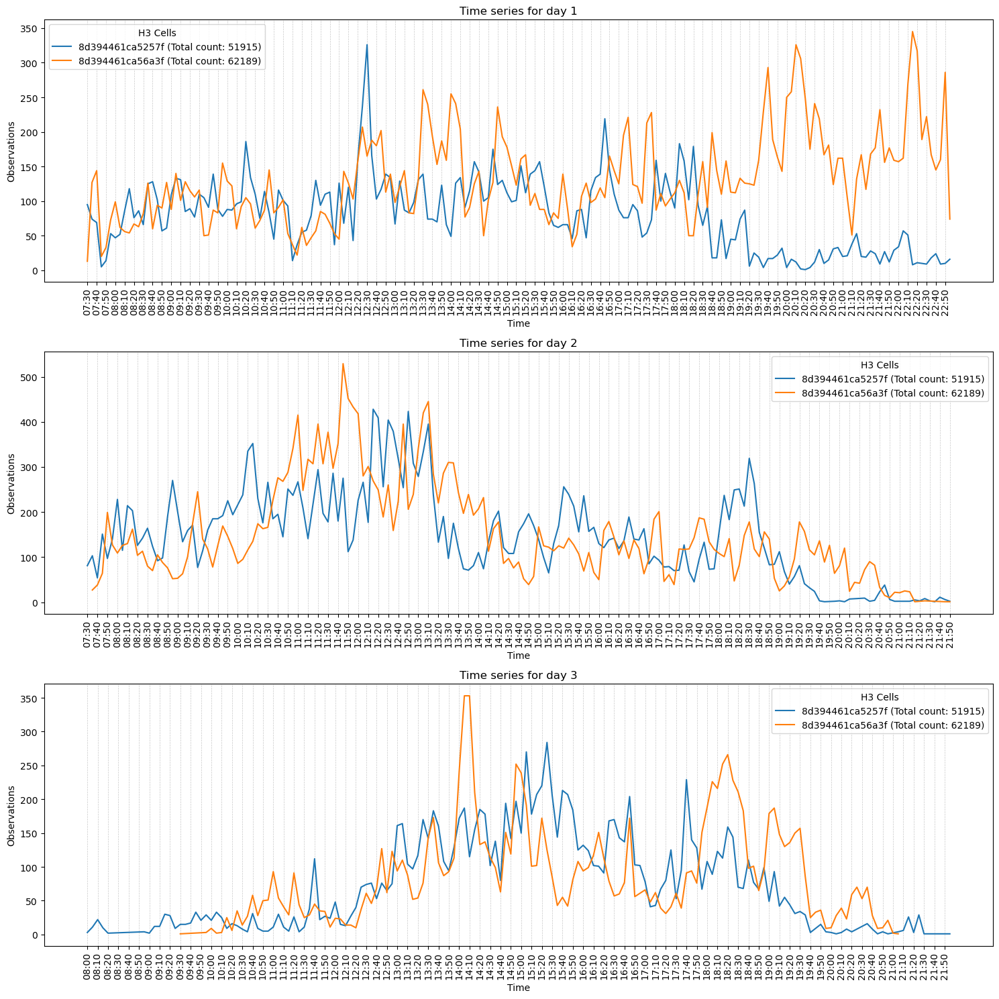

In [169]:
plot_cells_time_series(sonar_type='day', num_cells=2)

### Approaches to filter noise (Sónar by day)

I need to examine some information per user to see how data is distributed. 
I want to know the number of observations per user and the  stay duration (timespan) for each user and each day/night of the fesival.

In [170]:
info_per_user_day = duckdb_conn.sql("""
                                    SELECT vendor_name,
                                          macaddr_randomized,
                                          anonymized_macaddr,
                                          label_day,
                                          COUNT(*) AS observations_user_day,
                                          (MAX(timestamp_ap) - MIN(timestamp_ap))/60 AS timespan_minutes_day,
                                          COUNT(DISTINCT h3_cell) AS num_distinct_h3_cells_day
                                    FROM locations_day_filtered
                                    GROUP BY vendor_name, macaddr_randomized, anonymized_macaddr, label_day
                                    ORDER BY label_day, anonymized_macaddr, timespan_minutes_day, observations_user_day""")

In [171]:
'''fig = px.scatter_3d(info_per_user_day.to_df(), x='observations_user_day', y='timespan_minutes_day', z='num_distinct_h3_cells_day', color='macaddr_randomized')

# Update the layout to make the plot taller
fig.update_layout(
    height=800  
)

# Show the plot
fig.show()'''

"fig = px.scatter_3d(info_per_user_day.to_df(), x='observations_user_day', y='timespan_minutes_day', z='num_distinct_h3_cells_day', color='macaddr_randomized')\n\n# Update the layout to make the plot taller\nfig.update_layout(\n    height=800  \n)\n\n# Show the plot\nfig.show()"

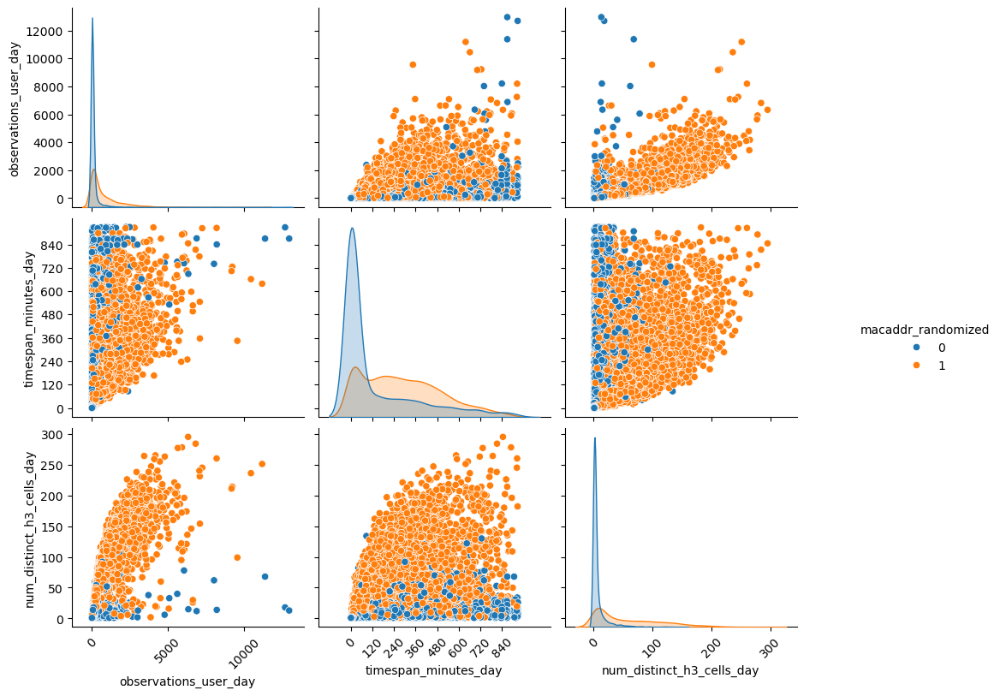

In [172]:
plot_pairplot(df=info_per_user_day.to_df(), sonar_type='day', filename_to_save=None)
#filename_to_save='day_pairplot_raw.png'

#### Removing non-mobile devices vendors

In [173]:
devices_vendor_raw_day = duckdb_conn.sql("""
                                    SELECT vendor_name, COUNT(*) as num_devices
                                    FROM info_per_user_day
                                    GROUP BY vendor_name
                                    ORDER BY num_devices DESC""").to_df()
devices_vendor_raw_day

,vendor_name,num_devices
0,None,4424
1,MediaTek Inc.,676
2,"Fujian LANDI Commercial Equipment Co.,Ltd",644
3,Xiaomi Communications Co Ltd,632
4,"Apple, Inc.",627
...,...,...
99,"vivo Mobile Communication Co., Ltd.",1
100,"Nintendo Co.,Ltd",1
101,Quanta Computer Inc.,1
102,"Qingdao Intelligent&Precise Electronics Co.,Ltd.",1


In [174]:
list_non_mobile_vendors_day = """('Shenzhen Xingguodu Technology Co., Ltd.', -- POS terminals
                            'Earda Technologies co Ltd', -- smart light switches
                            'Intel Corporate', -- apparently do not work with smartphones
                            'Hewlett Packard', -- apparently do not work with smartphones
                            'Ruckus Wireless', -- enterprise wireless infrastructure (e.g., Wi-Fi access points, routers)
                            'D-Link International', -- Smart home security cameras, smart plugs, Wi-Fi routers and range extenders to Enterprise-grade networking, wireless LAN, and surveillance solutions.
                            'Ubiquiti Inc', -- network infrastructure (e.g., routers, Wi-Fi access points)
                            'Fujian LANDI Commercial Equipment Co.,Ltd', -- POS terminals
                            'Fujian Landi Commercial Technology Co., Ltd.', -- POS terminals
                            'PAX Computer Technology(Shenzhen) Ltd.', -- POS terminals
                            'Continental Automotive Czech Republic s.r.o.', -- automotive technologies. Maybe for the exhibitions
                            'ALPSALPINE CO,.LTD', -- non-mobile devices
                            'Zebra Technologies Inc', -- tracking, inventory management, and barcode scanning sectors
                            'SCITEX CORPORATION LTD.', -- printing and imaging technologies
                            'SHENZHEN BILIAN ELECTRONIC CO.，LTD', -- networking equipment (Wi-Fi modules and routers)
                            'InPro Comm', -- industrial communication modules for IoT devices and M2M systems
                            'Honeywell SPS', -- rugged handhelds, industrial wearables
                            'Fibocom Wireless Inc.', -- IoT devices, smart home products, and industrial systems.
                            'Raspberry Pi Foundation', -- IoT projects, DIY applications, or educational tools
                            'Hand Held Products Inc', -- industrial handheld devices, barcode scanners, or mobile computing devices
                            'Arcadyan Corporation', -- Wi-Fi routers, extenders, and gateways for residential/enterprise use
                            'Rebound Telecom. Co., Ltd', -- likely related to non-mobile telecommunications hardware
                            'TP-Link Corporation Limited', -- home and enterprise networking hardware like routers and range extenders
                            'TP-LINK CORPORATION PTE. LTD.', -- home and enterprise networking hardware like routers and range extenders
                            'Ford Motor Company', -- automotive systems, unlikely related to wearables or mobile devices
                            'Tesla,Inc.', -- electric vehicles and smart automotive systems
                            'Amazon Technologies Inc.', -- smart home devices (e.g., Alexa) rather than smartphones
                            'IEEE Registration Authority', -- general-purpose registration body, not a device vendor
                            'DENSO CORPORATION', -- automotive technologies, unlikely related to mobile devices
                            'Panasonic Automotive Systems Company of America', -- automotive systems
                            'Sagemcom Broadband SAS', -- home and enterprise networking solutions (e.g., routers, modems)
                            'Universal Global Scientific Industrial Co., Ltd.', -- ODM manufacturing, but mostly for non-consumer devices
                            'DIAMOND SALES LIMITED', -- unclear/unknown relevance, unlikely mobile
                            'Zhong Ge Smart Technology Co., Ltd.', -- consumer-grade IoT devices, unlikely to be mobile
                            'Shenzhen Urovo Technology Co.,Ltd.', -- handheld industrial devices, rugged systems
                            'PARROT SA', -- drones and automotive technologies
                            'Eleksen Ltd', -- wearable fabric technology, not relevant for mobile wearables
                            'Quectel Wireless Solutions Co.,Ltd.', -- IoT modules for industrial, automotive, or M2M communication
                            'lesswire AG', -- embedded wireless modules for automotive/industrial use
                            'Oculus VR, LLC', -- VR devices, unlikely relevant to Wi-Fi MAC traces
                            'Gemtek Technology Co., Ltd.', -- networking devices, IoT hardware (non-mobile focus)
                            'Ningbo Forfan technology Co., LTD', -- likely IoT, not mobile devices
                            'Airgo Networks, Inc.', -- wireless chipsets, likely unrelated to mobile devices
                            'Quanta Computer Inc.', -- ODM manufacturing, mostly laptops/servers
                            'SHENZHEN RF-LINK TECHNOLOGY CO.,LTD.', -- Wi-Fi modules, non-consumer focus
                            'HONG KONG WATER WORLD TECHNOLOGY CO. LIMITED', -- unclear focus, likely unrelated to mobile
                            'Shenzhen Trolink Technology CO, LTD', -- routers, networking equipment
                            'Qingdao Intelligent&Precise Electronics Co.,Ltd.', -- unclear focus, likely unrelated to mobile
                            'Compal Information (Kunshan) Co., Ltd.', -- laptops, tablets, and non-mobile consumer electronics
                            'Microsoft Corporation', -- laptops, tablets, and enterprise hardware, not smartphones
                            'Hui Zhou Gaoshengda Technology Co.,LTD', -- Wi-Fi modules, likely unrelated to mobile
                            'Nintendo Co.,Ltd', -- gaming consoles and handheld gaming devices, unrelated to mobile devices
                            )"""


In [175]:
info_per_user_day_filter_devices = duckdb_conn.sql(F"""
                                                    SELECT *
                                                    FROM info_per_user_day
                                                    WHERE vendor_name NOT IN {list_non_mobile_vendors_day} OR vendor_name IS NULL
                                                    """) 

Checking the counts after the outliers and non-mobile vendors removal.

In [176]:
locations_day_filtered = duckdb_conn.sql("""
                                            SELECT ln.*
                                            FROM locations_day_filtered ln
                                            JOIN info_per_user_day_filter_devices iun
                                                ON ln.macaddr_randomized = iun.macaddr_randomized
                                                    AND ln.anonymized_macaddr = iun.anonymized_macaddr
                                                    AND ln.label_day = iun.label_day
                                             """)

print(f'Number of records Sónar by day (non-mobile vendors removal):')
display(duckdb_conn.sql("""
                        SELECT macaddr_randomized, COUNT(*) AS total_records
                        FROM locations_day_filtered
                        GROUP BY macaddr_randomized

                        UNION ALL

                        SELECT 'Total' AS macaddr_randomized, COUNT(*) AS total_records
                        FROM locations_day_filtered
                        """))


print(f'Unique macadresses Sónar by day (non-mobile vendors removal):')
display(duckdb_conn.sql("""
                        SELECT macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                        FROM locations_day_filtered
                        GROUP BY macaddr_randomized

                        UNION ALL

                        SELECT 'Total' AS macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                        FROM locations_day_filtered
                        """))

Number of records Sónar by day (non-mobile vendors removal):


┌────────────────────┬───────────────┐
│ macaddr_randomized │ total_records │
│      varchar       │     int64     │
├────────────────────┼───────────────┤
│ 0                  │        329311 │
│ 1                  │       3526090 │
│ Total              │       3855401 │
└────────────────────┴───────────────┘

Unique macadresses Sónar by day (non-mobile vendors removal):


┌────────────────────┬───────────────────┐
│ macaddr_randomized │ unique_user_count │
│      varchar       │       int64       │
├────────────────────┼───────────────────┤
│ 1                  │              2456 │
│ 0                  │              2667 │
│ Total              │              5123 │
└────────────────────┴───────────────────┘

#### Removing single-cell MAC addresses

I try to check if there are MAC addresses that did not move during the whole event (devices fixed by the organization, apart form the single observations).

In [177]:
info_per_users_cells_day = duckdb_conn.sql("""
                                        SELECT * 
                                        FROM 
                                            info_per_user_day_filter_devices
                                        ORDER BY macaddr_randomized ASC, num_distinct_h3_cells_day DESC, observations_user_day DESC""").to_df()
info_per_users_cells_day

,vendor_name,macaddr_randomized,anonymized_macaddr,label_day,observations_user_day,timespan_minutes_day,num_distinct_h3_cells_day
0,Xiaomi Communications Co Ltd,0,672b45ea2e0d96f06eee87899d62d4e50ea2eeaf1d3ad9...,1,2615,408.650000,153
1,Xiaomi Communications Co Ltd,0,5f0b96efd4de1590c23ccb7db44c03d2962824184e5daf...,2,1043,419.450000,140
2,"Murata Manufacturing Co., Ltd.",0,e884dce5dc919538393de754b81f6cffa2d86f772e8085...,1,2379,86.116667,134
3,Xiaomi Communications Co Ltd,0,fea33252757f65586fa81e0986ec301b0e64259bedd411...,2,2554,727.150000,130
4,Xiaomi Communications Co Ltd,0,5257d425ec26073314485772ee5ccfe087bf2d8b2be6fc...,1,1423,492.900000,130
...,...,...,...,...,...,...,...
7808,None,1,98e33e5305b3b722063c2e51bb3567f0a1f03fcbca4251...,3,1,0.000000,1
7809,None,1,a9091a6d3e942fdc996b2fe0e1432df69b9ff4776ca1fb...,3,1,0.000000,1
7810,None,1,a97dbfda5f3c9f652633070a7c067c9dd41f9805c8c7dd...,3,1,0.000000,1
7811,None,1,aba203a639c253b3adcc10097bd8bc41f47f6769a663e6...,3,1,0.000000,1


In [178]:
# Creating a histogram
fig = px.histogram(
    info_per_users_cells_day,
    x="num_distinct_h3_cells_day",
    color="macaddr_randomized",
    facet_row="label_day",
    nbins=300,
    title="Distribution of distinct cells per user (Sónar by day)",
    category_orders={"macaddr_randomized": [0, 1]})

# Updating the layout
fig.update_layout(
    xaxis_title="Distinct h3_cells",
    yaxis_title="Users",
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14)


# Showing the plot
fig.show()
#fig.write_html(os.path.join(path_interactive_plots,'distinct_cells_day.html'))

I can safely remove observations from users with just 1 distinct cell, as they don't really provide any information (they might indeed be MAC addresses from the organization devices).

In [179]:
duckdb_conn.sql("""SELECT vendor_name, macaddr_randomized, anonymized_macaddr, observations_user_day, timespan_minutes_day, num_distinct_h3_cells_day
                FROM info_per_users_cells_day
                WHERE num_distinct_h3_cells_day = 1
                ORDER BY observations_user_day DESC""")

┌─────────────────────────────────────┬────────────────────┬──────────────────────────────────────────────────────────────────┬───────────────────────┬──────────────────────┬───────────────────────────┐
│             vendor_name             │ macaddr_randomized │                        anonymized_macaddr                        │ observations_user_day │ timespan_minutes_day │ num_distinct_h3_cells_day │
│               varchar               │       int64        │                             varchar                              │         int64         │        double        │           int64           │
├─────────────────────────────────────┼────────────────────┼──────────────────────────────────────────────────────────────────┼───────────────────────┼──────────────────────┼───────────────────────────┤
│ AzureWave Technology Inc.           │                  0 │ 366625e9e75a05fac2b0e6380a6c978ca247023548d4b8f410e7706264b982fd │                   863 │               803.95 │              

In [180]:
del info_per_users_cells_day

Applying the filter for single-cell MAC address and checking the counts after filtering.

In [181]:
info_per_user_day_filter_single_cell = duckdb_conn.sql('SELECT * FROM info_per_user_day_filter_devices WHERE num_distinct_h3_cells_day > 1')

In [182]:
locations_day_filtered = duckdb_conn.sql("""
                                            SELECT ln.*
                                            FROM locations_day_filtered ln
                                            JOIN info_per_user_day_filter_single_cell iun
                                                ON ln.macaddr_randomized = iun.macaddr_randomized
                                                    AND ln.anonymized_macaddr = iun.anonymized_macaddr
                                                    AND ln.label_day = iun.label_day
                                             """)

In [183]:
print('Total records after filtering single cell users (Sónar by Day).')

duckdb_conn.sql("""
                SELECT macaddr_randomized, COUNT(*) AS total_records
                FROM locations_day_filtered
                GROUP BY macaddr_randomized

                UNION ALL

                SELECT 'Total' AS macaddr_randomized, COUNT(*) AS total_records
                FROM locations_day_filtered
                """)

Total records after filtering single cell users (Sónar by Day).


┌────────────────────┬───────────────┐
│ macaddr_randomized │ total_records │
│      varchar       │     int64     │
├────────────────────┼───────────────┤
│ 1                  │       3524547 │
│ 0                  │        317663 │
│ Total              │       3842210 │
└────────────────────┴───────────────┘

In [184]:
print('Total unique MAC addresses after filtering single cell users (Sónar by Day).')

duckdb_conn.sql("""
                SELECT macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                FROM locations_day_filtered
                GROUP BY macaddr_randomized

                UNION ALL

                SELECT 'Total' AS macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                FROM locations_day_filtered
                """)

Total unique MAC addresses after filtering single cell users (Sónar by Day).


┌────────────────────┬───────────────────┐
│ macaddr_randomized │ unique_user_count │
│      varchar       │       int64       │
├────────────────────┼───────────────────┤
│ 0                  │              1145 │
│ 1                  │              2267 │
│ Total              │              3412 │
└────────────────────┴───────────────────┘

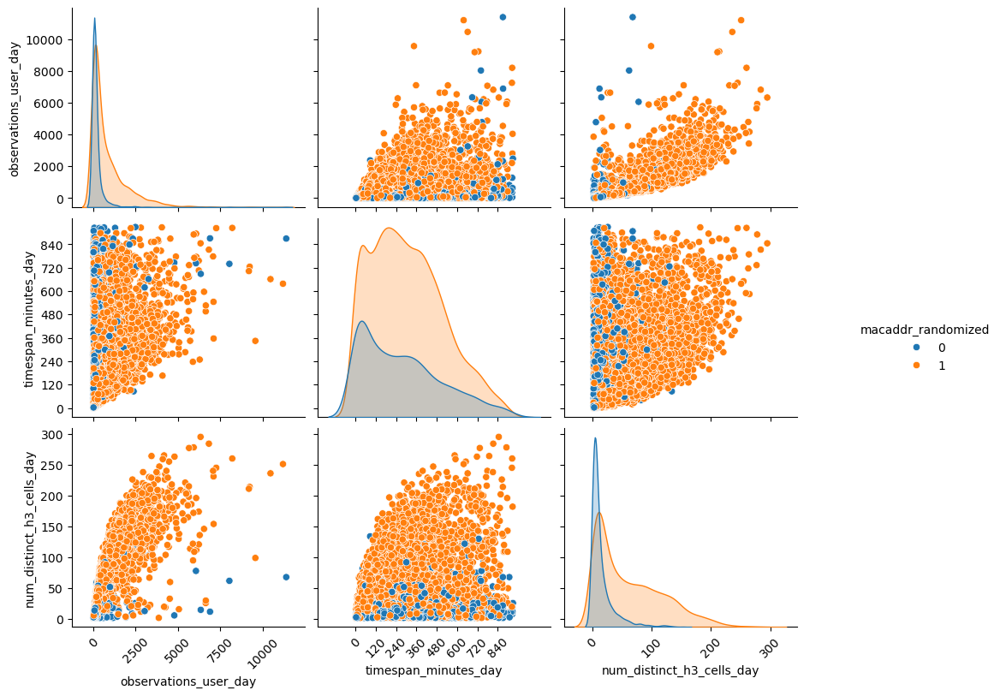

In [185]:
plot_pairplot(info_per_user_day_filter_single_cell.to_df(), sonar_type='day', filename_to_save=None)
#filename_to_save='day_pairplot_filter_single_cell.png'

In [186]:
devices_vendor_filter_single_cell_day = duckdb_conn.sql("""
                                        SELECT vendor_name, COUNT(*) as num_devices
                                        FROM info_per_user_day_filter_single_cell
                                        GROUP BY vendor_name
                                        ORDER BY num_devices DESC""").to_df()
devices_vendor_filter_single_cell_day

,vendor_name,num_devices
0,None,4117
1,"Apple, Inc.",560
2,Xiaomi Communications Co Ltd,385
3,"HUAWEI TECHNOLOGIES CO.,LTD",165
4,"Samsung Electronics Co.,Ltd",152
5,TomTom Software Ltd,69
6,SAMSUNG ELECTRO-MECHANICS(THAILAND),40
7,Liteon Technology Corporation,35
8,CLOUD NETWORK TECHNOLOGY SINGAPORE PTE. LTD.,29
9,Texas Instruments,28


In [187]:
del devices_vendor_raw_day

#### Distribution of the time spent

I will try to filter based on the time the users spent at the festival each day.

First I check the distribution of that time span.

In [188]:
info_per_user_day_filter_single_cell_df = info_per_user_day_filter_single_cell.to_df()

In [189]:
# Creating a violin plot
fig = px.violin(
    info_per_user_day_filter_single_cell_df,
    x='label_day',
    y='timespan_minutes_day',
    color='macaddr_randomized',
    box=True,
    points='outliers',
    title='Distribution of the time spent per user (Sónar by day)',
    category_orders={"macaddr_randomized": [0, 1]})

# Updating the layout
fig.update_layout(
    xaxis_title='Day of the festival',
    yaxis_title='Time spent at the festival (minutes)',
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14)

fig.show()
#fig.write_html(os.path.join(path_interactive_plots,'day_time_violin_filter_single_cell.html'))

In [190]:
# Creating a histogram
fig = px.histogram(
    info_per_user_day_filter_single_cell_df,
    x="timespan_minutes_day",
    color="macaddr_randomized",
    facet_row="label_day",
    nbins=500,
    title="Distribution of the time spent per user (Sónar by day)",
    category_orders={"macaddr_randomized": [0, 1]})

# Updating the layout
fig.update_layout(
    xaxis_title="Time spent at the festival (minutes)",
    yaxis_title="Users",
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14)

# Showing the plot
fig.show()
#fig.write_html(os.path.join(path_interactive_plots,'day_time_hist_filter_single_cell.html'))

In [191]:
# Prepare the data
data_0 = info_per_user_day_filter_single_cell_df[info_per_user_day_filter_single_cell_df['macaddr_randomized'] == 0]['timespan_minutes_day']
data_1 = info_per_user_day_filter_single_cell_df[info_per_user_day_filter_single_cell_df['macaddr_randomized'] == 1]['timespan_minutes_day']

# Create the distplot
fig = ff.create_distplot(
    [data_0, data_1], 
    group_labels=["Non-randomized", "Randomized"],
    show_hist=False, 
    show_rug=False,)

# Update layout
fig.update_layout(
    title="Density plot of time spent per user (Sónar by day)",
    xaxis_title="Time spent at the festival (minutes)",
    yaxis_title="Density",
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14,
    legend_title="macaddr_randomized"
)

# Show the plot
fig.show()
#fig.write_html(os.path.join(path_interactive_plots,'day_time_density_single_cell.html'))

There is a clear peak at the beginning of the time spent range that distorts the rest of the distribution, but there is no clear cut. This might represent MAC addresses of users that were just passing by the Fira, but did not take part of the festival.

On the other hand, there are also peaks at the end of the distribution. Given that I had already filtered the data with the time when events took place, this peak is likely caused by devices staying within the Fira more than the limits imposed by the filter based on the time of the events (maybe fixed or organizational devices). 

These extreme scenarios might distort the analysis results, so I decided to bound the time scope of the study, similar to the approach taken in the previous Sónar paper..  

I address the peak in the right part of the distribution first.    

##### Upper time bound

Unlike Sónar by night, Sónar by day shifts its time scope from one day to another So I cut the upper part of the distribution for each day independently. I still treat randomized and non-randomized as a whole, so that I can identify the overall behavior of attendees and exclude non-Sónar-attendees devices based on the aggregated data. 

In [192]:
print('Time spent per user Sónar by day (filtered for single cell MACs):')
day_timespan_distribution_filter_single_cell = duckdb_conn.query("""
                                                                  SELECT
                                                                    label_day,
                                                                    MIN(timespan_minutes_day) AS min_timespan,
                                                                    PERCENTILE_CONT(0.05) WITHIN GROUP(ORDER BY timespan_minutes_day) AS p05_timespan,
                                                                    PERCENTILE_CONT(0.10) WITHIN GROUP(ORDER BY timespan_minutes_day) AS p10_timespan,
                                                                    PERCENTILE_CONT(0.25) WITHIN GROUP(ORDER BY timespan_minutes_day) AS p25_timespan,
                                                                    PERCENTILE_CONT(0.50) WITHIN GROUP(ORDER BY timespan_minutes_day) AS median_timespan,
                                                                    PERCENTILE_CONT(0.75) WITHIN GROUP(ORDER BY timespan_minutes_day) AS p75_timespan,
                                                                    PERCENTILE_CONT(0.90) WITHIN GROUP(ORDER BY timespan_minutes_day) AS p90_timespan,
                                                                    PERCENTILE_CONT(0.95) WITHIN GROUP(ORDER BY timespan_minutes_day) AS p95_timespan,
                                                                    PERCENTILE_CONT(0.975) WITHIN GROUP(ORDER BY timespan_minutes_day) AS p975_timespan,
                                                                    MAX(timespan_minutes_day) AS max_timespan
                                                                  FROM info_per_user_day_filter_single_cell_df
                                                                  GROUP BY label_day
                                                                  ORDER BY label_day""")
day_timespan_distribution_filter_single_cell

Time spent per user Sónar by day (filtered for single cell MACs):


┌───────────┬────────────────────┬────────────────────┬────────────────────┬────────────────────┬────────────────────┬────────────────────┬───────────────────┬───────────────────┬───────────────────┬───────────────────┐
│ label_day │    min_timespan    │    p05_timespan    │    p10_timespan    │    p25_timespan    │  median_timespan   │    p75_timespan    │   p90_timespan    │   p95_timespan    │   p975_timespan   │   max_timespan    │
│   int32   │       double       │       double       │       double       │       double       │       double       │       double       │      double       │      double       │      double       │      double       │
├───────────┼────────────────────┼────────────────────┼────────────────────┼────────────────────┼────────────────────┼────────────────────┼───────────────────┼───────────────────┼───────────────────┼───────────────────┤
│         1 │ 1.8166666666666667 │ 5.4591666666666665 │  9.393333333333334 │              99.35 │  288.3333333333333 │  

In any case, the last bin, which corresponds to 12 hours or more is also a peak. It mostly contains non-randomized MAC addresses, unlike the rest of the dataset, which might also indicate devices from the organization.
However, it seems that there are many MAC addresses that spent a long time, across all the range of observations distribution and the amount of distinct cells that were visited. I take a closer look at these examples

In [193]:
upper_time_bound_percentile = 'p975'
users_long_timespan_day = duckdb_conn.sql(f"""
                                            SELECT u.*
                                            FROM info_per_user_day_filter_single_cell u
                                                JOIN (
                                                        SELECT label_day, 
                                                            {upper_time_bound_percentile}_timespan
                                                        FROM day_timespan_distribution_filter_single_cell
                                                ) p
                                            ON u.label_day = p.label_day
                                            WHERE u.timespan_minutes_day >= p.{upper_time_bound_percentile}_timespan""")

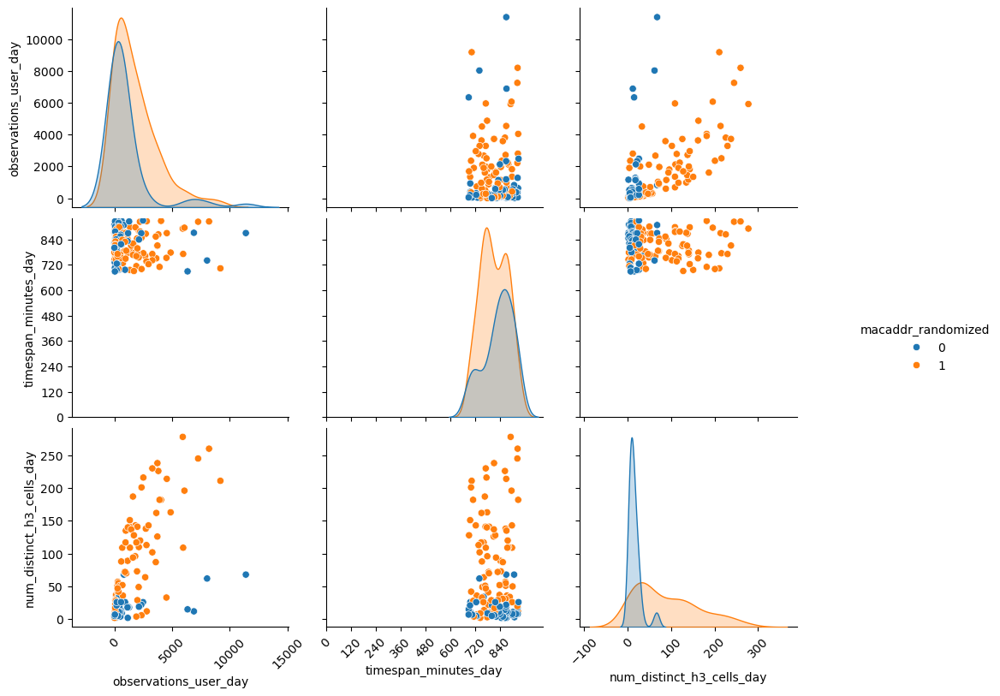

In [194]:
plot_pairplot(df=users_long_timespan_day.to_df(), sonar_type='day', filename_to_save=None)
#filename_to_save=f'day_pairplot_long_stays_{upper_time_bound_percentile}.png'

In [195]:
duckdb_conn.sql("""SELECT macaddr_randomized, vendor_name, COUNT(*) AS num_devices_long_timespan 
                FROM users_long_timespan_day
                GROUP BY macaddr_randomized, vendor_name
                ORDER BY num_devices_long_timespan DESC""")

┌────────────────────┬──────────────────────────────────────────────┬───────────────────────────┐
│ macaddr_randomized │                 vendor_name                  │ num_devices_long_timespan │
│       int64        │                   varchar                    │           int64           │
├────────────────────┼──────────────────────────────────────────────┼───────────────────────────┤
│                  1 │ NULL                                         │                        89 │
│                  0 │ Apple, Inc.                                  │                        27 │
│                  0 │ Samsung Electronics Co.,Ltd                  │                         6 │
│                  0 │ Liteon Technology Corporation                │                         5 │
│                  0 │ HUNAN FN-LINK TECHNOLOGY LIMITED             │                         3 │
│                  0 │ LG Innotek                                   │                         3 │
│                  0

As the chosen percentile covers more than the entire span of the events for each night, it is a safe and reasonable upper bound. 

In [196]:
# Filter for users who spent less than x minutes
users_filter_timespan_upper_day = duckdb_conn.sql(f"""
                                                SELECT u.*
                                                FROM info_per_user_day_filter_single_cell u
                                                    JOIN (
                                                            SELECT label_day, 
                                                                {upper_time_bound_percentile}_timespan
                                                            FROM day_timespan_distribution_filter_single_cell
                                                    ) p
                                                ON u.label_day = p.label_day
                                                WHERE u.timespan_minutes_day < p.{upper_time_bound_percentile}_timespan""").to_df()

##### Lower time bound

Now, I try to find a lower bound for the distribution. 

TODO: The distributions of randomized and non-randomized MAC addresses have a similar shapes, so it makes sense to find an overall lower bound (without splitting the data)

In [197]:
# Creating a violin plot
fig = px.violin(
    users_filter_timespan_upper_day,
    x='label_day',
    y='timespan_minutes_day',
    #color='macaddr_randomized',
    box=True,
    points='outliers',
    title=f'Distribution of the time spent per user (Sónar by day). Stays longer than the {upper_time_bound_percentile} removed',
    category_orders={"macaddr_randomized": [0, 1]})

# Updating the layout
fig.update_layout(
    xaxis_title='Day of the festival',
    yaxis_title='Time spent at the festival (minutes)',
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14)

fig.show()
#fig.write_html(os.path.join(path_interactive_plots,f'day_time_violin_filter{upper_time_bound_percentile}.html'))

In [198]:
# Creating a histogram
fig = px.histogram(
    users_filter_timespan_upper_day,
    x="timespan_minutes_day",
    #color="macaddr_randomized",
    facet_row="label_day",
    nbins=500,
    title=f"Distribution of the time spent per user (Sónar by day). Stays longer than the {upper_time_bound_percentile} removed",
    category_orders={"macaddr_randomized": [0, 1]})

# Updating the layout
fig.update_layout(
    xaxis_title="Time spent at the festival (minutes)",
    yaxis_title="Users",
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14)

# Showing the plot
fig.show()
#fig.write_html(os.path.join(path_interactive_plots,f'day_time_hist_filter{upper_time_bound_percentile}.html'))

In [199]:
# Prepare the data
users_filter_timespan_upper_day1 = users_filter_timespan_upper_day.loc[users_filter_timespan_upper_day['label_day']==1]
users_filter_timespan_upper_day2 = users_filter_timespan_upper_day.loc[users_filter_timespan_upper_day['label_day']==2]
users_filter_timespan_upper_day3 = users_filter_timespan_upper_day.loc[users_filter_timespan_upper_day['label_day']==3]

In [200]:
# Create the distplot
fig = ff.create_distplot(
    [users_filter_timespan_upper_day1['timespan_minutes_day'], users_filter_timespan_upper_day2['timespan_minutes_day'], users_filter_timespan_upper_day3['timespan_minutes_day']],
    group_labels=["All data - Day 1", "All data - Day 2", "All data - Day 3"],
    show_hist=False, 
    show_rug=False,)

# Update layout
fig.update_layout(
    title=f"Density plot of time spent per user (Sónar by day). Stays longer than the {upper_time_bound_percentile} removed",
    xaxis_title="Time spent at the festival (minutes)",
    yaxis_title="Density",
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14,
    #legend_title="macaddr_randomized"
)

# Show the plot
fig.show()
#fig.write_html(os.path.join(path_interactive_plots,f'day_time_density_filter{upper_time_bound_percentile}.html'))

Because of the multiple exisitng possibilities for a lower bound, I try a more statistical-based criterion to define this value. One possible way of doing this is by assuming that this distribution is a combination of Gaussion distributions. In this case, I could use GMM to model the time-spent distribution data.

I tried fitting the GMM on the original data, but it was not able to capture the distorting peak at the begining of the distribution. Instead, the logarithm of the time spent shows a more obvious tail at the beginning, which was possible to model more easily:

In [201]:
# Create the distplot
fig = ff.create_distplot(
    [np.log(users_filter_timespan_upper_day1['timespan_minutes_day']),
     np.log(users_filter_timespan_upper_day2['timespan_minutes_day']),
     np.log(users_filter_timespan_upper_day3['timespan_minutes_day'])
    ],
    group_labels=["All data - Day 1", "All data - Day 2", "All data - Day 3"],
    show_hist=False, 
    show_rug=False,)

# Update layout
fig.update_layout(
    title=f"Density plot of time spent per user (Sónar by night). Stays longer than {upper_time_bound_percentile} removed",
    xaxis_title="log(Time spent at the festival (minutes))",
    yaxis_title="Density",
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14,
    #legend_title="macaddr_randomized"
)

# Show the plot
fig.show()
#fig.write_html(os.path.join(path_interactive_plots,f'night_time_density_filter{upper_time_bound_percentile}_log.html'))

- Day 1

Model selection for GMM - Day 1


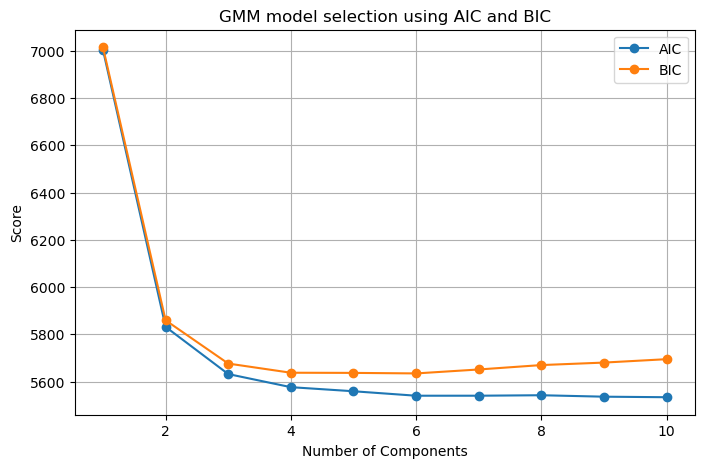

Optimal number of components based on AIC: 10
Optimal number of components based on BIC: 6
Elbow point based on AIC: 3
Elbow point based on BIC: 3


In [202]:
print('Model selection for GMM - Day 1')
utils_models.gmm_elbow_method(np.log(users_filter_timespan_upper_day1['timespan_minutes_day'].to_numpy().reshape(-1, 1)),
                              filename_to_save=None)

#filename_to_save=os.path.join(path_interactive_plots,'day_time_gmm_selection_d1.png')

GMM for day 1


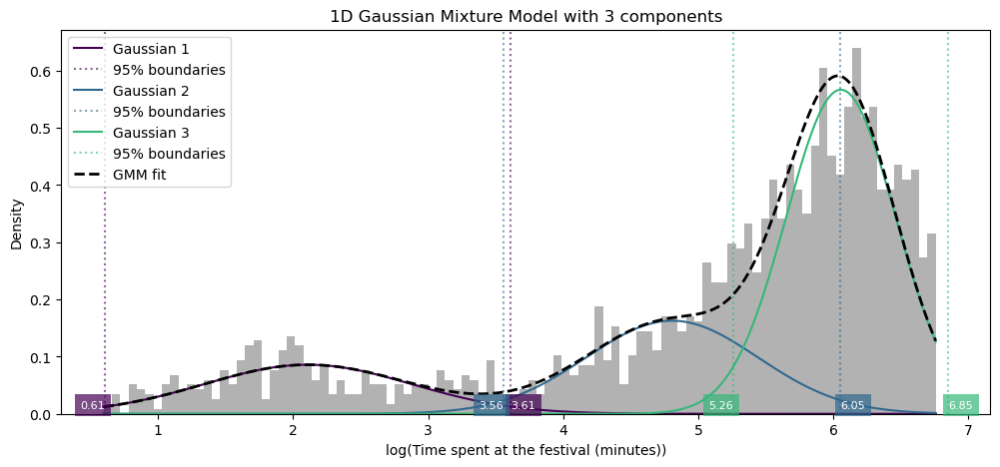

{'boundaries': [(0.6078973643437144, 3.6116299470466053),
  (3.5604984106413857, 6.050651979013039),
  (5.260059171053928, 6.849479524207069)],
 'bic': 5676.120601931046}

In [203]:
print('GMM for day 1')
boundaries_chosen_gmm_day1 = utils_models.gmm_1d_boundaries(data=np.log(users_filter_timespan_upper_day1['timespan_minutes_day'].to_numpy().reshape(-1, 1)),
                                                            n_centers=3, bins_hist=100, x_label='log(Time spent at the festival (minutes))',
                                                            filename_to_save=None)
boundaries_chosen_gmm_day1

#filename_to_save=os.path.join(path_interactive_plots,'day_time_gmm_fit_d1.png')

In [204]:
print('Chosen lower bound in minutes - day 1:')
lower_time_threshold_day1 = round(np.exp(boundaries_chosen_gmm_day1['boundaries'][1][0]))
lower_time_threshold_day1

Chosen lower bound in minutes - day 1:


35

- Day 2

Model selection for GMM - Day 2


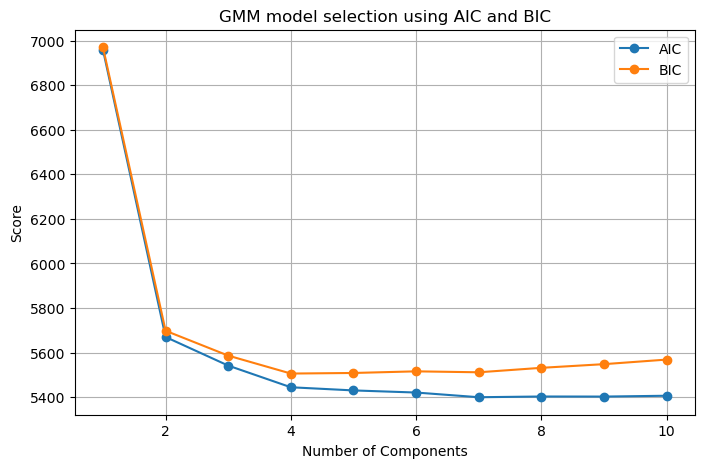

Optimal number of components based on AIC: 7
Optimal number of components based on BIC: 4
Elbow point based on AIC: 2
Elbow point based on BIC: 2


In [205]:
print('Model selection for GMM - Day 2')
utils_models.gmm_elbow_method(np.log(users_filter_timespan_upper_day2['timespan_minutes_day'].to_numpy().reshape(-1, 1)),
                              filename_to_save=None)

#filename_to_save=os.path.join(path_interactive_plots,'day_time_gmm_selection_d2.png')

I use 3 components for consistency with the previous examples. In any case, it is just one more component than the elbow point (and it has a better AIC and BIC).

GMM for day 2


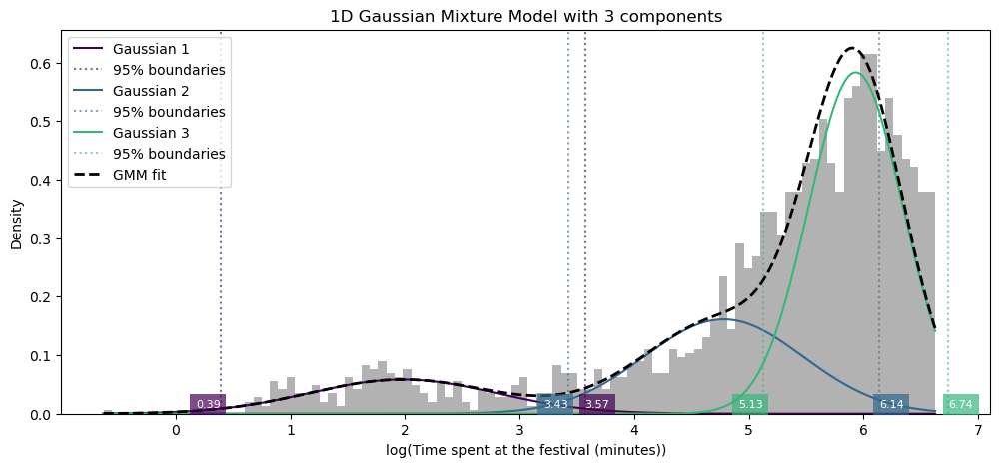

{'boundaries': [(0.3908772806385865, 3.571423808245606),
  (3.425732138181587, 6.135213681661433),
  (5.125246106312009, 6.739212603896281)],
 'bic': 5586.126076532846}

In [206]:
print('GMM for day 2')
boundaries_chosen_gmm_day2 = utils_models.gmm_1d_boundaries(data=np.log(users_filter_timespan_upper_day2['timespan_minutes_day'].to_numpy().reshape(-1, 1)),
                                                            n_centers=3, bins_hist=100, x_label='log(Time spent at the festival (minutes))',
                                                            filename_to_save=None)
boundaries_chosen_gmm_day2

#filename_to_save=os.path.join(path_interactive_plots,'day_time_gmm_fit_d2.png')

In [207]:
print('Chosen lower bound in minutes - day 2:')
lower_time_threshold_day2 = round(np.exp(boundaries_chosen_gmm_day2['boundaries'][1][0]))
lower_time_threshold_day2

Chosen lower bound in minutes - day 2:


31

- Day 3

Model selection for GMM - Day 3


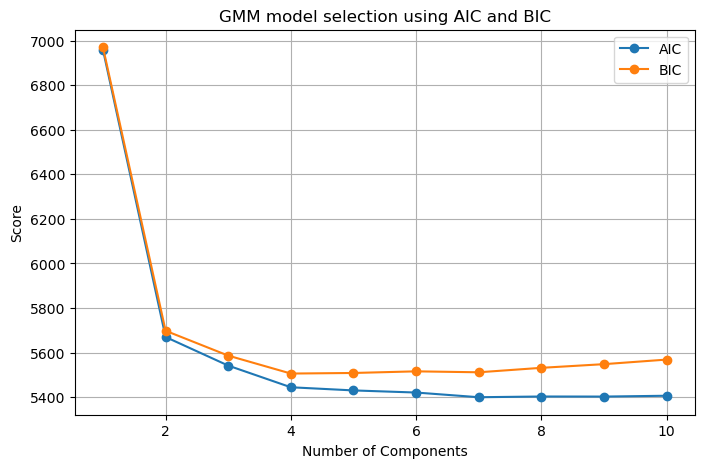

Optimal number of components based on AIC: 7
Optimal number of components based on BIC: 4
Elbow point based on AIC: 2
Elbow point based on BIC: 2


In [208]:
print('Model selection for GMM - Day 3')
utils_models.gmm_elbow_method(np.log(users_filter_timespan_upper_day2['timespan_minutes_day'].to_numpy().reshape(-1, 1)),
                              filename_to_save=None)

#filename_to_save=os.path.join(path_interactive_plots,'day_time_gmm_selection_d3.png')

I use 3 components for consistency with the previous examples. In any case, it is just one more component than the elbow point (and it has a better AIC and BIC).

GMM for day 3


c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=7.



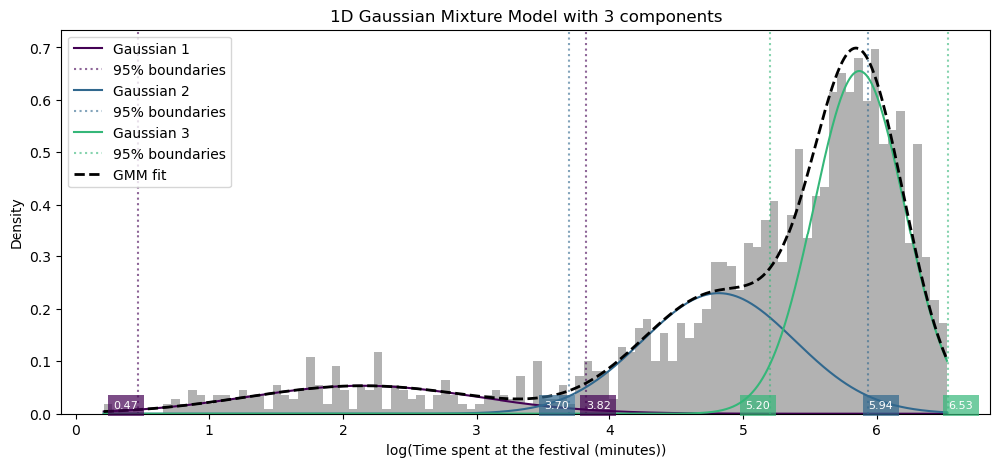

{'boundaries': [(0.46881101401603154, 3.824288120153925),
  (3.6993716716519973, 5.9363460218221675),
  (5.204631210127828, 6.534295732554887)],
 'bic': 4574.824763960146}

In [209]:
print('GMM for day 3')
boundaries_chosen_gmm_day3 = utils_models.gmm_1d_boundaries(data=np.log(users_filter_timespan_upper_day3['timespan_minutes_day'].to_numpy().reshape(-1, 1)),
                                                            n_centers=3, bins_hist=100, x_label='log(Time spent at the festival (minutes))',
                                                            filename_to_save=None)
boundaries_chosen_gmm_day3

#filename_to_save=os.path.join(path_interactive_plots,'day_time_gmm_fit_d3.png')

In [210]:
print('Chosen lower bound in minutes - day 3:')
lower_time_threshold_day3 = round(np.exp(boundaries_chosen_gmm_day3['boundaries'][1][0]))
lower_time_threshold_day3

Chosen lower bound in minutes - day 3:


40

In [211]:
del users_filter_timespan_upper_day, users_filter_timespan_upper_day1, users_filter_timespan_upper_day2, users_filter_timespan_upper_day3

There is a high concentration of data in the two right-most components of the GMM, and the lower bound of these two distributions provides a reasonable threshold, so I choose this value as the lower bound to filter the data (for each day). 

In [212]:
# Create a DataFrame for the lower bounds
lower_bounds_day = pd.DataFrame({'label_day': [1, 2, 3],
                                 'lower_bound': [lower_time_threshold_day1, lower_time_threshold_day2, lower_time_threshold_day3]})
lower_bounds_day

,label_day,lower_bound
0,1,35
1,2,31
2,3,40


Applying the filter for the time spent at the festival.

In [213]:
info_per_user_day_timefiltered = duckdb_conn.sql(f"""
                                                    SELECT u.*
                                                    FROM info_per_user_day_filter_single_cell u
                                                        JOIN 
                                                            (
                                                                SELECT label_day, 
                                                                    {upper_time_bound_percentile}_timespan
                                                                FROM day_timespan_distribution_filter_single_cell
                                                            ) p
                                                            ON u.label_day = p.label_day
                                                        JOIN lower_bounds_day l
                                                            ON u.label_day = l.label_day
                                                    WHERE u.timespan_minutes_day BETWEEN l.lower_bound AND p.{upper_time_bound_percentile}_timespan
                                                """).to_df()

In [214]:
locations_day_filtered = duckdb_conn.sql(F"""
                                           SELECT ld.*, iuf.observations_user_day, iuf.timespan_minutes_day, iuf.num_distinct_h3_cells_day
                                           FROM locations_day_filtered ld
                                            INNER JOIN info_per_user_day_timefiltered iuf 
                                            ON ld.anonymized_macaddr = iuf.anonymized_macaddr
                                                AND ld.macaddr_randomized = iuf.macaddr_randomized
                                                AND ld.label_day = iuf.label_day""")


print(f'Number of records Sónar by day (after time-based filtering with the gmm lower bounds and the p95):')
display(duckdb_conn.sql("""
                        SELECT macaddr_randomized, COUNT(*) AS total_records
                        FROM locations_day_filtered
                        GROUP BY macaddr_randomized

                        UNION ALL

                        SELECT 'Total' AS macaddr_randomized, COUNT(*) AS total_records
                        FROM locations_day_filtered
                        """))


print(f'Unique macadresses Sónar by day (after time-based filtering with the gmm lower bounds and the p95):')
display(duckdb_conn.sql("""
                        SELECT macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                        FROM locations_day_filtered
                        GROUP BY macaddr_randomized

                        UNION ALL

                        SELECT 'Total' AS macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                        FROM locations_day_filtered
                        """))

Number of records Sónar by day (after time-based filtering with the gmm lower bounds and the p95):


┌────────────────────┬───────────────┐
│ macaddr_randomized │ total_records │
│      varchar       │     int64     │
├────────────────────┼───────────────┤
│ 0                  │        249690 │
│ 1                  │       3338327 │
│ Total              │       3588017 │
└────────────────────┴───────────────┘

Unique macadresses Sónar by day (after time-based filtering with the gmm lower bounds and the p95):


┌────────────────────┬───────────────────┐
│ macaddr_randomized │ unique_user_count │
│      varchar       │       int64       │
├────────────────────┼───────────────────┤
│ 1                  │              2009 │
│ 0                  │               866 │
│ Total              │              2875 │
└────────────────────┴───────────────────┘

#### Examining observations and distinct cells

I update the users table to reflect the changes that have been made so far (especially the location-based filter, that was not made by querying the users table).

In [215]:
info_per_user_day_filtered = duckdb_conn.sql("""
                                          SELECT vendor_name,
                                                macaddr_randomized,
                                                anonymized_macaddr,
                                                label_day,
                                                COUNT(*) AS observations_user_day,
                                                (MAX(timestamp_ap) - MIN(timestamp_ap))/60 AS timespan_minutes_day,
                                                COUNT(DISTINCT h3_cell) AS num_distinct_h3_cells_day
                                          FROM locations_day_filtered
                                          GROUP BY vendor_name, anonymized_macaddr, macaddr_randomized, label_day,
                                          ORDER BY label_day, anonymized_macaddr, timespan_minutes_day, observations_user_day""")

info_per_user_day_filtered_df = info_per_user_day_filtered.df()

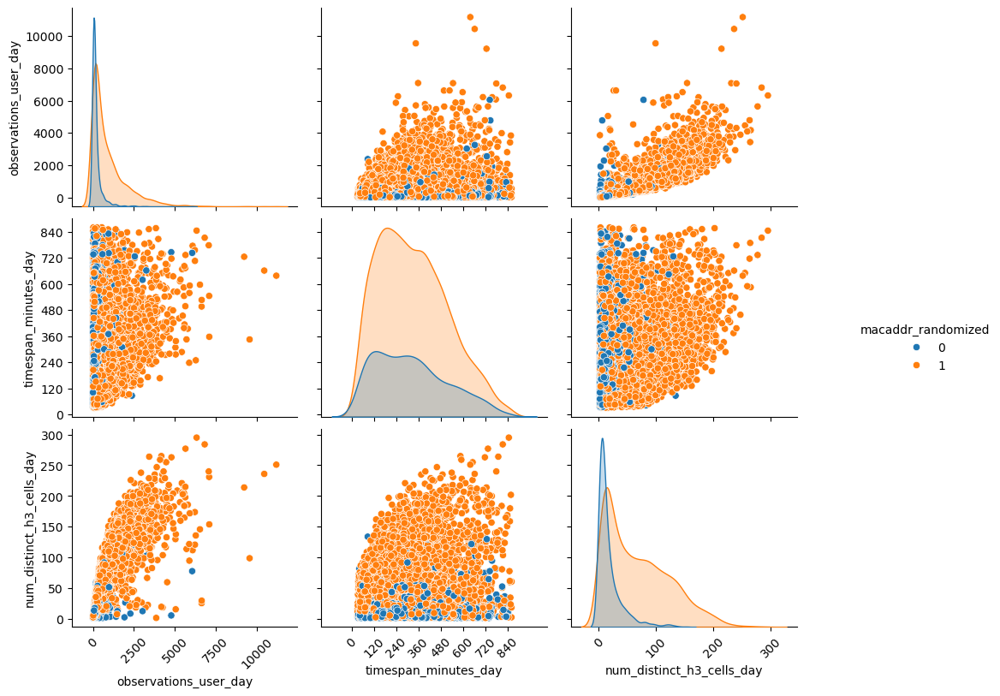

In [216]:
plot_pairplot(df=info_per_user_day_filtered_df, sonar_type='day', filename_to_save=None)
#filename_to_save=f'day_pairplot_filter_time_lower_upper.png'

Now, the time spent by day has a more regular distribution. However, the observations and the distinct cells distributions are highly right-skewed. I will check the distribution of observations a little closer.

##### Distribution of observations

In [217]:
# Creating a violin plot
fig = px.violin(
    info_per_user_day_filtered_df,
    x='label_day',
    y='observations_user_day',
    color='macaddr_randomized',  
    box=True,  
    points='outliers',  
    title=f'Distribution of observations per user (Sónar by day). Filtered with time lower and upper bounds)',
    category_orders={"macaddr_randomized": [0, 1]})

# Updating the layout
fig.update_layout(
    xaxis_title='Day of the festival',
    yaxis_title='Observations per user',
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14)

fig.show()

In [218]:
# Creating a histogram
fig = px.histogram(
    info_per_user_day_filtered_df,
    x="observations_user_day",
    color="macaddr_randomized",
    facet_row="label_day",
    nbins=5000,
    title=f"Distribution of observations per user (Sónar by day). Filtered with time (lower-upper bounds)",
    category_orders={"macaddr_randomized": [0, 1]})

# Updating the layout
fig.update_layout(
    xaxis_title="Observations per user",
    yaxis_title="Users",
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14)

# Showing the plot
fig.show()

##### Distribution of distinct cells

Checking the  distribution of number of distinct cells per user (in a day).

In [219]:
# Creating a violin plot
fig = px.violin(
    info_per_user_day_filtered_df,
    x='label_day',
    y='num_distinct_h3_cells_day',
    color='macaddr_randomized',  
    box=True,  
    points='outliers',  
    title=f'Distribution of distinct H3 cells per user (Sónar by day). Filtered with time (lower-upper bounds)',
    category_orders={"macaddr_randomized": [0, 1]})

# Updating the layout
fig.update_layout(
    xaxis_title='Day of the festival',
    yaxis_title='Observations per user',
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14)

fig.show()

In [220]:
# Creating a histogram
fig = px.histogram(
    info_per_user_day_filtered_df,
    x="num_distinct_h3_cells_day",
    color="macaddr_randomized",
    facet_row="label_day",
    nbins=500,
    title=f"Distribution of distinct H3 cells per user (Sónar by day). Filtered with time (lower-upper bounds)",
    category_orders={"macaddr_randomized": [0, 1]})

# Updating the layout
fig.update_layout(
    xaxis_title="Observations per user",
    yaxis_title="Users",
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14)

# Showing the plot
fig.show()

#### Combined metrics based on observations and distinct cells

It is hard to draw conclusions from the observations and distinct cells distributions by themselves, but, looking at the pairplots, it seems there are some strange cases when looking at the joint distributions of the observations and the distinct cells, as some of the examples do not follow the "diagonal" pattern  

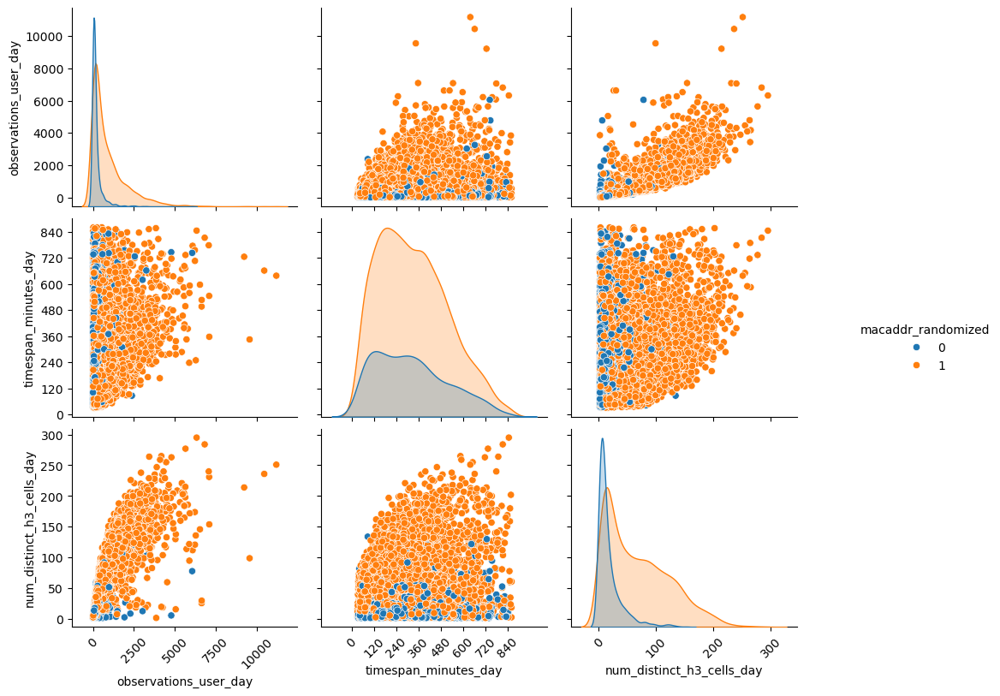

In [221]:
plot_pairplot(info_per_user_day_filtered_df, sonar_type='day')

I am going to compute some derived metrics to gain a little interpretation insights out of the points I am checking.

In [222]:
info_per_user_day_filtered_df['observations_per_cell'] = info_per_user_day_filtered_df['observations_user_day'] / info_per_user_day_filtered_df['num_distinct_h3_cells_day']
info_per_user_day_filtered_df['observations_per_minute'] = info_per_user_day_filtered_df['observations_user_day'] / info_per_user_day_filtered_df['timespan_minutes_day']
info_per_user_day_filtered_df['minutes_per_cell'] = info_per_user_day_filtered_df['timespan_minutes_day'] / info_per_user_day_filtered_df['num_distinct_h3_cells_day']

info_per_user_day_filtered_df['log_num_distinct_h3_cells_day'] = np.log(info_per_user_day_filtered_df['num_distinct_h3_cells_day'])
info_per_user_day_filtered_df['log_observations_user_day'] = np.log(info_per_user_day_filtered_df['observations_user_day'])
info_per_user_day_filtered_df['log_timespan_minutes_day'] = np.log(info_per_user_day_filtered_df['timespan_minutes_day'])

In [223]:
'''sns.pairplot(
        info_per_user_day_filtered_df[['observations_per_cell', 'observations_per_minute', 'cells_per_minute', 'macaddr_randomized']],
        hue='macaddr_randomized')'''

"sns.pairplot(\n        info_per_user_day_filtered_df[['observations_per_cell', 'observations_per_minute', 'cells_per_minute', 'macaddr_randomized']],\n        hue='macaddr_randomized')"

##### Separate regression (original space)

First, I try a regression for the randomized and the non-randomzied MAC address separately. In this case, it seems that non-randomized devices have a different behavior from randomized ones, regarding these two variables. However, it seems that some outliers detected from one distribution seem to be part of the other's the distribution. In the end, I want to work with overall users.

Outliers - Randomized: 49
Outliers - Non-randomized: 38


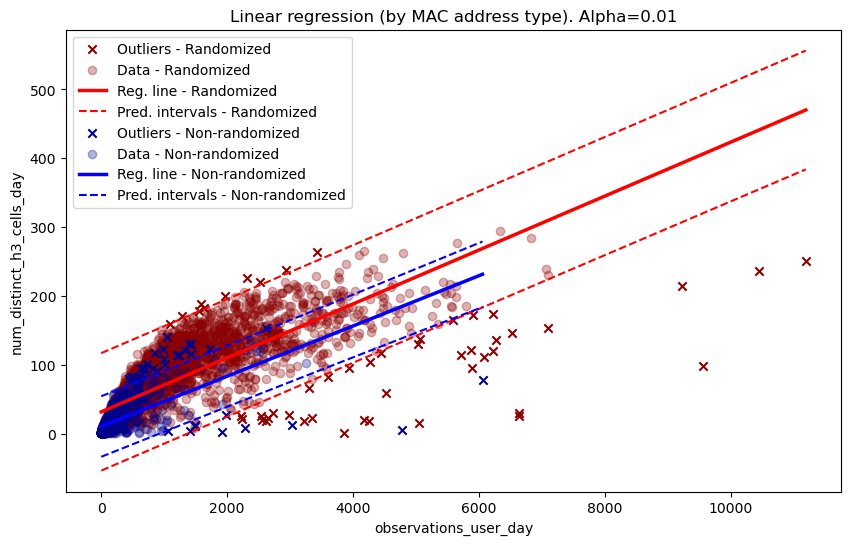

,vendor_name,macaddr_randomized,anonymized_macaddr,label_day,observations_user_day,timespan_minutes_day,num_distinct_h3_cells_day,observations_per_cell,observations_per_minute,minutes_per_cell,log_num_distinct_h3_cells_day,log_observations_user_day,log_timespan_minutes_day,outlier_lin_reg
2373,None,1,f8c3da1fb9c5edeb6702dc113a5b8f2733612db9bb6d40...,2,3862,618.800000,2,1931.000000,6.241112,309.400000,0.693147,8.258940,6.427782,yes
4109,Liteon Technology Corporation,0,29feeae114d6372841f9fead698404b82a5e0091cb407e...,2,1926,461.716667,3,642.000000,4.171389,153.905556,1.098612,7.563201,6.134951,yes
4173,CLOUD NETWORK TECHNOLOGY SINGAPORE PTE. LTD.,0,44b8cf7b2bf7da71672a72b69c10d0036b6cb2d2b6cf85...,2,1057,657.933333,4,264.250000,1.606546,164.483333,1.386294,6.963190,6.489104,yes
4838,CLOUD NETWORK TECHNOLOGY SINGAPORE PTE. LTD.,0,f1e111e3f744bfdb10cc96f7f28cd419dccbd2dd2e48aa...,3,1411,443.883333,4,352.750000,3.178763,110.970833,1.386294,7.252054,6.095562,yes
4411,"Hon Hai Precision Ind. Co.,Ltd.",0,d1c6cd9c716c91c9b0169f10aeaec3f34192e2c530f2f6...,2,4779,746.383333,6,796.500000,6.402876,124.397222,1.791759,8.471987,6.615239,yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2311,None,1,eb9a3a265d543758733d0631ff3298f02441b2bb1784bb...,2,4791,716.766667,263,18.216730,6.684184,2.725349,5.572154,8.474494,6.574750,no
2641,None,1,2f66e446e77bc98a839d98d598ed97bdb0c61c71b8b564...,3,4175,585.183333,265,15.754717,7.134516,2.208239,5.579730,8.336870,6.371925,no
1111,None,1,fe212f2681c8a322a1201f2f67381bba4f9f2a814f9253...,1,5648,733.516667,277,20.389892,7.699893,2.648075,5.624018,8.639057,6.597850,no
372,None,1,550d54afaece379a6056c40f9a30d16ef395b8531cc2f2...,1,6819,812.950000,284,24.010563,8.387970,2.862500,5.648974,8.827468,6.700670,no


In [224]:
outliers_cells_vs_obs_split_day = outliers_linear_models(df_users_info=info_per_user_day_filtered_df,
                                                         x_variable='observations_user_day', y_variable='num_distinct_h3_cells_day',
                                                         reg_type = 'by MAC address type', alpha=0.01,
                                                         show_eval_metrics=False).sort_values(by=['outlier_lin_reg','num_distinct_h3_cells_day'], ascending=[False,True])
outliers_cells_vs_obs_split_day

##### Combined regression (original space)

In this case, I try to perform the regression with all points and discard outliers from the combined dataset (which seem to be, again, sort of static MAC addresses: devices that have a lot of observations, but did not move much).

--------------------------------------------------------------------
Regression assessment metrics for  regression:
                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.668
Model:                            OLS   Adj. R-squared:                  0.668
Method:                 Least Squares   F-statistic:                     9770.
Date:                Wed, 29 Jan 2025   Prob (F-statistic):               0.00
Time:                        12:51:54   Log-Likelihood:                -23602.
No. Observations:                4861   AIC:                         4.721e+04
Df Residuals:                    4859   BIC:                         4.722e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
---------------

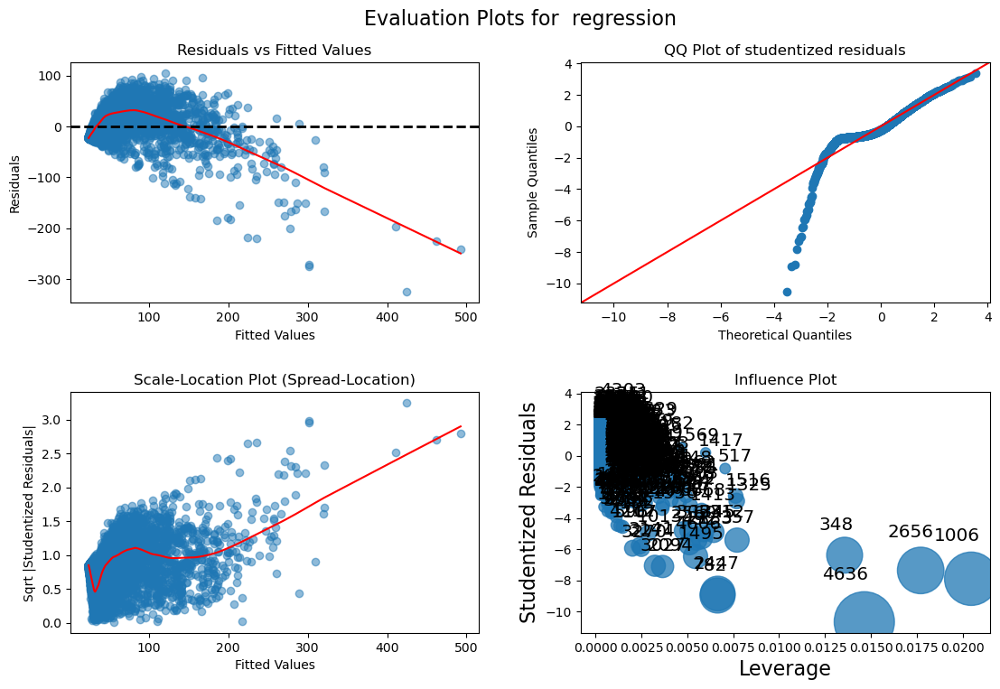

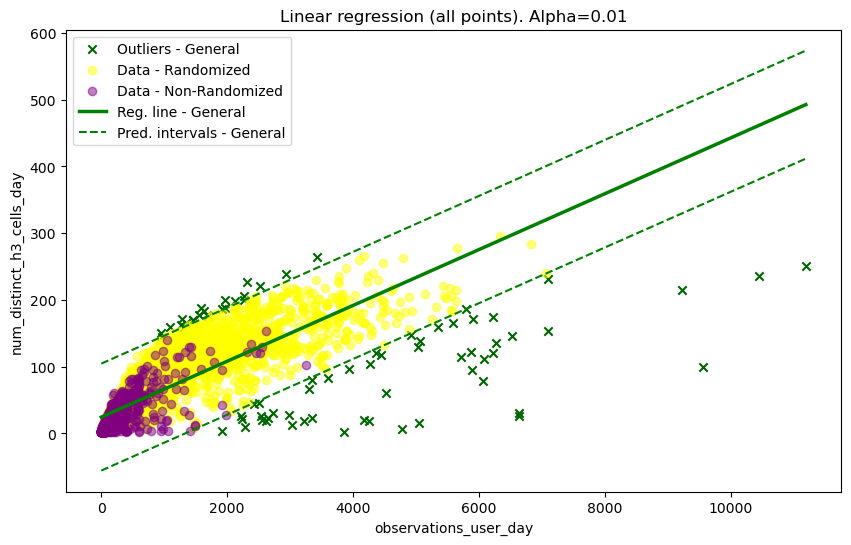

,vendor_name,macaddr_randomized,anonymized_macaddr,label_day,observations_user_day,timespan_minutes_day,num_distinct_h3_cells_day,observations_per_cell,observations_per_minute,minutes_per_cell,log_num_distinct_h3_cells_day,log_observations_user_day,log_timespan_minutes_day,outlier_lin_reg
3270,None,1,f8c3da1fb9c5edeb6702dc113a5b8f2733612db9bb6d40...,2,3862,618.800000,2,1931.000000,6.241112,309.400000,0.693147,8.258940,6.427782,yes
1853,Liteon Technology Corporation,0,29feeae114d6372841f9fead698404b82a5e0091cb407e...,2,1926,461.716667,3,642.000000,4.171389,153.905556,1.098612,7.563201,6.134951,yes
3027,"Hon Hai Precision Ind. Co.,Ltd.",0,d1c6cd9c716c91c9b0169f10aeaec3f34192e2c530f2f6...,2,4779,746.383333,6,796.500000,6.402876,124.397222,1.791759,8.471987,6.615239,yes
3219,CLOUD NETWORK TECHNOLOGY SINGAPORE PTE. LTD.,0,f1e111e3f744bfdb10cc96f7f28cd419dccbd2dd2e48aa...,2,2284,529.483333,9,253.777778,4.313639,58.831481,2.197225,7.733684,6.271902,yes
4212,"Samsung Electronics Co.,Ltd",0,9168f8f97f5b9dfe6d004ac95553b3e6a402d7316b3a2b...,3,3029,619.333333,13,233.000000,4.890743,47.641026,2.564949,8.015988,6.428644,yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3182,None,1,eb9a3a265d543758733d0631ff3298f02441b2bb1784bb...,2,4791,716.766667,263,18.216730,6.684184,2.725349,5.572154,8.474494,6.574750,no
3629,None,1,2f66e446e77bc98a839d98d598ed97bdb0c61c71b8b564...,3,4175,585.183333,265,15.754717,7.134516,2.208239,5.579730,8.336870,6.371925,no
1569,None,1,fe212f2681c8a322a1201f2f67381bba4f9f2a814f9253...,1,5648,733.516667,277,20.389892,7.699893,2.648075,5.624018,8.639057,6.597850,no
517,None,1,550d54afaece379a6056c40f9a30d16ef395b8531cc2f2...,1,6819,812.950000,284,24.010563,8.387970,2.862500,5.648974,8.827468,6.700670,no


In [225]:
outliers_cells_vs_obs_all_day = outliers_linear_models(df_users_info=info_per_user_day_filtered_df,
                                                   x_variable='observations_user_day', y_variable='num_distinct_h3_cells_day',
                                                   reg_type = 'all points', alpha=0.01,
                                                   show_eval_metrics=True).sort_values(by=['outlier_lin_reg','num_distinct_h3_cells_day'], ascending=[False,True])
outliers_cells_vs_obs_all_day

##### Combined regression (log-log)

The previous approach seems to flag outliers reasonably, interpretation-wise. However, there is some heteroscedasticity in the residuals and the quality of the regression might be improved. For this reason, I try a log-log regression, which has a better fit, stabilizes the variance and preserves the outlier detection principles (flagging rather static MAC addresses).

--------------------------------------------------------------------
Regression assessment metrics for  regression:
                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.857
Model:                            OLS   Adj. R-squared:                  0.857
Method:                 Least Squares   F-statistic:                 2.918e+04
Date:                Wed, 29 Jan 2025   Prob (F-statistic):               0.00
Time:                        12:52:07   Log-Likelihood:                -3435.9
No. Observations:                4861   AIC:                             6876.
Df Residuals:                    4859   BIC:                             6889.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
---------------

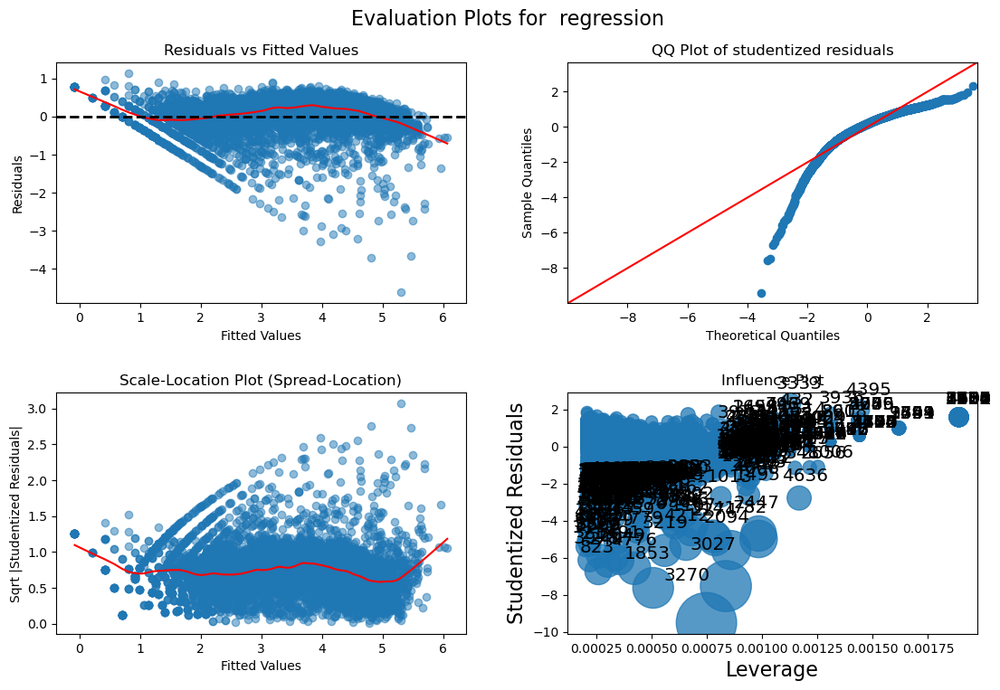

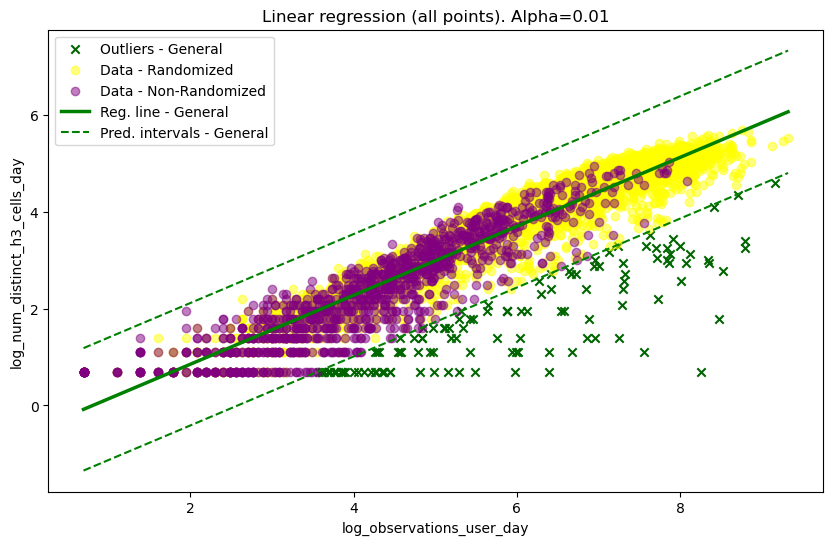

,vendor_name,macaddr_randomized,anonymized_macaddr,label_day,observations_user_day,timespan_minutes_day,num_distinct_h3_cells_day,observations_per_cell,observations_per_minute,minutes_per_cell,log_num_distinct_h3_cells_day,log_observations_user_day,log_timespan_minutes_day,outlier_lin_reg
4636,None,1,d66de586a6156cec8e9e53c1c078aa86b50073852a0631...,3,9561,344.916667,99,96.575758,27.719739,3.484007,4.595120,9.165448,5.843303,yes
1495,Liteon Technology Corporation,0,f238a5a35718431c7e94e5a5daf62cdb6cbba247a18946...,1,6056,743.216667,78,77.641026,8.148364,9.528419,4.356709,8.708805,6.610988,yes
1013,None,1,a02c430d020254bd5a6c8c9ce472c43eaac5e9bd3a949b...,1,4531,686.100000,60,75.516667,6.603994,11.435000,4.094345,8.418698,6.531023,yes
1946,None,1,372e600ef741e6e90e23dafb0d6b260053a4cbb09f7302...,2,2058,647.950000,34,60.529412,3.176171,19.057353,3.526361,7.629490,6.473814,yes
4162,None,1,894cfad950f48f9ec373d38cf9da6d303706e4fd574cc3...,3,2732,571.666667,31,88.129032,4.779009,18.440860,3.433987,7.912789,6.348556,yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4608,Liteon Technology Corporation,0,d20be60462bc10eb681fc0ac9a9b1dacccfcfe4f30b83a...,3,6,50.733333,2,3.000000,0.118265,25.366667,0.693147,1.791759,3.926583,no
4618,"Hon Hai Precision Ind. Co.,Ltd.",0,d400c9f81d4d63f6ca52151a5077ed2d8e098d10b4c0f4...,3,9,99.783333,2,4.500000,0.090195,49.891667,0.693147,2.197225,4.603001,no
4713,"Apple, Inc.",0,e47fe098f4214f53dc1ccbcd1e435a47cdc60194faec7f...,3,7,71.150000,2,3.500000,0.098384,35.575000,0.693147,1.945910,4.264790,no
4792,Xiaomi Communications Co Ltd,0,f42966937805829ebbe96f88f9c8434771a1716de5e0ba...,3,6,100.966667,2,3.000000,0.059426,50.483333,0.693147,1.791759,4.614790,no


In [226]:
outliers_logcells_vs_logobs_all_day = outliers_linear_models(df_users_info=info_per_user_day_filtered_df,
                                                         x_variable='log_observations_user_day', y_variable='log_num_distinct_h3_cells_day',
                                                         reg_type = 'all points', alpha=0.01,
                                                         show_eval_metrics=True).sort_values(by=['outlier_lin_reg','num_distinct_h3_cells_day'], ascending=[False,False])
outliers_logcells_vs_logobs_all_day

##### Separate regression (log-log)

Just for completeness, I also fit the log-log version of the regression for the two types of MAC address separately. However, this method is more strict with randomized users than with non-randomized elements, but from the visual inspection of these experiments, it seems that many of the non-randomized MAC addresses correspond to non-mobile devices from the organization (access points, laptops, POS terminals, etc.), while randomized MAC addressess observations seem reasonable for human mobile devices (smartphones and smartwatches).

--------------------------------------------------------------------
Regression assessment metrics for  regression:
                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.879
Model:                            OLS   Adj. R-squared:                  0.879
Method:                 Least Squares   F-statistic:                 2.607e+04
Date:                Wed, 29 Jan 2025   Prob (F-statistic):               0.00
Time:                        12:52:20   Log-Likelihood:                -1796.6
No. Observations:                3587   AIC:                             3597.
Df Residuals:                    3585   BIC:                             3610.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
---------------

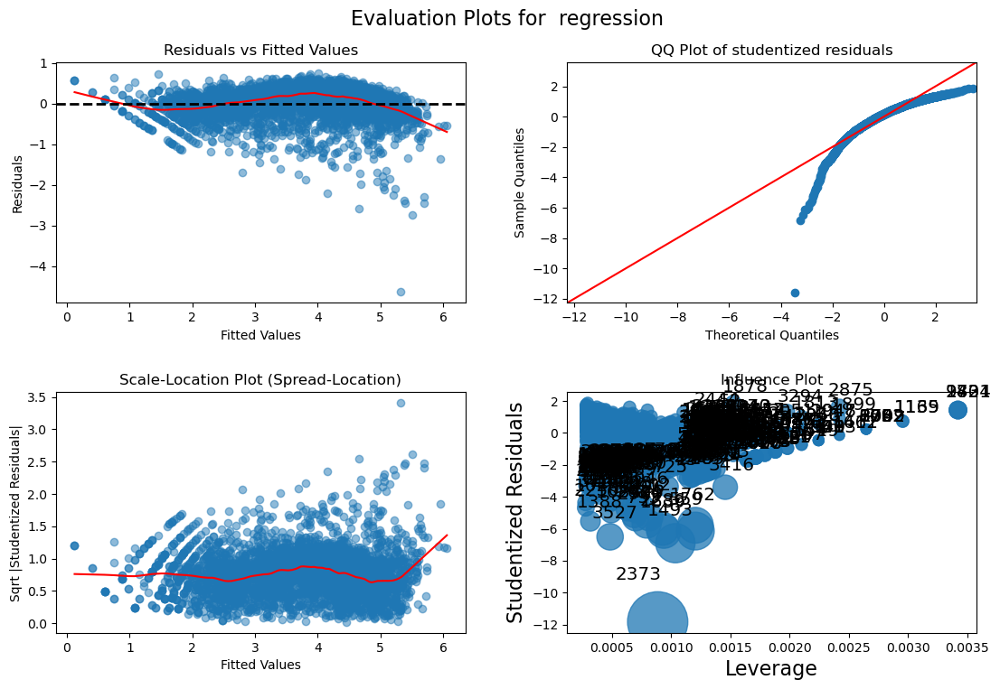

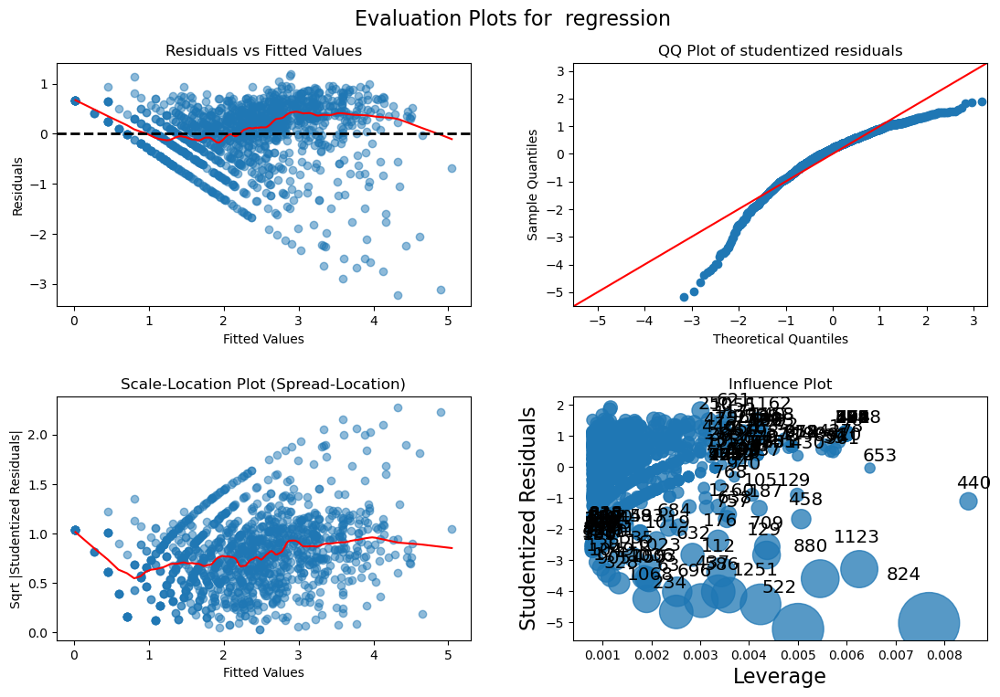

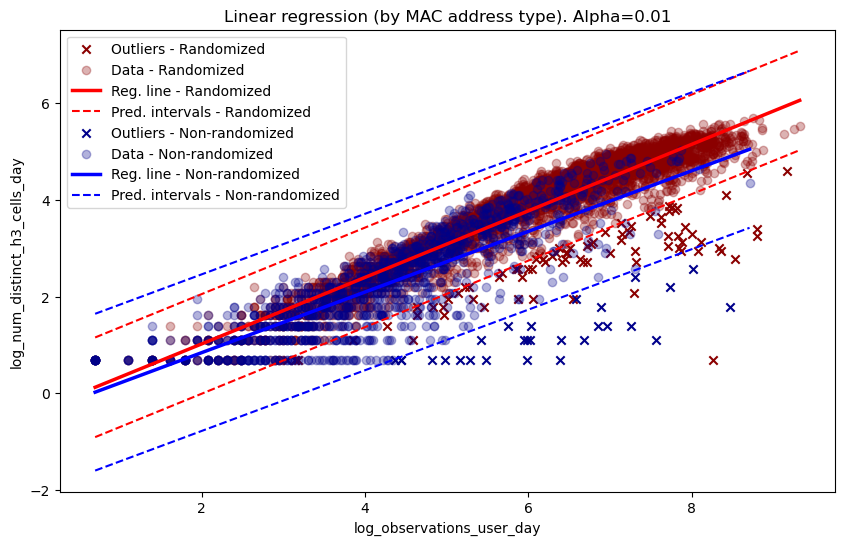

,vendor_name,macaddr_randomized,anonymized_macaddr,label_day,observations_user_day,timespan_minutes_day,num_distinct_h3_cells_day,observations_per_cell,observations_per_minute,minutes_per_cell,log_num_distinct_h3_cells_day,log_observations_user_day,log_timespan_minutes_day,outlier_lin_reg
3416,None,1,d66de586a6156cec8e9e53c1c078aa86b50073852a0631...,3,9561,344.916667,99,96.575758,27.719739,3.484007,4.595120,9.165448,5.843303,yes
3397,None,1,d1c8baa62e442380e7df2a201a77a5dafb8172f9509674...,3,5885,558.783333,95,61.947368,10.531810,5.881930,4.553877,8.680162,6.325762,yes
725,None,1,a02c430d020254bd5a6c8c9ce472c43eaac5e9bd3a949b...,1,4531,686.100000,60,75.516667,6.603994,11.435000,4.094345,8.418698,6.531023,yes
2519,None,1,15953ec924ff18e12638ebbb2609fb3a03574b51539f8e...,3,2249,144.650000,48,46.854167,15.547874,3.013542,3.871201,7.718241,4.974317,yes
602,None,1,894cfad950f48f9ec373d38cf9da6d303706e4fd574cc3...,1,2344,467.283333,47,49.872340,5.016229,9.942199,3.850148,7.759614,6.146936,yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4800,"Hon Hai Precision Ind. Co.,Ltd.",0,d400c9f81d4d63f6ca52151a5077ed2d8e098d10b4c0f4...,3,9,99.783333,2,4.500000,0.090195,49.891667,0.693147,2.197225,4.603001,no
4817,"SparkLAN Communications, Inc.",0,dfbad6efc323f922f4941923f534e1f15fe2cc972dbb0e...,3,77,472.066667,2,38.500000,0.163113,236.033333,0.693147,4.343805,6.157120,no
4826,"Apple, Inc.",0,e47fe098f4214f53dc1ccbcd1e435a47cdc60194faec7f...,3,7,71.150000,2,3.500000,0.098384,35.575000,0.693147,1.945910,4.264790,no
4841,Xiaomi Communications Co Ltd,0,f42966937805829ebbe96f88f9c8434771a1716de5e0ba...,3,6,100.966667,2,3.000000,0.059426,50.483333,0.693147,1.791759,4.614790,no


In [227]:
outliers_logcells_vs_logobs_split_day = outliers_linear_models(df_users_info=info_per_user_day_filtered_df,
                                                         x_variable='log_observations_user_day', y_variable='log_num_distinct_h3_cells_day',
                                                         reg_type = 'by MAC address type', alpha=0.01,
                                                         show_eval_metrics=True).sort_values(by=['outlier_lin_reg','num_distinct_h3_cells_day'], ascending=[False,False])
outliers_logcells_vs_logobs_split_day

##### Choosing the method

After the regressions, I manually searched about all the available vendors (on the internet) and identified some of them that are surely not related with smartphones nor smartwatches (more on that below).

In [228]:
print('Number of outliers found with the outliers_logcells_vs_logobs_all_day method:')
duckdb_conn.sql("""SELECT macaddr_randomized, vendor_name, COUNT(*) as outlier_count 
                FROM outliers_logcells_vs_logobs_all_day 
                WHERE outlier_lin_reg = 'yes'
                GROUP BY macaddr_randomized, vendor_name
                ORDER BY outlier_count DESC""")

Number of outliers found with the outliers_logcells_vs_logobs_all_day method:


┌────────────────────┬──────────────────────────────────────────────┬───────────────┐
│ macaddr_randomized │                 vendor_name                  │ outlier_count │
│       int64        │                   varchar                    │     int64     │
├────────────────────┼──────────────────────────────────────────────┼───────────────┤
│                  1 │ NULL                                         │            35 │
│                  0 │ Apple, Inc.                                  │            12 │
│                  0 │ Liteon Technology Corporation                │             9 │
│                  0 │ AzureWave Technology Inc.                    │             9 │
│                  0 │ Samsung Electronics Co.,Ltd                  │             7 │
│                  0 │ CLOUD NETWORK TECHNOLOGY SINGAPORE PTE. LTD. │             6 │
│                  0 │ Wistron Neweb Corporation                    │             6 │
│                  0 │ HUAWEI TECHNOLOGIES CO.,LTD    

In [229]:
print('Number of outliers found with the outliers_logcells_vs_logobs_split_day method:')
duckdb_conn.sql("""SELECT macaddr_randomized, vendor_name, COUNT(*) as outlier_count 
                FROM outliers_logcells_vs_logobs_split_day 
                WHERE outlier_lin_reg = 'yes'
                GROUP BY macaddr_randomized, vendor_name
                ORDER BY outlier_count DESC""")

Number of outliers found with the outliers_logcells_vs_logobs_split_day method:


┌────────────────────┬──────────────────────────────────────────────┬───────────────┐
│ macaddr_randomized │                 vendor_name                  │ outlier_count │
│       int64        │                   varchar                    │     int64     │
├────────────────────┼──────────────────────────────────────────────┼───────────────┤
│                  1 │ NULL                                         │            83 │
│                  0 │ CLOUD NETWORK TECHNOLOGY SINGAPORE PTE. LTD. │             6 │
│                  0 │ AzureWave Technology Inc.                    │             5 │
│                  0 │ Apple, Inc.                                  │             4 │
│                  0 │ Liteon Technology Corporation                │             3 │
│                  0 │ Wistron Neweb Corporation                    │             3 │
│                  0 │ Murata Manufacturing Co., Ltd.               │             2 │
│                  0 │ EDUP INTERNATIONAL (HK) CO., LT

I choose the **log-log regression with all the data** because, as mentioned before, it is better for identifying those kind of MAC addresses, that probably correspond to rather static devices from the Fira or some of the workers of the festival.

Also, based on the previous explanation, I specifically remove any of the MAC addresses that correspond to the companies that are highly unlikely to be related to smartphones or smartwatches but could have been left in the dataset after the outlier detection.

Applying the outlier removal and the filter by the non--mobile related vendors.

In [230]:
print('MAC address count pre-outlier removal (Sónar by day)')
duckdb_conn.sql("""
                SELECT macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                FROM info_per_user_day_filtered_df
                GROUP BY macaddr_randomized

                UNION ALL

                SELECT 'Total' AS macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                FROM info_per_user_day_filtered_df
                """)

MAC address count pre-outlier removal (Sónar by day)


┌────────────────────┬───────────────────┐
│ macaddr_randomized │ unique_user_count │
│      varchar       │       int64       │
├────────────────────┼───────────────────┤
│ 0                  │               866 │
│ 1                  │              2009 │
│ Total              │              2875 │
└────────────────────┴───────────────────┘

In [231]:
info_per_user_day_filter_outliers = duckdb_conn.sql(F"""
                                                SELECT *
                                                FROM outliers_logcells_vs_logobs_all_day
                                                WHERE outlier_lin_reg = 'no'
                                                """) 

Checking the counts after the outliers removal.

In [232]:
locations_day_filtered = duckdb_conn.sql("""
                                            SELECT ln.*
                                            FROM locations_day_filtered ln
                                            JOIN info_per_user_day_filter_outliers iun
                                                ON ln.macaddr_randomized = iun.macaddr_randomized
                                                    AND ln.anonymized_macaddr = iun.anonymized_macaddr
                                                    AND ln.label_day = iun.label_day
                                             """)

print(f'Number of records Sónar by day (after outlier removal):')
display(duckdb_conn.sql("""
                        SELECT macaddr_randomized, COUNT(*) AS total_records
                        FROM locations_day_filtered
                        GROUP BY macaddr_randomized

                        UNION ALL

                        SELECT 'Total' AS macaddr_randomized, COUNT(*) AS total_records
                        FROM locations_day_filtered
                        """))


print(f'Unique macadresses Sónar by day (after outlier removal):')
display(duckdb_conn.sql("""
                        SELECT macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                        FROM locations_day_filtered
                        GROUP BY macaddr_randomized

                        UNION ALL

                        SELECT 'Total' AS macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                        FROM locations_day_filtered
                        """))

Number of records Sónar by day (after outlier removal):


┌────────────────────┬───────────────┐
│ macaddr_randomized │ total_records │
│      varchar       │     int64     │
├────────────────────┼───────────────┤
│ 1                  │       3252522 │
│ 0                  │        204097 │
│ Total              │       3456619 │
└────────────────────┴───────────────┘

Unique macadresses Sónar by day (after outlier removal):


┌────────────────────┬───────────────────┐
│ macaddr_randomized │ unique_user_count │
│      varchar       │       int64       │
├────────────────────┼───────────────────┤
│ 0                  │               816 │
│ 1                  │              1998 │
│ Total              │              2814 │
└────────────────────┴───────────────────┘

In [233]:
del info_per_user_day_filtered_df

#### Filtering extreme observations values

In [234]:
info_per_user_day_filter_outliers_df = info_per_user_day_filter_outliers.to_df()

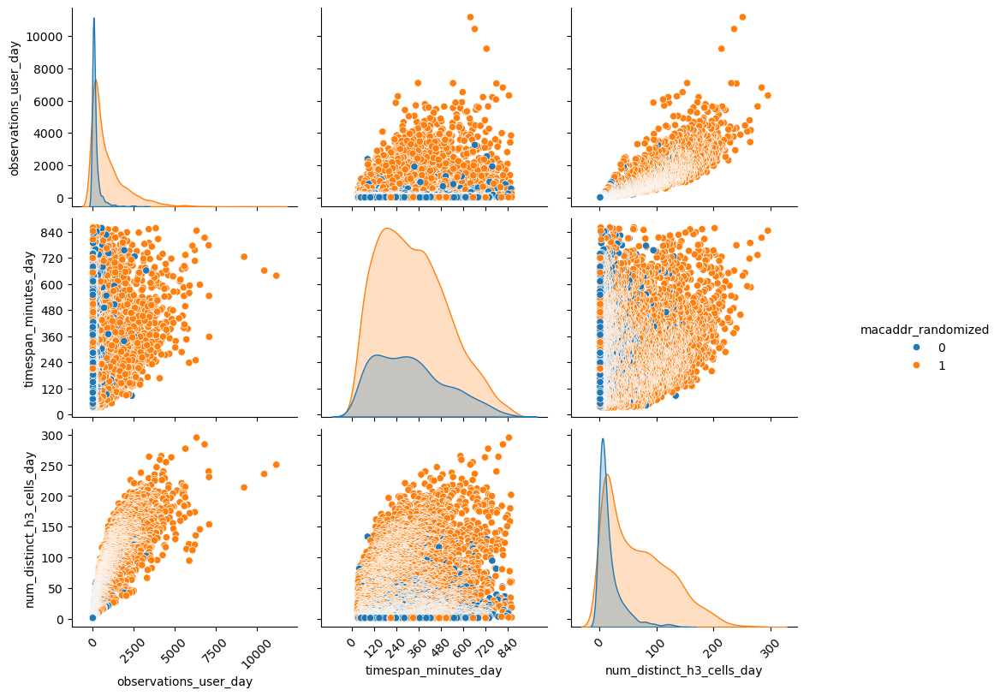

In [235]:
plot_pairplot(info_per_user_day_filter_outliers_df, sonar_type='day', filename_to_save=None)
#filename_to_save='day_pairplot_filter_outliers.png'

The observations and the distinct cells distributions still have a high density in the first part of the distribution but have a wide range of values. Based on this observation and the regression results, it may be useful to visualize these variables with a logarithmic scale.

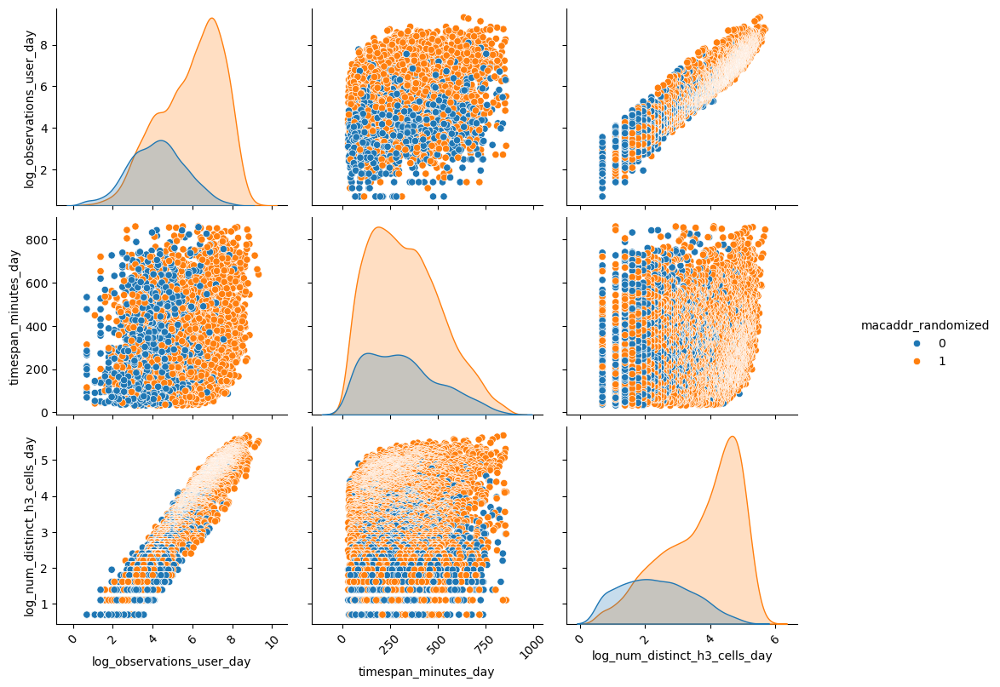

In [236]:
plot_pairplot(info_per_user_day_filter_outliers_df, columns=['log_observations_user_day', 'timespan_minutes_day', 'log_num_distinct_h3_cells_day','macaddr_randomized'],
              filename_to_save=None)
#filename_to_save='day_pairplot_filter_outliers_log.png'

This way, it is easier to visualize the range of values of those two variables. In the two, there is a bimodality in the randomized users, while non-randomized MAC addresses have a bell-like shape. Continuing the logic used for the regressions, I want to treat both groups (randomized and non-randomized) as a single one, even though their densities look different. The reason for this is to try to identify extreme values overall and treat the resulting MAC addresses as "users". In any case, the clustering algorithms should be able to identify relevant patterns and noise in the subsequent steps.

In [237]:
# Creating a violin plot
fig = px.violin(
    info_per_user_day_filter_outliers_df,
    x='label_day',
    y='log_observations_user_day',
    #color='macaddr_randomized',  
    box=True,  
    points='outliers',  
    title=f'Distribution of observations per user (Sónar by day). Filtered with outliers',
    category_orders={"macaddr_randomized": [0, 1]})

# Updating the layout
fig.update_layout(
    xaxis_title='Day of the festival',
    yaxis_title='Observations per user',
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14)

fig.show()
#fig.write_html(os.path.join(path_interactive_plots,'day_observations_violin_filter_outliers.html'))

In [238]:
# Creating a histogram
fig = px.histogram(
    info_per_user_day_filter_outliers_df,
    x="log_observations_user_day",
    #color="macaddr_randomized",
    facet_row="label_day",
    nbins=100,
    title=f"Distribution of observations per user (Sónar by day). Filtered with outliers",
    category_orders={"macaddr_randomized": [0, 1]})

# Updating the layout
fig.update_layout(
    xaxis_title="Observations per user",
    yaxis_title="Users",
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14)

# Showing the plot
fig.show()
#fig.write_html(os.path.join(path_interactive_plots,'day_observations_hist_filter_outliers.html'))

Checking where the percentiles fall with respect to the logarithmic scale. I also check the equivalent value in the original scale.

Note: as the percentiles are based on the rank (ordering) of the data, changing the scale does not change the relative values of the percentiles.

In [239]:
print('Log-observations per user Sónar by day (filtered with the outliers):')
log_observations_percentiles_no_outliers_day = duckdb_conn.query("""
                                                              SELECT 
                                                                MIN(log_observations_user_day) AS min_conf_f,
                                                                PERCENTILE_CONT(0.025) WITHIN GROUP(ORDER BY log_observations_user_day) AS p025_observations_user,
                                                                PERCENTILE_CONT(0.05) WITHIN GROUP(ORDER BY log_observations_user_day) AS p05_observations_user,
                                                                PERCENTILE_CONT(0.10) WITHIN GROUP(ORDER BY log_observations_user_day) AS p10_observations_user,
                                                                PERCENTILE_CONT(0.25) WITHIN GROUP(ORDER BY log_observations_user_day) AS p25_observations_user,
                                                                PERCENTILE_CONT(0.50) WITHIN GROUP(ORDER BY log_observations_user_day) AS median_observations_user,
                                                                PERCENTILE_CONT(0.75) WITHIN GROUP(ORDER BY log_observations_user_day) AS p75_observations_user,
                                                                PERCENTILE_CONT(0.90) WITHIN GROUP(ORDER BY log_observations_user_day) AS p90_observations_user,
                                                                PERCENTILE_CONT(0.95) WITHIN GROUP(ORDER BY log_observations_user_day) AS p95_observations_user,
                                                                MAX(log_observations_user_day) AS max_observations_user
                                                              FROM info_per_user_day_filter_outliers_df""")
log_observations_percentiles_no_outliers_day

Log-observations per user Sónar by day (filtered with the outliers):


┌────────────────────┬────────────────────────┬───────────────────────┬───────────────────────┬───────────────────────┬──────────────────────────┬───────────────────────┬───────────────────────┬───────────────────────┬───────────────────────┐
│     min_conf_f     │ p025_observations_user │ p05_observations_user │ p10_observations_user │ p25_observations_user │ median_observations_user │ p75_observations_user │ p90_observations_user │ p95_observations_user │ max_observations_user │
│       double       │         double         │        double         │        double         │        double         │          double          │        double         │        double         │        double         │        double         │
├────────────────────┼────────────────────────┼───────────────────────┼───────────────────────┼───────────────────────┼──────────────────────────┼───────────────────────┼───────────────────────┼───────────────────────┼───────────────────────┤
│ 0.6931471805599453 │     2

In [240]:
print('Observations per user Sónar by day (filtered with the outliers):')
duckdb_conn.query("""
                  SELECT
                    MIN(observations_user_day) AS min_observations_user,
                    PERCENTILE_CONT(0.025) WITHIN GROUP(ORDER BY observations_user_day) AS p025_observations_user,
                    PERCENTILE_CONT(0.05) WITHIN GROUP(ORDER BY observations_user_day) AS p05_observations_user,
                    PERCENTILE_CONT(0.10) WITHIN GROUP(ORDER BY observations_user_day) AS p10_observations_user,
                    PERCENTILE_CONT(0.25) WITHIN GROUP(ORDER BY observations_user_day) AS p25_observations_user,
                    PERCENTILE_CONT(0.50) WITHIN GROUP(ORDER BY observations_user_day) AS median_observations_user,
                    PERCENTILE_CONT(0.75) WITHIN GROUP(ORDER BY observations_user_day) AS p75_observations_user,
                    PERCENTILE_CONT(0.90) WITHIN GROUP(ORDER BY observations_user_day) AS p90_observations_user,
                    PERCENTILE_CONT(0.95) WITHIN GROUP(ORDER BY observations_user_day) AS p95_observations_user,
                    MAX(observations_user_day) AS max_observations_user
                  FROM info_per_user_day_filter_outliers_df""")

Observations per user Sónar by day (filtered with the outliers):


┌───────────────────────┬────────────────────────┬───────────────────────┬───────────────────────┬───────────────────────┬──────────────────────────┬───────────────────────┬───────────────────────┬───────────────────────┬───────────────────────┐
│ min_observations_user │ p025_observations_user │ p05_observations_user │ p10_observations_user │ p25_observations_user │ median_observations_user │ p75_observations_user │ p90_observations_user │ p95_observations_user │ max_observations_user │
│         int64         │         double         │        double         │        double         │        double         │          double          │        double         │        double         │        double         │         int64         │
├───────────────────────┼────────────────────────┼───────────────────────┼───────────────────────┼───────────────────────┼──────────────────────────┼───────────────────────┼───────────────────────┼───────────────────────┼───────────────────────┤
│               

I check how the MAC addresses below the p025 of observations look (for both randomized and non-randomized addresses).

In [241]:
# TODO: chequear qué thresholds usar
users_few_observations_day = duckdb_conn.sql(f"""
                                            SELECT *
                                            FROM info_per_user_day_filter_outliers_df
                                            WHERE log_observations_user_day < (SELECT p025_observations_user FROM log_observations_percentiles_no_outliers_day)
                                        """)

In [242]:
users_few_observations_day.to_df().describe()

,macaddr_randomized,label_day,observations_user_day,timespan_minutes_day,num_distinct_h3_cells_day,observations_per_cell,observations_per_minute,minutes_per_cell,log_num_distinct_h3_cells_day,log_observations_user_day,log_timespan_minutes_day
count,106.000000,106.000000,106.000000,106.000000,106.000000,106.000000,106.000000,106.000000,106.000000,106.000000,106.000000
mean,0.330189,1.886792,5.160377,252.057862,2.452830,2.173899,0.036528,110.799381,0.855397,1.537800,5.262026
std,0.472515,0.784623,2.116317,178.895890,0.840998,0.915559,0.034806,84.433167,0.269843,0.484479,0.768142
min,0.000000,1.000000,2.000000,40.983333,2.000000,1.000000,0.003751,14.161111,0.693147,0.693147,3.713165
25%,0.000000,1.000000,4.000000,111.512500,2.000000,1.350000,0.010244,44.179167,0.693147,1.386294,4.714055
50%,0.000000,2.000000,5.000000,200.075000,2.000000,2.000000,0.025236,86.555556,0.693147,1.609438,5.298689
75%,1.000000,2.750000,7.000000,359.425000,3.000000,2.916667,0.049310,154.670833,1.098612,1.945910,5.884481
max,1.000000,3.000000,8.000000,726.383333,7.000000,4.000000,0.188309,360.000000,1.945910,2.079442,6.588078


Removing the values below the from the p025 as a way to avoid losing too much data, but excluding meaningless too-short trajectories (with too few observations). I tried removing outliers with the Tukey's method on both the logarithmic scale and the original scale, but the former just removes trajectories with less that 3 observations, while the latter only removes points with many observations, which might still provide valuable information (again, the clustering algorithms should be able to detect noise if necessary).

In [243]:
info_per_user_day_filter_extreme_obs = duckdb_conn.sql("""
                                                    SELECT *
                                                    FROM info_per_user_day_filter_outliers_df
                                                    WHERE log_observations_user_day >= (SELECT p025_observations_user FROM log_observations_percentiles_no_outliers_day)
                                                    """).to_df()


Checking the new filtered distribution.

In [244]:
# Creating a violin plot
fig = px.violin(
    info_per_user_day_filter_extreme_obs,
    x='label_day',
    y='log_observations_user_day',
    #color='macaddr_randomized',  
    box=True,  
    points='outliers',  
    title=f'Distribution of observations per user (Sónar by day). Extremely scarse trajectories removed',
    category_orders={"macaddr_randomized": [0, 1]})

# Updating the layout
fig.update_layout(
    xaxis_title='Day of the festival',
    yaxis_title='Observations per user',
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14)

fig.show()
#fig.write_html(os.path.join(path_interactive_plots,'day_observations_violin_filter_outliers.html'))

This would be the final, filtered dataset for Sónar by Night, so I apply the changes.

In [245]:
locations_day_filtered = duckdb_conn.sql("""
                                            SELECT ln.*
                                            FROM locations_day_filtered ln
                                            JOIN info_per_user_day_filter_extreme_obs iun
                                                ON ln.macaddr_randomized = iun.macaddr_randomized
                                                    AND ln.anonymized_macaddr = iun.anonymized_macaddr
                                                    AND ln.label_day = iun.label_day
                                             """)

print(f'Number of records Sónar by day (after extremely scarse trajectories removal):')
display(duckdb_conn.sql("""
                        SELECT macaddr_randomized, COUNT(*) AS total_records
                        FROM locations_day_filtered
                        GROUP BY macaddr_randomized

                        UNION ALL

                        SELECT 'Total' AS macaddr_randomized, COUNT(*) AS total_records
                        FROM locations_day_filtered
                        """))


print(f'Unique macadresses Sónar by day (after extremely scarse trajectories removal):')
display(duckdb_conn.sql("""
                        SELECT macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                        FROM locations_day_filtered
                        GROUP BY macaddr_randomized

                        UNION ALL

                        SELECT 'Total' AS macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                        FROM locations_day_filtered
                        """))

Number of records Sónar by day (after extremely scarse trajectories removal):


┌────────────────────┬───────────────┐
│ macaddr_randomized │ total_records │
│      varchar       │     int64     │
├────────────────────┼───────────────┤
│ 1                  │       3252325 │
│ 0                  │        203747 │
│ Total              │       3456072 │
└────────────────────┴───────────────┘

Unique macadresses Sónar by day (after extremely scarse trajectories removal):


┌────────────────────┬───────────────────┐
│ macaddr_randomized │ unique_user_count │
│      varchar       │       int64       │
├────────────────────┼───────────────────┤
│ 0                  │               769 │
│ 1                  │              1985 │
│ Total              │              2754 │
└────────────────────┴───────────────────┘

In [246]:
info_per_user_day_filter_extreme_obs.describe()

,macaddr_randomized,label_day,observations_user_day,timespan_minutes_day,num_distinct_h3_cells_day,observations_per_cell,observations_per_minute,minutes_per_cell,log_num_distinct_h3_cells_day,log_observations_user_day,log_timespan_minutes_day
count,4636.000000,4636.000000,4636.000000,4636.000000,4636.000000,4636.000000,4636.000000,4636.000000,4636.000000,4636.000000,4636.000000
mean,0.758628,1.996549,745.485764,328.861821,57.473684,10.117459,2.781382,20.818803,3.454534,5.597667,5.595198
std,0.427961,0.800478,1038.147094,185.899465,54.077378,6.807344,3.603260,34.137299,1.235085,1.595253,0.692361
min,0.000000,1.000000,9.000000,31.016667,2.000000,1.555556,0.016244,0.502846,0.693147,2.197225,3.434525
25%,1.000000,1.000000,73.000000,177.629167,12.000000,5.625000,0.274233,2.753899,2.484907,4.290459,5.179698
50%,1.000000,2.000000,303.000000,307.741667,39.000000,7.980257,1.133905,7.332987,3.663562,5.713733,5.729261
75%,1.000000,3.000000,1014.000000,455.808333,93.000000,12.504850,3.970365,23.116270,4.532599,6.921658,6.122072
max,1.000000,3.000000,11190.000000,860.733333,295.000000,61.947368,27.625314,369.375000,5.686975,9.322776,6.757785


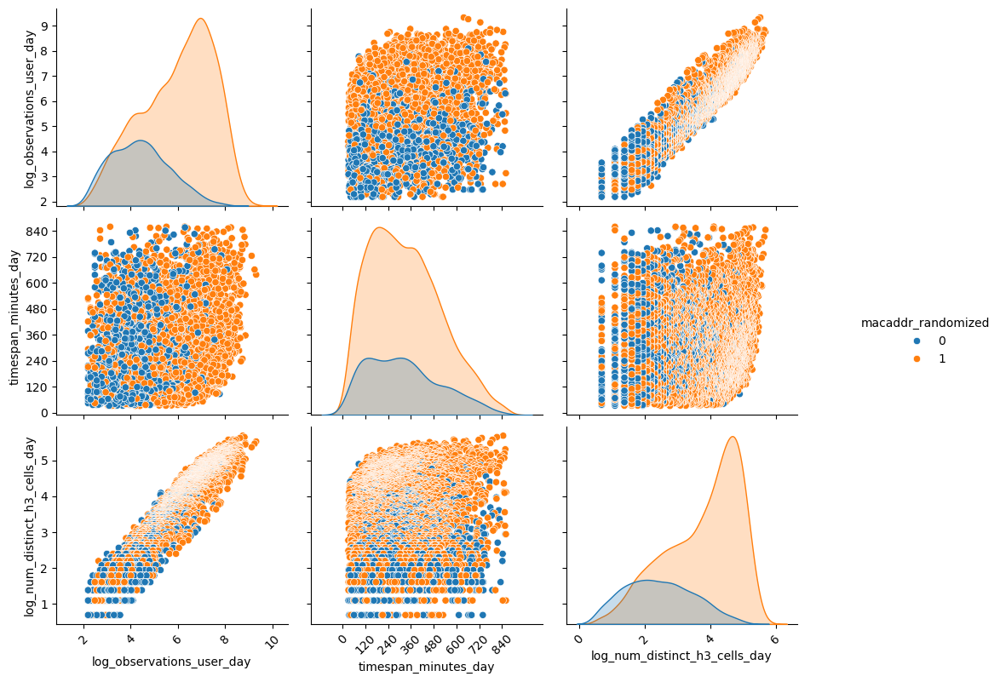

In [247]:
plot_pairplot(info_per_user_day_filter_extreme_obs, sonar_type='day', columns=['log_observations_user_day', 'timespan_minutes_day', 'log_num_distinct_h3_cells_day','macaddr_randomized'])

#### Removing duplicates

In [248]:
# Checking the count without filtering
pre_duplicate_filter_count_day = duckdb_conn.sql("""
                            SELECT COUNT(*)
                            FROM locations_day_filtered
                            """).fetchone()[0]
print(f'Before removing duplicates, there are {pre_duplicate_filter_count_day} observations')

Before removing duplicates, there are 3456072 observations


In [249]:
locations_night_filtered.columns

['anonymized_macaddr',
 'macaddr_randomized',
 'timestamp_ap',
 'h3_cell',
 'client_latitude',
 'client_longitude',
 'timestamp_wizzie',
 'location_name',
 'slug',
 'rssi',
 'confidence_factor',
 'vendor_name',
 'sonar_type',
 'label_night',
 'observations_user_night',
 'timespan_minutes_night',
 'num_distinct_h3_cells_night']

In [250]:
# Checking the duplicates taking every column of interest into account
distinct_all_columns_day = duckdb_conn.sql("""
                                        SELECT DISTINCT 
                                                        anonymized_macaddr, macaddr_randomized,
                                                        timestamp_ap, 
                                                        h3_cell, client_latitude, client_longitude,
                                                        timestamp_wizzie,
                                                        location_name, slug,
                                                        rssi,
                                                        confidence_factor,
                                                        vendor_name
                                                    FROM locations_day_filtered""")

distinct_all_columns_count_day = duckdb_conn.sql("SELECT COUNT(*) FROM distinct_all_columns_day").fetchone()[0]

print(f'There are {pre_duplicate_filter_count_day - distinct_all_columns_count_day} duplicates, considering all columns of interest (both timestamp_ap and timestamp_wizzie)')

There are 282 duplicates, considering all columns of interest (both timestamp_ap and timestamp_wizzie)


In [251]:
del distinct_all_columns_count_day

As mentioned in `2. preprocessing_dataset_reduction.ipynb`, according to what I was told, there is a difference between timestamp_wizzie (the time when the observation was received by the Wizzie system) and timestamp_ap (the time when the observation was received by the access point (AP)). There is a difference between the two, which is usually small, but not always (check the plot in the interactive plots folder).

I checked, and considering timestamp_wizzie instead of timestamp_ap would result in more duplicates, that would probably be associated with lags in the system, not actual duplicates. For this reason, it is safer to use timestamp_ap.

In [252]:
# Checking the duplicates if I consider timestamp_ap
duckdb_conn.sql("""
    SELECT *,
            COUNT(*) OVER (PARTITION BY 
                                anonymized_macaddr, macaddr_randomized,
                                                        timestamp_ap, 
                                                        h3_cell, client_latitude, client_longitude,
                                                        location_name, slug,
                                                        rssi,
                                                        confidence_factor,
                                                        vendor_name
                            ) AS duplicate_count
    FROM locations_day_filtered
    ORDER BY duplicate_count desc""")

┌──────────────────────────────────────────────────────────────────┬────────────────────┬──────────────┬─────────────────┬────────────────────┬────────────────────┬──────────────────┬───────────────┬─────────┬────────┬───────────────────┬─────────────┬────────────┬───────────┬───────────────────────┬──────────────────────┬───────────────────────────┬─────────────────┐
│                        anonymized_macaddr                        │ macaddr_randomized │ timestamp_ap │     h3_cell     │  client_latitude   │  client_longitude  │ timestamp_wizzie │ location_name │  slug   │  rssi  │ confidence_factor │ vendor_name │ sonar_type │ label_day │ observations_user_day │ timespan_minutes_day │ num_distinct_h3_cells_day │ duplicate_count │
│                             varchar                              │       int64        │    int64     │     varchar     │       double       │       double       │      int64       │    varchar    │ varchar │ double │      double       │   varchar   │  varc

Also, it is worth mentioning that in reality, a person should only be at a given moment in a single place, so I can check how duplicates based on that criterion look:

In [253]:
duckdb_conn.sql("""
    SELECT *,
            COUNT(*) OVER (PARTITION BY 
                                anonymized_macaddr, macaddr_randomized,
                                timestamp_ap
                            ) AS duplicate_count
    FROM locations_day_filtered
    ORDER BY duplicate_count desc""")

┌──────────────────────────────────────────────────────────────────┬────────────────────┬──────────────┬─────────────────┬────────────────────┬────────────────────┬──────────────────┬───────────────┬─────────┬────────┬───────────────────┬──────────────────────────────┬────────────┬───────────┬───────────────────────┬──────────────────────┬───────────────────────────┬─────────────────┐
│                        anonymized_macaddr                        │ macaddr_randomized │ timestamp_ap │     h3_cell     │  client_latitude   │  client_longitude  │ timestamp_wizzie │ location_name │  slug   │  rssi  │ confidence_factor │         vendor_name          │ sonar_type │ label_day │ observations_user_day │ timespan_minutes_day │ num_distinct_h3_cells_day │ duplicate_count │
│                             varchar                              │       int64        │    int64     │     varchar     │       double       │       double       │      int64       │    varchar    │ varchar │ double │      

As I do not have a clear criterion to decide which observation to keep (I do not have the description of confidence_factor -and it tends to be the same-, and I don't know for sure how the rssi strength translates into the precision of the observation), I will just drop duplicates based on the other columns and order by rssi in descending order.

This way, the duplicate removal will be done with the filtering steps of the trajectory preprocessing afterwards, which takes into account the spatial plausibility of subsequent points (it does not allow "impossible" speeds).

Applying the update on the locations table

In [254]:
locations_day_filtered = duckdb_conn.sql("""
                                        SELECT DISTINCT ON (anonymized_macaddr, macaddr_randomized,
                                                            timestamp_ap, 
                                                            h3_cell, client_latitude, client_longitude,
                                                            location_name, slug,
                                                            rssi,
                                                            confidence_factor,
                                                            vendor_name
                                                            ) *
                                        FROM locations_day_filtered""")


locations_day_duplicate_filter_count = duckdb_conn.sql("""SELECT COUNT(*) FROM locations_day_filtered""").fetchone()[0]
print(f'There are {pre_duplicate_filter_count_day - locations_day_duplicate_filter_count} duplicates, considering all columns of interest except timestamp_wizzie')

There are 450 duplicates, considering all columns of interest except timestamp_wizzie


In [255]:
print(f'Number of records Sónar by day (after removing duplicates):')
display(duckdb_conn.sql("""
                        SELECT macaddr_randomized, COUNT(*) AS total_records
                        FROM locations_day_filtered
                        GROUP BY macaddr_randomized

                        UNION ALL

                        SELECT 'Total' AS macaddr_randomized, COUNT(*) AS total_records
                        FROM locations_day_filtered
                        """))


print(f'Unique macadresses Sónar by day (after removing duplicates):')
display(duckdb_conn.sql("""
                        SELECT macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                        FROM locations_day_filtered
                        GROUP BY macaddr_randomized

                        UNION ALL

                        SELECT 'Total' AS macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                        FROM locations_day_filtered
                        """))

Number of records Sónar by day (after removing duplicates):


┌────────────────────┬───────────────┐
│ macaddr_randomized │ total_records │
│      varchar       │     int64     │
├────────────────────┼───────────────┤
│ 1                  │       3251883 │
│ 0                  │        203739 │
│ Total              │       3455622 │
└────────────────────┴───────────────┘

Unique macadresses Sónar by day (after removing duplicates):


┌────────────────────┬───────────────────┐
│ macaddr_randomized │ unique_user_count │
│      varchar       │       int64       │
├────────────────────┼───────────────────┤
│ 1                  │              1985 │
│ 0                  │               769 │
│ Total              │              2754 │
└────────────────────┴───────────────────┘

#### Final heatmap

In [309]:
records_per_cell_final_table_day = duckdb_conn.sql("""SELECT h3_cell, COUNT(*) AS counts_per_cell
                                                            FROM locations_day_filtered
                                                            GROUP BY h3_cell""").to_df()

records_per_cell_final_table_day = h3_cells_day_lookup_shp.merge(records_per_cell_final_table_day,
                                                                 how='inner',
                                                                 on='h3_cell')

In [310]:
utils.plot_counts_per_cell(sonar_type='day', h3_cells_counts=records_per_cell_final_table_day,
                           caption=f"Observation count per H3 Cell (users with a few osbervations)",
                           filename_to_save=None)
#filename_to_save=os.path.join(path_interactive_plots,r'folium_maps\day_heatmap_obs_fully_filtered')

In [258]:
del records_per_cell_final_table_day

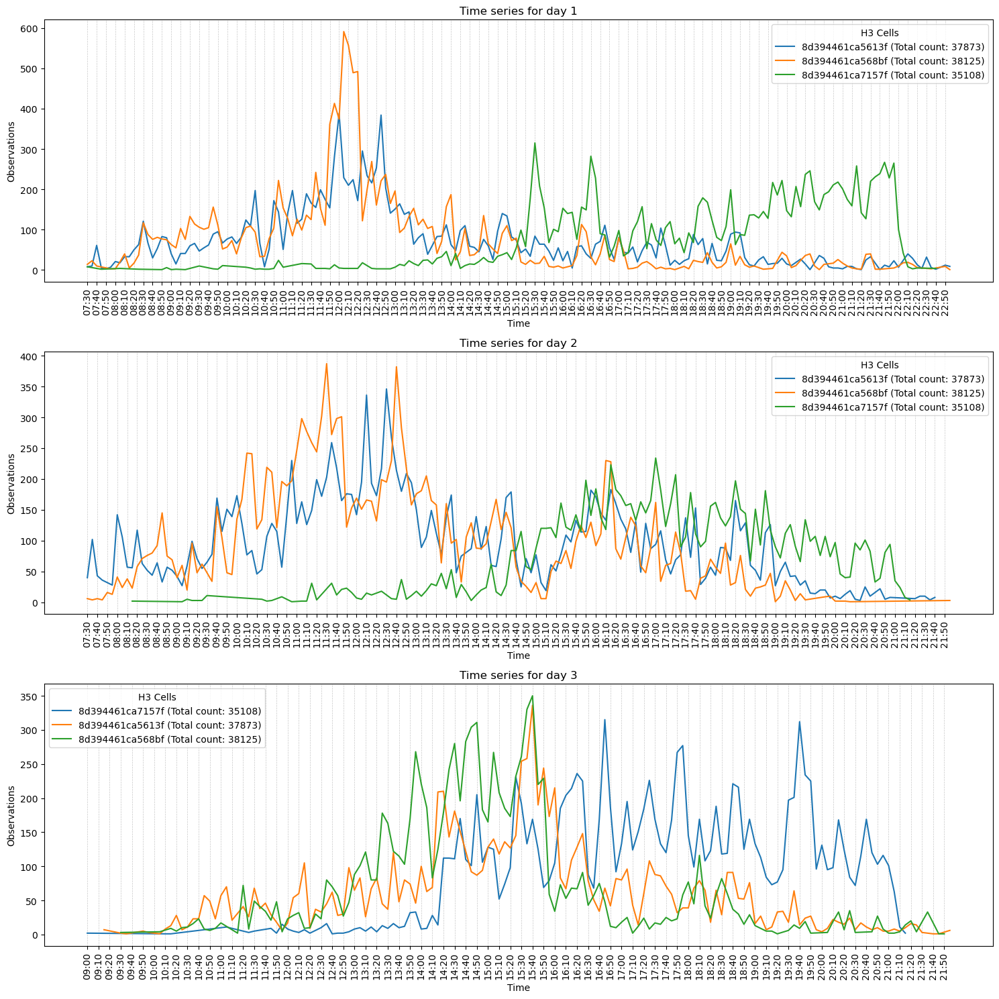

In [259]:
# I execute the code for plotting the time series of the cells after the data cleaning
plot_cells_time_series(sonar_type='day', num_cells=3)

### Exploring by day of the festival

#### Exploring day 1

In [260]:
print('Maximum and minimum timestamps (AP) for day 1:')
duckdb_conn.query("""
                  SELECT TO_TIMESTAMP(min(timestamp_ap)), TO_TIMESTAMP(max(timestamp_ap)) 
                  FROM locations_day_filtered
                  WHERE label_day = 1""")

Maximum and minimum timestamps (AP) for day 1:


┌─────────────────────────────────┬─────────────────────────────────┐
│ to_timestamp(min(timestamp_ap)) │ to_timestamp(max(timestamp_ap)) │
│    timestamp with time zone     │    timestamp with time zone     │
├─────────────────────────────────┼─────────────────────────────────┤
│ 2024-06-13 09:30:01+02          │ 2024-06-14 00:59:56+02          │
└─────────────────────────────────┴─────────────────────────────────┘

In [261]:
print('Number of records for day 1:')
duckdb_conn.query("""SELECT COUNT(*) AS total_records 
                  FROM locations_day_filtered
                  WHERE label_day = 1""")

Number of records for day 1:


┌───────────────┐
│ total_records │
│     int64     │
├───────────────┤
│       1221840 │
└───────────────┘

In [262]:
print('Unique macadresses day 1:')
duckdb_conn.query("""
                  SELECT macaddr_randomized, 
                        COUNT(DISTINCT anonymized_macaddr) AS unique_macadress_count,
                        COUNT(DISTINCT anonymized_macaddr) * 100.0 / (SUM(COUNT(DISTINCT anonymized_macaddr)) OVER ()) AS unique_macadress_percentage
                  FROM locations_day_filtered
                  WHERE label_day = 1
                  GROUP BY macaddr_randomized""")

Unique macadresses day 1:


┌────────────────────┬────────────────────────┬─────────────────────────────┐
│ macaddr_randomized │ unique_macadress_count │ unique_macadress_percentage │
│       int64        │         int64          │           double            │
├────────────────────┼────────────────────────┼─────────────────────────────┤
│                  0 │                    399 │          26.724715338245144 │
│                  1 │                   1094 │           73.27528466175485 │
└────────────────────┴────────────────────────┴─────────────────────────────┘

#### Exploring day 2

In [263]:
print('Maximum and minimum timestamps (AP) for day 2:')
duckdb_conn.query("""SELECT TO_TIMESTAMP(min(timestamp_ap)), TO_TIMESTAMP(max(timestamp_ap)) 
                  FROM locations_day_filtered
                  WHERE label_day = 2""")

Maximum and minimum timestamps (AP) for day 2:


┌─────────────────────────────────┬─────────────────────────────────┐
│ to_timestamp(min(timestamp_ap)) │ to_timestamp(max(timestamp_ap)) │
│    timestamp with time zone     │    timestamp with time zone     │
├─────────────────────────────────┼─────────────────────────────────┤
│ 2024-06-14 09:30:00+02          │ 2024-06-14 23:59:56+02          │
└─────────────────────────────────┴─────────────────────────────────┘

In [264]:
print('Number of records for day 2:')
duckdb_conn.query("""SELECT COUNT(*) AS total_records 
                  FROM locations_day_filtered
                  WHERE label_day = 2""")

Number of records for day 2:


┌───────────────┐
│ total_records │
│     int64     │
├───────────────┤
│       1179590 │
└───────────────┘

In [265]:
print('Unique macadresses day 2:')
duckdb_conn.query("""
                  SELECT macaddr_randomized, 
                        COUNT(DISTINCT anonymized_macaddr) AS unique_macadress_count,
                        COUNT(DISTINCT anonymized_macaddr) * 100.0 / (SUM(COUNT(DISTINCT anonymized_macaddr)) OVER ()) AS unique_macadress_percentage
                  FROM locations_day_filtered
                  WHERE label_day = 2
                  GROUP BY macaddr_randomized""")

Unique macadresses day 2:


┌────────────────────┬────────────────────────┬─────────────────────────────┐
│ macaddr_randomized │ unique_macadress_count │ unique_macadress_percentage │
│       int64        │         int64          │           double            │
├────────────────────┼────────────────────────┼─────────────────────────────┤
│                  0 │                    400 │          24.009603841536613 │
│                  1 │                   1266 │           75.99039615846338 │
└────────────────────┴────────────────────────┴─────────────────────────────┘

#### Exploring day 3

In [266]:
print('Maximum and minimum timestamps (AP) for day 3:')
duckdb_conn.query("""
                  SELECT TO_TIMESTAMP(min(timestamp_ap)), TO_TIMESTAMP(max(timestamp_ap)) 
                  FROM locations_day_filtered
                  WHERE label_day = 3""")

Maximum and minimum timestamps (AP) for day 3:


┌─────────────────────────────────┬─────────────────────────────────┐
│ to_timestamp(min(timestamp_ap)) │ to_timestamp(max(timestamp_ap)) │
│    timestamp with time zone     │    timestamp with time zone     │
├─────────────────────────────────┼─────────────────────────────────┤
│ 2024-06-15 10:00:00+02          │ 2024-06-15 23:59:59+02          │
└─────────────────────────────────┴─────────────────────────────────┘

In [267]:
print('Number of records for day 3:')
duckdb_conn.query("""
                  SELECT COUNT(*) AS total_records 
                  FROM locations_day_filtered
                  WHERE label_day = 3""")

Number of records for day 3:


┌───────────────┐
│ total_records │
│     int64     │
├───────────────┤
│       1054192 │
└───────────────┘

In [268]:
print('Unique macadresses day 3:')
duckdb_conn.query("""
                  SELECT macaddr_randomized, 
                        COUNT(DISTINCT anonymized_macaddr) AS unique_macadress_count,
                        COUNT(DISTINCT anonymized_macaddr) * 100.0 / (SUM(COUNT(DISTINCT anonymized_macaddr)) OVER ()) AS unique_macadress_percentage
                  FROM locations_day_filtered
                  WHERE label_day = 3
                  GROUP BY macaddr_randomized""")

Unique macadresses day 3:


┌────────────────────┬────────────────────────┬─────────────────────────────┐
│ macaddr_randomized │ unique_macadress_count │ unique_macadress_percentage │
│       int64        │         int64          │           double            │
├────────────────────┼────────────────────────┼─────────────────────────────┤
│                  0 │                    320 │          21.665538253215978 │
│                  1 │                   1157 │           78.33446174678402 │
└────────────────────┴────────────────────────┴─────────────────────────────┘

## Comparing Wi-Fi observations vs people counts (filtered) 

Drawing the same plots of the begining, but with the filtered tables.

Comparing unique MAC adresses and observations versus the actual people counts provided by the Sónar. First, I prepare the data for both Sónar by Day and Sónar by Night.

In [314]:
# Getting the observations and users count for each hour from the locations data,
# to compare it with the actual people counts from the Sónar

# Day

observations_hour_day_filtered = duckdb_conn.sql("""SELECT label_day, 
                                                        EXTRACT(HOUR FROM TO_TIMESTAMP(timestamp_ap)) AS Hour,
                                                        macaddr_randomized,
                                                        COUNT(*) AS observations
                                                    FROM locations_day_filtered
                                                    GROUP BY label_day, Hour, macaddr_randomized
                                                    ORDER BY label_day, Hour, macaddr_randomized""").to_df()

users_hour_day_filtered = duckdb_conn.sql("""
                                        SELECT label_day, 
                                                EXTRACT(HOUR FROM TO_TIMESTAMP(timestamp_ap)) AS Hour,
                                                macaddr_randomized,
                                                COUNT(DISTINCT anonymized_macaddr) AS unique_macaddresses
                                            FROM locations_day_filtered
                                            GROUP BY label_day, Hour, macaddr_randomized
                                            ORDER BY label_day, Hour, macaddr_randomized""").to_df()

In [315]:
# Night

observations_hour_night_filtered = duckdb_conn.sql("""SELECT label_night, 
                                                    EXTRACT(HOUR FROM TO_TIMESTAMP(timestamp_ap)) AS Hour,
                                                    macaddr_randomized,
                                                    COUNT(*) AS observations
                                                FROM locations_night_filtered
                                                GROUP BY label_night, Hour, macaddr_randomized
                                                ORDER BY label_night, Hour, macaddr_randomized""").to_df()

users_hour_night_filtered = duckdb_conn.sql("""
                                            SELECT label_night, 
                                                    EXTRACT(HOUR FROM TO_TIMESTAMP(timestamp_ap)) AS Hour,
                                                    macaddr_randomized,
                                                    COUNT(DISTINCT anonymized_macaddr) AS unique_macaddresses
                                                FROM locations_night_filtered
                                                GROUP BY label_night, Hour, macaddr_randomized
                                                ORDER BY label_night, Hour, macaddr_randomized""").to_df()

In [316]:
# Modifying the df resulting from the locations for plotting

# Day
observations_hour_day_filtered['Day'] = observations_hour_day_filtered['label_day'].replace({1:'Thursday',2:'Friday',3:'Saturday'})
users_hour_day_filtered['Day'] = users_hour_day_filtered['label_day'].replace({1:'Thursday',2:'Friday',3:'Saturday'})

# Night
observations_hour_night_filtered['Night'] = observations_hour_night_filtered['label_night'].replace({1:'Friday',2:'Saturday'})
users_hour_night_filtered['Night'] = users_hour_night_filtered['label_night'].replace({1:'Friday',2:'Saturday'})

#### Sónar by day - counts by hour (filtered)

Plotting each variable against the actual people counts.

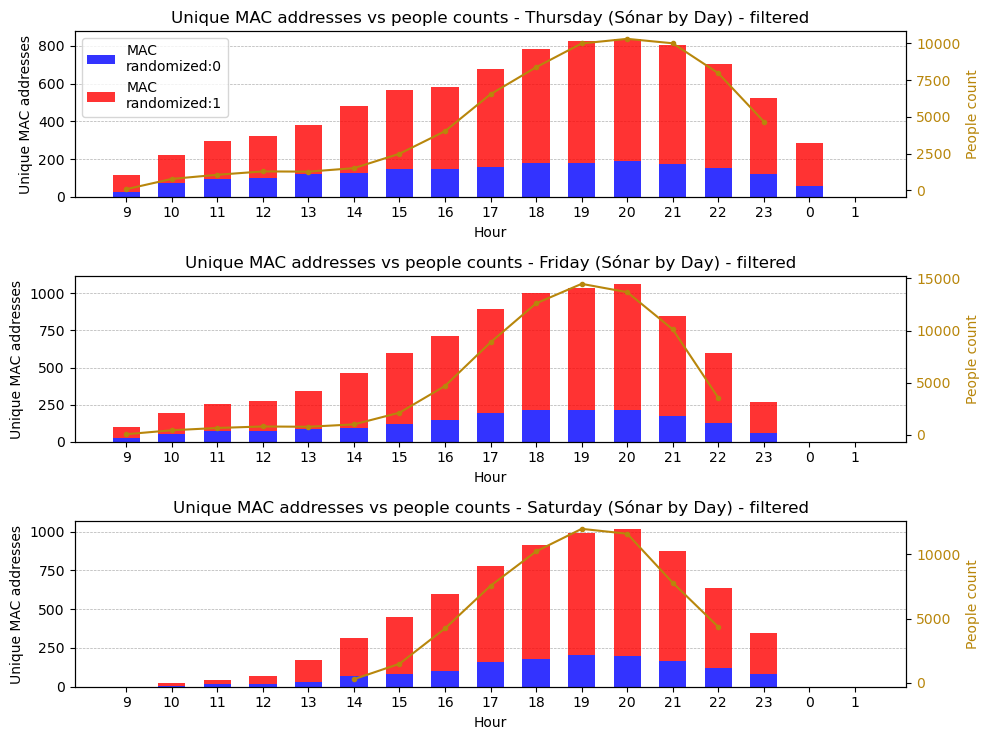

In [317]:
plot_comparison_counts(day_night='Day', variable_to_plot='unique_macaddresses', raw_filtered='filtered')

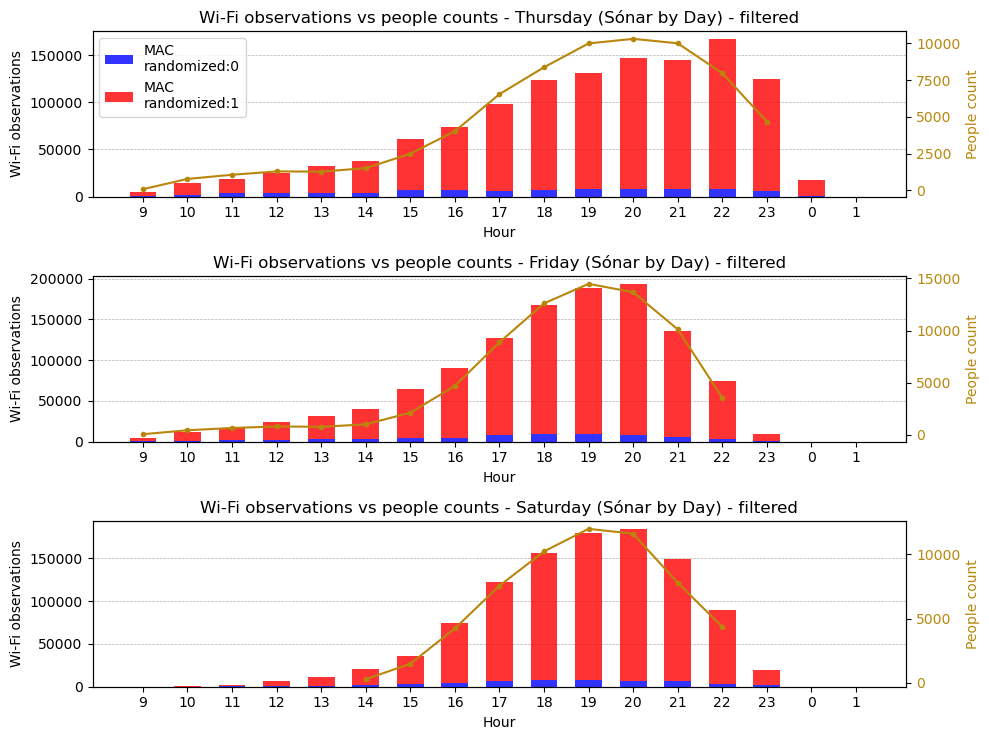

In [318]:
plot_comparison_counts(day_night='Day', variable_to_plot='observations', raw_filtered='filtered')

In [319]:
del observations_hour_day_filtered, users_hour_day_filtered

#### Sónar by night - counts by hour

Comparing unique MAC adresses and observations versus the actual people counts provided by the Sónar.

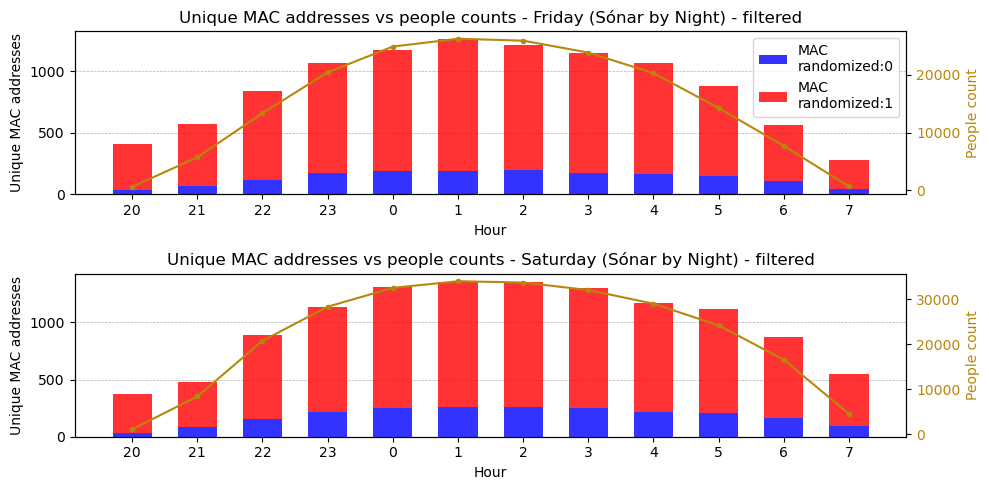

In [320]:
plot_comparison_counts(day_night='Night', variable_to_plot='unique_macaddresses', raw_filtered='filtered')

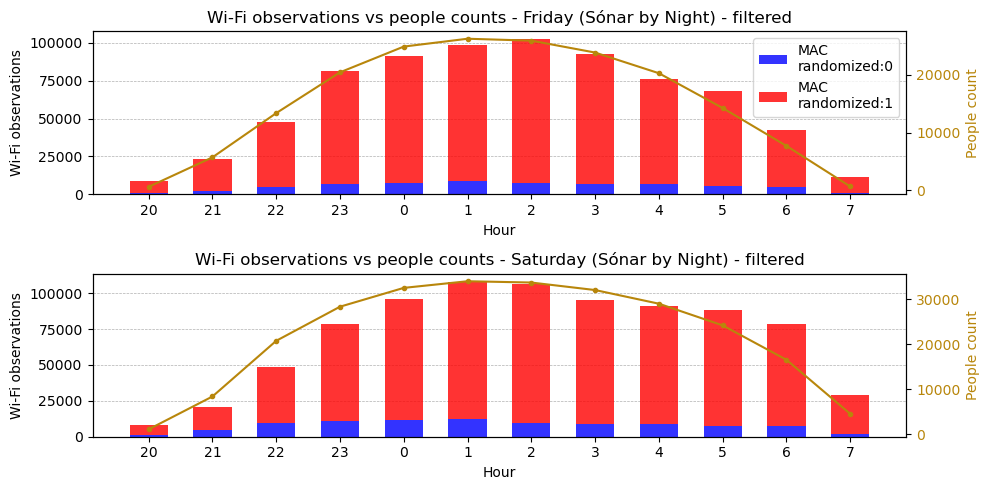

In [321]:
plot_comparison_counts(day_night='Night', variable_to_plot='observations', raw_filtered='filtered')

In [277]:
del observations_hour_night_filtered, users_hour_night_filtered

## Exploring the slug column

Checking the relationship between h3_cell and slug.

Apparently, there are cells that have more than one slug associated to them (and not only in the places where there are multiple floors). This seems to be because sometimes the cells can be part of two different polygons (in the borders).

In [278]:
# Slug and h3 cells for Sónar by night
duckdb_conn.sql("""
                SELECT DISTINCT ln.h3_cell, ln.slug, location_name, num_slugs
                FROM locations_night_filtered ln
                    INNER JOIN 
                        (SELECT h3_cell, COUNT(DISTINCT slug) AS num_slugs
                        FROM locations_night_filtered
                        GROUP BY h3_cell
                        HAVING num_slugs > 1) repeated_cells
                    ON ln.h3_cell = repeated_cells.h3_cell
                --WHERE ln.h3_cell = '8d394461e86eb7f'
                ORDER BY repeated_cells.num_slugs DESC, ln.h3_cell""")

┌─────────────────┬─────────┬────────────────┬───────────┐
│     h3_cell     │  slug   │ location_name  │ num_slugs │
│     varchar     │ varchar │    varchar     │   int64   │
├─────────────────┼─────────┼────────────────┼───────────┤
│ 8d394461e86c43f │ 001C    │ avenia 3 4 DNA │         3 │
│ 8d394461e86c43f │ 002g    │ avenia 3 4 DNA │         3 │
│ 8d394461e86c43f │ 001D    │ avenia 3 4 DNA │         3 │
│ 8d394461e86c5bf │ 001C    │ avenia 3 4 DNA │         3 │
│ 8d394461e86c5bf │ 002g    │ avenia 3 4 DNA │         3 │
│ 8d394461e86c5bf │ 001D    │ avenia 3 4 DNA │         3 │
│ 8d394461e84117f │ 001y    │ Ground Floor   │         2 │
│ 8d394461e84117f │ 001C    │ avenia 3 4 DNA │         2 │
│ 8d394461e8418ff │ 001y    │ Ground Floor   │         2 │
│ 8d394461e8418ff │ 001C    │ avenia 3 4 DNA │         2 │
│        ·        │  ·      │      ·         │         · │
│        ·        │  ·      │      ·         │         · │
│        ·        │  ·      │      ·         │         ·

In [279]:
# Slug and h3 cells for Sónar by day
duckdb_conn.sql("""
                SELECT DISTINCT ln.h3_cell, ln.slug, location_name, num_slugs
                FROM locations_day_filtered ln
                    INNER JOIN 
                        (SELECT h3_cell, COUNT(DISTINCT slug) AS num_slugs
                        FROM locations_day_filtered
                        GROUP BY h3_cell
                        HAVING num_slugs > 1) repeated_cells
                    ON ln.h3_cell = repeated_cells.h3_cell
                WHERE location_name NOT IN ('Exhibition Level 0','Nivel 1','Nivel 2')
                ORDER BY repeated_cells.num_slugs DESC, ln.h3_cell""")

┌─────────────────┬─────────┬───────────────┬───────────┐
│     h3_cell     │  slug   │ location_name │ num_slugs │
│     varchar     │ varchar │    varchar    │   int64   │
├─────────────────┼─────────┼───────────────┼───────────┤
│ 8d394461ca430bf │ 001M    │ Ground Floor  │         2 │
│ 8d394461ca430bf │ 001K    │ Ground Floor  │         2 │
│ 8d394461ca4357f │ 001K    │ Ground Floor  │         2 │
│ 8d394461ca4357f │ 001M    │ Ground Floor  │         2 │
│ 8d394461ca4517f │ 001K    │ Ground Floor  │         2 │
│ 8d394461ca4517f │ 001L    │ Ground Floor  │         2 │
│ 8d394461ca4583f │ 001L    │ Ground Floor  │         2 │
│ 8d394461ca4583f │ 001K    │ Ground Floor  │         2 │
│ 8d394461ca458ff │ 001L    │ Ground Floor  │         2 │
│ 8d394461ca458ff │ 001K    │ Ground Floor  │         2 │
│        ·        │  ·      │      ·        │         · │
│        ·        │  ·      │      ·        │         · │
│        ·        │  ·      │      ·        │         · │
│ 8d394461ca74

Reading the file that contains the association between slug and polygon to make a query.

In [280]:
slug_to_polygon = pd.read_csv(os.path.join(path_read, r'Processed\Zonas SONAR clipped\slug_to_polygon_processed.csv'))
slug_to_polygon

,slug,polygon_name,parent__name,stage
0,001I,SONAR DIA - SonarPark,SONAR 2024 - DIA,SonarPark
1,001X,SONAR DIA - SonarPark Barra,SONAR 2024 - DIA,SonarPark
2,001K,SONAR DIA - SonarHall Paso,SONAR 2024 - DIA,NA-sonar_hall_paso
3,001L,SONAR DIA - SonarHall,SONAR 2024 - DIA,SonarHall
4,001M,SONAR DIA - Food Trucks,SONAR 2024 - DIA,NA-food_trucks
5,001N,SONAR DIA - Stage+D,SONAR 2024 - DIA,Stage+D
6,001F,SONAR DIA - SonarVillage,SONAR 2024 - DIA,SonarVillage
7,001G,SONAR DIA - SonarVillage VIP,SONAR 2024 - DIA,SonarVillage
8,001V,SONAR DIA - SonarVillage Barra 2,SONAR 2024 - DIA,SonarVillage
9,001W,SONAR DIA - SonarVillage Barra 1,SONAR 2024 - DIA,SonarVillage


Joining the stage to the locations table

In [281]:
locations_day_filtered_stages = duckdb_conn.sql("""
                                                SELECT ld.*, stp.stage
                                                FROM locations_day_filtered ld
                                                    LEFT JOIN slug_to_polygon stp
                                                        ON ld.slug = stp.slug 
                                                 """)

In [282]:
locations_night_filtered_stages = duckdb_conn.sql("""
                                                SELECT ld.*, stp.stage
                                                FROM locations_night_filtered ld
                                                    LEFT JOIN slug_to_polygon stp
                                                        ON ld.slug = stp.slug 
                                                 """)

In [283]:
locations_day_filtered_stages.columns

['anonymized_macaddr',
 'macaddr_randomized',
 'timestamp_ap',
 'h3_cell',
 'client_latitude',
 'client_longitude',
 'timestamp_wizzie',
 'location_name',
 'slug',
 'rssi',
 'confidence_factor',
 'vendor_name',
 'sonar_type',
 'label_day',
 'observations_user_day',
 'timespan_minutes_day',
 'num_distinct_h3_cells_day',
 'stage']

### Adding the floor number to the Sónar by day table

In [284]:
locations_day_filtered_stages = duckdb_conn.sql("""SELECT *,
                                                        CASE 
                                                            WHEN slug in ('001U','001Y') THEN 1
                                                            WHEN slug in ('001S') THEN 2
                                                            ELSE 0
                                                        END AS floor_num_added
                                                FROM locations_day_filtered_stages
                                                """)

In [285]:
duckdb_conn.sql("""SELECT DISTINCT slug, stage, floor_num_added FROM locations_day_filtered_stages ORDER BY floor_num_added""")

┌─────────┬────────────────────┬─────────────────┐
│  slug   │       stage        │ floor_num_added │
│ varchar │      varchar       │      int32      │
├─────────┼────────────────────┼─────────────────┤
│ 001W    │ SonarVillage       │               0 │
│ 001Z    │ NA-lounge_barra    │               0 │
│ 001K    │ NA-sonar_hall_paso │               0 │
│ 001N    │ Stage+D            │               0 │
│ 001G    │ SonarVillage       │               0 │
│ 001X    │ SonarPark          │               0 │
│ 001L    │ SonarHall          │               0 │
│ 001M    │ NA-food_trucks     │               0 │
│ 001F    │ SonarVillage       │               0 │
│ 001V    │ SonarVillage       │               0 │
│ 001I    │ SonarPark          │               0 │
│ 001P    │ NA-lounge+d        │               0 │
│ 001Q    │ SonarÀgora         │               0 │
│ 001Y    │ Project Area       │               1 │
│ 001U    │ Project Area       │               1 │
│ 001S    │ Complex+D          

## Updating the info_per_user table with the clean tables

### Updated information for Sónar by night

Extracting the new information per user.

In [286]:
info_per_user_night_export_with_stage = duckdb_conn.sql("""
                                                        SELECT vendor_name,
                                                                macaddr_randomized,
                                                                anonymized_macaddr,
                                                                label_night,
                                                                COUNT(*) AS observations_user_night,
                                                                (MAX(timestamp_ap) - MIN(timestamp_ap))/60 AS timespan_minutes_night,
                                                                COUNT(DISTINCT h3_cell) AS num_distinct_h3_cells_night,
                                                                COUNT(DISTINCT stage) AS num_distinct_stage_night
                                                        FROM locations_night_filtered_stages
                                                        GROUP BY vendor_name, macaddr_randomized, anonymized_macaddr, label_night
                                                        ORDER BY label_night, anonymized_macaddr, timespan_minutes_night, observations_user_night""").to_df()

Updating the derived metrics for interpretation and adding the minutes_per_stage column.

In [287]:
info_per_user_night_export_with_stage['observations_per_cell'] = info_per_user_night_export_with_stage['observations_user_night'] / info_per_user_night_export_with_stage['num_distinct_h3_cells_night']
info_per_user_night_export_with_stage['observations_per_minute'] = info_per_user_night_export_with_stage['observations_user_night'] / info_per_user_night_export_with_stage['timespan_minutes_night']
info_per_user_night_export_with_stage['minutes_per_cell'] = info_per_user_night_export_with_stage['timespan_minutes_night'] / info_per_user_night_export_with_stage['num_distinct_h3_cells_night']
info_per_user_night_export_with_stage['minutes_per_stage'] = info_per_user_night_export_with_stage['timespan_minutes_night'] / info_per_user_night_export_with_stage['num_distinct_stage_night']

In [288]:
# Rounding up the other columns to make a lighter output file
info_per_user_night_export_with_stage.loc[:, info_per_user_night_export_with_stage.dtypes == 'float64'] = info_per_user_night_export_with_stage.loc[:, info_per_user_night_export_with_stage.dtypes == 'float64'].round(2)

Checking the quick updated statistical summary.

Note: there are several users with just one stage.

In [289]:
info_per_user_night_export_with_stage.describe()

,macaddr_randomized,label_night,observations_user_night,timespan_minutes_night,num_distinct_h3_cells_night,num_distinct_stage_night,observations_per_cell,observations_per_minute,minutes_per_cell,minutes_per_stage
count,3846.000000,3846.000000,3846.000000,3846.000000,3846.000000,3846.000000,3846.000000,3846.000000,3846.000000,3846.000000
mean,0.852574,1.514041,414.519761,373.033141,53.464639,4.780811,6.365354,1.262093,21.097421,104.745073
std,0.354576,0.499868,492.983427,153.971048,46.454812,2.080451,3.030380,1.401460,30.412418,94.742538
min,0.000000,1.000000,9.000000,71.170000,2.000000,1.000000,1.220000,0.010000,0.980000,12.230000
25%,1.000000,1.000000,63.250000,248.992500,14.000000,3.000000,4.410000,0.170000,3.750000,48.965000
50%,1.000000,2.000000,226.000000,381.445000,40.000000,5.000000,5.580000,0.740000,7.795000,71.070000
75%,1.000000,2.000000,596.000000,494.845000,82.000000,7.000000,7.647500,1.940000,25.970000,123.437500
max,1.000000,2.000000,4990.000000,681.880000,289.000000,9.000000,30.540000,13.510000,269.870000,681.470000


Adding the the information per user to the locations table to keep as reference.

In [290]:
# Selecting only the columns of interest (I only drop the timestamp_wizzie column and the previous info_per_user columns so I can update them)
selected_columns_locations_night = ['anonymized_macaddr', 
                                    'macaddr_randomized', 
                                    'timestamp_ap',
                                    'h3_cell',
                                    'client_latitude',
                                    'client_longitude',
                                    'location_name',
                                    'slug',
                                    'rssi',
                                    'confidence_factor',
                                    'vendor_name',
                                    'sonar_type',
                                    'label_night',
                                    'stage']

# Formatting the columns to embed them in the SQL query
selected_columns_locations_night = ',\n'.join([f'ln.{column}' for column in selected_columns_locations_night])
print(selected_columns_locations_night)

ln.anonymized_macaddr,
ln.macaddr_randomized,
ln.timestamp_ap,
ln.h3_cell,
ln.client_latitude,
ln.client_longitude,
ln.location_name,
ln.slug,
ln.rssi,
ln.confidence_factor,
ln.vendor_name,
ln.sonar_type,
ln.label_night,
ln.stage


In [291]:
# Query to join the information per user to the locations table
locations_night_export = duckdb_conn.sql(f"""
                                           SELECT {selected_columns_locations_night}, 
                                                    iue.observations_user_night, 
                                                    iue.timespan_minutes_night, 
                                                    iue.num_distinct_h3_cells_night,
                                                    iue.num_distinct_stage_night,
                                                    iue.observations_per_cell,
                                                    iue.observations_per_minute,
                                                    iue.minutes_per_cell,
                                                    iue.minutes_per_stage
                                           FROM locations_night_filtered_stages ln
                                            INNER JOIN info_per_user_night_export_with_stage iue 
                                            ON ln.anonymized_macaddr = iue.anonymized_macaddr
                                                AND ln.macaddr_randomized = iue.macaddr_randomized
                                                AND ln.label_night = iue.label_night""")

locations_night_export.columns

['anonymized_macaddr',
 'macaddr_randomized',
 'timestamp_ap',
 'h3_cell',
 'client_latitude',
 'client_longitude',
 'location_name',
 'slug',
 'rssi',
 'confidence_factor',
 'vendor_name',
 'sonar_type',
 'label_night',
 'stage',
 'observations_user_night',
 'timespan_minutes_night',
 'num_distinct_h3_cells_night',
 'num_distinct_stage_night',
 'observations_per_cell',
 'observations_per_minute',
 'minutes_per_cell',
 'minutes_per_stage']

#### Checking the information for users with just one stage - Sónar night

In [292]:
duckdb_conn.sql("""
               SELECT
                    stage,
                    vendor_name,
                    COUNT(DISTINCT anonymized_macaddr) AS num_users_single_stage
               FROM locations_night_export
               WHERE num_distinct_stage_night = 1
               GROUP BY stage, vendor_name
               ORDER BY stage,num_users_single_stage DESC""")

┌────────────────────────┬─────────────────────────────────────┬────────────────────────┐
│         stage          │             vendor_name             │ num_users_single_stage │
│        varchar         │               varchar               │         int64          │
├────────────────────────┼─────────────────────────────────────┼────────────────────────┤
│ NA-Entrada             │ NULL                                │                     17 │
│ NA-Entrada             │ Apple, Inc.                         │                      1 │
│ NA-Entrada             │ HUAWEI TECHNOLOGIES CO.,LTD         │                      1 │
│ NA-Entrada             │ Hewlett Packard Enterprise          │                      1 │
│ NA-Restauración        │ NULL                                │                     27 │
│ NA-Restauración        │ Apple, Inc.                         │                      5 │
│ NA-Restauración        │ Google, Inc.                        │                      1 │
│ NA-Resta

### Updated information for Sónar by day

In [293]:
info_per_user_day_export_with_stage = duckdb_conn.sql("""
                                                        SELECT vendor_name,
                                                                macaddr_randomized,
                                                                anonymized_macaddr,
                                                                label_day,
                                                                COUNT(*) AS observations_user_day,
                                                                (MAX(timestamp_ap) - MIN(timestamp_ap))/60 AS timespan_minutes_day,
                                                                COUNT(DISTINCT h3_cell) AS num_distinct_h3_cells_day,
                                                                COUNT(DISTINCT stage) AS num_distinct_stage_day
                                                        FROM locations_day_filtered_stages
                                                        GROUP BY vendor_name, macaddr_randomized, anonymized_macaddr, label_day
                                                        ORDER BY label_day, anonymized_macaddr, timespan_minutes_day, observations_user_day""").to_df()

In [294]:
info_per_user_day_export_with_stage['observations_per_cell'] = info_per_user_day_export_with_stage['observations_user_day'] / info_per_user_day_export_with_stage['num_distinct_h3_cells_day']
info_per_user_day_export_with_stage['observations_per_minute'] = info_per_user_day_export_with_stage['observations_user_day'] / info_per_user_day_export_with_stage['timespan_minutes_day']
info_per_user_day_export_with_stage['minutes_per_cell'] = info_per_user_day_export_with_stage['timespan_minutes_day'] / info_per_user_day_export_with_stage['num_distinct_h3_cells_day']
info_per_user_day_export_with_stage['minutes_per_stage'] = info_per_user_day_export_with_stage['timespan_minutes_day'] / info_per_user_day_export_with_stage['num_distinct_stage_day']

In [295]:
# Rounding up the other columns to make a lighter output file
info_per_user_day_export_with_stage.loc[:, info_per_user_day_export_with_stage.dtypes == 'float64'] = info_per_user_day_export_with_stage.loc[:, info_per_user_day_export_with_stage.dtypes == 'float64'].round(2)

Checking the quick updated statistical summary.

Note: there are several users with just one stage.

In [296]:
info_per_user_day_export_with_stage.describe()

,macaddr_randomized,label_day,observations_user_day,timespan_minutes_day,num_distinct_h3_cells_day,num_distinct_stage_day,observations_per_cell,observations_per_minute,minutes_per_cell,minutes_per_stage
count,4636.000000,4636.000000,4636.000000,4636.000000,4636.000000,4636.000000,4636.000000,4636.000000,4636.000000,4636.000000
mean,0.758628,1.996549,745.388697,328.861808,57.473684,4.232097,10.116322,2.781042,20.818721,109.029047
std,0.427961,0.800478,1037.989995,185.899471,54.077378,2.309787,6.806377,3.602819,34.137367,109.328858
min,0.000000,1.000000,9.000000,31.020000,2.000000,1.000000,1.560000,0.020000,0.500000,5.490000
25%,1.000000,1.000000,73.000000,177.632500,12.000000,2.000000,5.620000,0.270000,2.750000,41.855000
50%,1.000000,2.000000,303.000000,307.745000,39.000000,4.000000,7.980000,1.135000,7.335000,70.445000
75%,1.000000,3.000000,1013.250000,455.807500,93.000000,6.000000,12.502500,3.972500,23.112500,132.507500
max,1.000000,3.000000,11190.000000,860.730000,295.000000,11.000000,61.950000,27.630000,369.380000,860.100000


In [297]:
# Selecting only the columns of interest (I only drop the timestamp_wizzie column and the previous info_per_user columns so I can update them)
selected_columns_locations_day = ['anonymized_macaddr',
                                  'macaddr_randomized',
                                  'timestamp_ap',
                                  'h3_cell',
                                  'client_latitude',
                                  'client_longitude',
                                  'location_name',
                                  'slug',
                                  'rssi',
                                  'confidence_factor',
                                  'vendor_name',
                                  'sonar_type',
                                  'label_day',
                                  'stage',
                                  'floor_num_added']

# Formatting the columns to embed them in the SQL query
selected_columns_locations_day = ',\n'.join([f'ld.{column}' for column in selected_columns_locations_day])
print(selected_columns_locations_day)

ld.anonymized_macaddr,
ld.macaddr_randomized,
ld.timestamp_ap,
ld.h3_cell,
ld.client_latitude,
ld.client_longitude,
ld.location_name,
ld.slug,
ld.rssi,
ld.confidence_factor,
ld.vendor_name,
ld.sonar_type,
ld.label_day,
ld.stage,
ld.floor_num_added


In [298]:
# Query to join the information per user to the locations table
locations_day_export = duckdb_conn.sql(f"""
                                           SELECT {selected_columns_locations_day}, 
                                                    iue.observations_user_day, 
                                                    iue.timespan_minutes_day, 
                                                    iue.num_distinct_h3_cells_day,
                                                    iue.num_distinct_stage_day,
                                                    iue.observations_per_cell,
                                                    iue.observations_per_minute,
                                                    iue.minutes_per_cell,
                                                    iue.minutes_per_stage
                                           FROM locations_day_filtered_stages ld
                                            INNER JOIN info_per_user_day_export_with_stage iue 
                                            ON ld.anonymized_macaddr = iue.anonymized_macaddr
                                                AND ld.macaddr_randomized = iue.macaddr_randomized
                                                AND ld.label_day = iue.label_day""")

locations_day_export.columns

['anonymized_macaddr',
 'macaddr_randomized',
 'timestamp_ap',
 'h3_cell',
 'client_latitude',
 'client_longitude',
 'location_name',
 'slug',
 'rssi',
 'confidence_factor',
 'vendor_name',
 'sonar_type',
 'label_day',
 'stage',
 'floor_num_added',
 'observations_user_day',
 'timespan_minutes_day',
 'num_distinct_h3_cells_day',
 'num_distinct_stage_day',
 'observations_per_cell',
 'observations_per_minute',
 'minutes_per_cell',
 'minutes_per_stage']

#### Checking the information for users with just one stage - Sónar night

In [299]:
duckdb_conn.sql("""
               SELECT
                    stage,
                    vendor_name,
                    COUNT(DISTINCT anonymized_macaddr) AS num_users_single_stage
               FROM locations_day_export
               WHERE num_distinct_stage_day = 1
               GROUP BY stage, vendor_name
               ORDER BY stage,num_users_single_stage DESC""").to_df()

,stage,vendor_name,num_users_single_stage
0,Complex+D,"Apple, Inc.",4
1,NA-food_trucks,None,7
2,NA-food_trucks,Xiaomi Communications Co Ltd,1
3,NA-food_trucks,"Apple, Inc.",1
4,NA-lounge+d,None,8
5,NA-lounge+d,"Apple, Inc.",4
6,NA-lounge+d,"HUAWEI TECHNOLOGIES CO.,LTD",1
7,NA-lounge+d,SAMSUNG ELECTRO-MECHANICS(THAILAND),1
8,NA-lounge+d,"Samsung Electronics Co.,Ltd",1
9,NA-sonar_hall_paso,None,17


## Exporting the raw "trajectories"

The reduced, split and filtered tables files should represent raw trajectories (before the specific preprocessing for trajectories is performed). Each of them contain the uid (`anonymized_macadress`), the latitude and longitude (`client_latitude`, `client_longitude`), and the datetime (`timestamp_ap`)

### Writing the final table for Sónar by day

In [300]:
locations_day_export.write_csv(os.path.join(path_locations_split_filtered,'wifi_traces_day_filtered.csv'))

### Writing the final table for Sónar by night

In [301]:
locations_night_export.write_csv(os.path.join(path_locations_split_filtered,'wifi_traces_night_filtered.csv'))

### Checking the exported formats and counts for safety

In [302]:
duckdb_conn.sql('SELECT * FROM locations_day_export LIMIT 10')

┌──────────────────────────────────────────────────────────────────┬────────────────────┬──────────────┬─────────────────┬────────────────────┬────────────────────┬────────────────────┬─────────┬────────┬───────────────────┬─────────────────────────────────────┬────────────┬───────────┬──────────────┬─────────────────┬───────────────────────┬──────────────────────┬───────────────────────────┬────────────────────────┬───────────────────────┬─────────────────────────┬──────────────────┬───────────────────┐
│                        anonymized_macaddr                        │ macaddr_randomized │ timestamp_ap │     h3_cell     │  client_latitude   │  client_longitude  │   location_name    │  slug   │  rssi  │ confidence_factor │             vendor_name             │ sonar_type │ label_day │    stage     │ floor_num_added │ observations_user_day │ timespan_minutes_day │ num_distinct_h3_cells_day │ num_distinct_stage_day │ observations_per_cell │ observations_per_minute │ minutes_per_cell │ 

- Sónar by night final counts

In [303]:
print(f'Number of records Sónar by night (exported table):')
display(duckdb_conn.sql("""
                        SELECT macaddr_randomized, COUNT(*) AS total_records
                        FROM locations_night_export
                        GROUP BY macaddr_randomized

                        UNION ALL

                        SELECT 'Total' AS macaddr_randomized, COUNT(*) AS total_records
                        FROM locations_night_export
                        """))


print(f'Unique macadresses Sónar by night (exported table):')
display(duckdb_conn.sql("""
                        SELECT macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                        FROM locations_night_export
                        GROUP BY macaddr_randomized

                        UNION ALL

                        SELECT 'Total' AS macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                        FROM locations_night_export
                        """))

Number of records Sónar by night (exported table):


┌────────────────────┬───────────────┐
│ macaddr_randomized │ total_records │
│      varchar       │     int64     │
├────────────────────┼───────────────┤
│ 1                  │       1438812 │
│ 0                  │        155431 │
│ Total              │       1594243 │
└────────────────────┴───────────────┘

Unique macadresses Sónar by night (exported table):


┌────────────────────┬───────────────────┐
│ macaddr_randomized │ unique_user_count │
│      varchar       │       int64       │
├────────────────────┼───────────────────┤
│ 0                  │               453 │
│ 1                  │              2342 │
│ Total              │              2795 │
└────────────────────┴───────────────────┘

- Sónar by day final counts

In [304]:
print(f'Number of records Sónar by day (exported table):')
display(duckdb_conn.sql("""
                        SELECT macaddr_randomized, COUNT(*) AS total_records
                        FROM locations_day_export
                        GROUP BY macaddr_randomized

                        UNION ALL

                        SELECT 'Total' AS macaddr_randomized, COUNT(*) AS total_records
                        FROM locations_day_export
                        """))


print(f'Unique macadresses Sónar by day (exported table):')
display(duckdb_conn.sql("""
                        SELECT macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                        FROM locations_day_export
                        GROUP BY macaddr_randomized

                        UNION ALL

                        SELECT 'Total' AS macaddr_randomized, COUNT(DISTINCT anonymized_macaddr) AS unique_user_count
                        FROM locations_day_export
                        """))

Number of records Sónar by day (exported table):


┌────────────────────┬───────────────┐
│ macaddr_randomized │ total_records │
│      varchar       │     int64     │
├────────────────────┼───────────────┤
│ 0                  │        203739 │
│ 1                  │       3251883 │
│ Total              │       3455622 │
└────────────────────┴───────────────┘

Unique macadresses Sónar by day (exported table):


┌────────────────────┬───────────────────┐
│ macaddr_randomized │ unique_user_count │
│      varchar       │       int64       │
├────────────────────┼───────────────────┤
│ 1                  │              1985 │
│ 0                  │               769 │
│ Total              │              2754 │
└────────────────────┴───────────────────┘